In [2]:
from urllib.request import urlopen
import pandas as pd
import numpy as np
import json, sys, os
from pymatgen.core.lattice import Lattice
from pymatgen.core.structure import Structure
from pymatgen.core import Composition
import matplotlib.pyplot as plt
import mlcpquicker
import mlcpquick
from tqdm import tqdm
import importlib
import plotly.express as px
import seaborn as sns

import helperfunctions as hf
import reference as ref
import reference2 as ref2

from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier, HistGradientBoostingClassifier,HistGradientBoostingRegressor,GradientBoostingClassifier,GradientBoostingRegressor
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import confusion_matrix,mean_squared_error,mean_absolute_error,ConfusionMatrixDisplay, r2_score, f1_score,roc_curve, roc_auc_score


In [3]:
importlib.reload(mlcpquicker)
importlib.reload(mlcpquick)
importlib.reload(ref)
importlib.reload(hf)
importlib.reload(ref2)

<module 'reference2' from '/Users/aboth/Desktop/gordon/mlcpproject/mlcp code/reference2.py'>

In [4]:
#pandas view settings
pd.set_option('display.max_rows',60)
pd.set_option('display.min_rows',50)
pd.set_option('display.max_columns',None)

In [4]:
#url construction
SERVERAPI="http://aflowlib.duke.edu/search/API/?"
#without conditions, just a comma separated list
SUMMONS="agl_thermal_conductivity_300K(0*),agl_gruneisen,agl_debye,entropic_temperature,nspecies,enthalpy_formation_atom,ael_speed_sound_average,energy_atom,ael_bulk_modulus_vrh,positions_fractional,aflow_prototype_label_relax,geometry,geometry_orig,species,Pearson_symbol_relax,spacegroup_relax,spacegroup_orig,Wyckoff_letters,Wyckoff_letters_orig,Wyckoff_multiplicities,Wyckoff_multiplicities_orig,Wyckoff_site_symmetries,Egap,Egap_fit,Egap_type,aurl,catalog('icsd'),$paging(0)"
response=json.loads(urlopen(SERVERAPI+SUMMONS).read().decode( "utf-8" ))
#a list for each property/data recieved
compounds=[]
auids=[]
aurls=[]
kappa2=[]
positions2=[]
debye=[]
gruneisen=[]
enthalpy_atom=[]
bulk_modulus=[]
energy=[]
speed_sound=[]
prototype=[]
Wletters2=[]
Wmultiplicities2=[]
Wsite_symmetries2=[]
#from 'geometry'
spacegroup=[]
Pearson=[]
species2=[]
geometry2=[]
#original geometry
real_geometry2=[]
real_spacegroup=[]
real_Wletters2=[]
real_Wmultiplicities2=[]
nspecies2=[]
temperature2=[]
Egap2=[]
Egap_fit2=[]
Egap_type=[]

#putting the stuff in
for datum in response:
    compounds.append(datum['compound'])
    auids.append(datum['auid'])
    positions2.append(datum['positions_fractional'])
    debye.append(datum['agl_debye'])
    gruneisen.append(datum['agl_gruneisen'])
    enthalpy_atom.append(datum['enthalpy_formation_atom'])
    bulk_modulus.append(datum['ael_bulk_modulus_vrh'])
    energy.append(datum['energy_atom'])
    speed_sound.append(datum['ael_speed_sound_average'])    
    kappa2.append(datum['agl_thermal_conductivity_300K'])
    prototype.append(datum['aflow_prototype_label_relax'])
    Wletters2.append(datum['Wyckoff_letters'])
    Wmultiplicities2.append(datum['Wyckoff_multiplicities'])
    Wsite_symmetries2.append(datum['Wyckoff_site_symmetries'])
    spacegroup.append(datum['spacegroup_relax'])
    Pearson.append(datum['Pearson_symbol_relax'])
    species2.append(datum['species'])
    nspecies2.append(datum['nspecies'])
    geometry2.append(datum['geometry'])
    aurls.append(datum['aurl'])
    real_geometry2.append(datum['geometry_orig'])
    real_spacegroup.append(datum['spacegroup_orig'])
    real_Wletters2.append(datum['Wyckoff_letters_orig'])
    real_Wmultiplicities2.append(datum['Wyckoff_multiplicities_orig'])
    temperature2.append(datum['entropic_temperature'])
    Egap2.append(datum['Egap'])
    Egap_fit2.append(datum['Egap_fit'])
    Egap_type.append(datum['Egap_type'])

In [5]:
#preprocessing
positions=[]
for i in positions2:
    pel=i.split(';')
    peach=[]
    for j in pel:
        pnum=[]
        for k in j.split(','):
            pnum.append(float(k))
        peach.append(pnum)
    positions.append(peach)
species=[]
for i in species2:
    species.append(i.split(','))
real_geometry=[]
for i in real_geometry2:
    set=[]
    for j in i.split(','):
        set.append(float(j))
    real_geometry.append(set)
geometry=[]
for i in geometry2:
    set=[]
    for j in i.split(','):
        set.append(float(j))
    geometry.append(set)
Wletters=[]
for i in Wletters2:
    pel=i.split(';')
    peach=[]
    for j in pel:
        peach.append(j.split(','))
    Wletters.append(peach)
real_Wletters=[]
for i in real_Wletters2:
    pel=i.split(';')
    peach=[]
    for j in pel:
        peach.append(j.split(','))
    real_Wletters.append(peach)
Wmultiplicities=[]
for i in Wmultiplicities2:
    pel=i.split(';')
    peach=[]
    for j in pel:
        peach.append(j.split(','))
    Wmultiplicities.append(peach)
real_Wmultiplicities=[]
for i in real_Wmultiplicities2:
    pel=i.split(';')
    peach=[]
    for j in pel:
        peach.append(j.split(','))
    real_Wmultiplicities.append(peach)
Wsite_symmetries=[]
for i in Wsite_symmetries2:
    pel=i.split(';')
    peach=[]
    for j in pel:
        peach.append(j.split(','))
    Wsite_symmetries.append(peach)
summult=[]
for i in Wmultiplicities:
    numbsum=0
    for j in i:
        for k in j:
            numbsum+=int(k)
    summult.append(numbsum)
real_summult=[]
for i in real_Wmultiplicities:
    numbsum=0
    for j in i:
        for k in j:
            numbsum+=int(k)
    real_summult.append(numbsum)
ICSD=[]
for i in range(len(aurls)):
    ICSD.append(aurls[i].split('ICSD_')[2])
nspecies=[]
for i in range(len(nspecies2)):
    nspecies.append(int(nspecies2[i]))
temperature=[]
for i in range(len(temperature2)):
    try:
        temperature.append(float(temperature2[i]))
    except:
        temperature.append(-1)
kappa=[]
for i in range(len(kappa2)):
    kappa.append(float(kappa2[i]))
Egap=[]
for i in range(len(Egap2)):
    Egap.append(float(Egap2[i]))
Egap_fit=[]
for i in range(len(Egap_fit2)):
    Egap_fit.append(float(Egap_fit2[i]))
Etype=[]
for i in Egap:
    if i==0:
        Evalue=0
    elif i<0.25:
        Evalue=1
    else:
        Evalue=2
    Etype.append(Evalue)

In [6]:
AFLOWtherm = pd.DataFrame()

In [5]:
AFLOWtherm = pd.read_pickle('AFLOWtherm.pkl')

In [6]:
AFLOWtherm.loc[140]

compound                                                       Ge12Pr1Pt4
real_spacegroup                                                       204
compoundtype                                               Ge12Pr1Pt4_204
ICSD                                                               174554
kappa                                                            0.423097
bulk_modulus                                                      120.802
debye                                                             181.037
gruneisen                                                         2.42571
enthalpy                                                             None
energy                                                            -4.5408
speed_sound                                                        1692.5
positions               [[0.84924098, 0.35312309, 0.20236407], [0.1507...
prototype                                           A12BC4_cI34_204_g_a_c
spacegroup                            

In [7]:
AFLOWtherm.loc[140,'positions']

[[0.84924098, 0.35312309, 0.20236407],
 [0.15075902, 0.35312309, 0.50388211],
 [0.84924098, 0.64687691, 0.49611789],
 [0.15075902, 0.64687691, 0.79763593],
 [0.35312309, 0.50388211, 0.15075902],
 [0.35312309, 0.20236407, 0.84924098],
 [0.64687691, 0.79763593, 0.15075902],
 [0.64687691, 0.49611789, 0.84924098],
 [0.79763593, 0.15075902, 0.64687691],
 [0.49611789, 0.84924098, 0.64687691],
 [0.50388211, 0.15075902, 0.35312309],
 [0.20236407, 0.84924098, 0.35312309],
 [0.0, 0.0, 0.0],
 [0.0, 0.5, 0.0],
 [0.0, 0.0, 0.5],
 [0.5, 0.5, 0.5],
 [0.5, 0.0, 0.0]]

(array([1.000e+00, 2.000e+00, 1.000e+00, 0.000e+00, 8.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 3.065e+03,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        1.216e+03, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 1.285e+03]),
 array([0.125 , 0.2025, 0.28  , 0.3575, 0.435 , 0.5125, 0.59  , 0.6675,
        0.745 , 0.8225, 0.9   , 0.9775, 1.055 , 1.1325, 1.21  , 1.2875,
        1.365 , 1.4425, 1.52  , 1.5975, 1.675 , 1.7525, 1.83  , 1.9075,
        1.985 , 2.0625, 2.14  , 2.2175, 2.295 , 2.3725, 2.45  , 2.5275,
        2.605 , 2.6825, 2.76  , 2.8375, 2.915 , 2.9925, 3.07  , 3.1475,
        3.225 , 

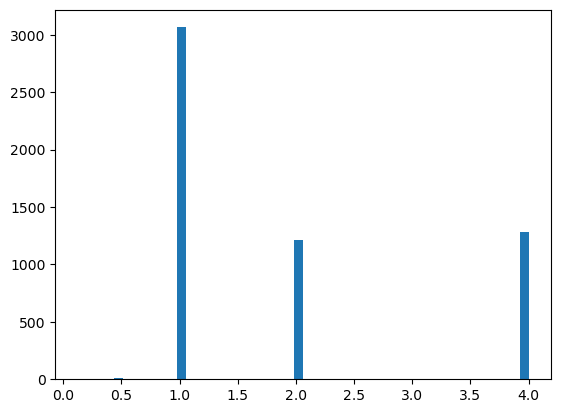

In [8]:
plt.hist(AFLOWtherm['multiplier'],50)

In [351]:
AFLOWtherm.query('real_spacegroup=="204"')

,compound,real_spacegroup,compoundtype,ICSD,kappa,bulk_modulus,debye,gruneisen,enthalpy,energy,speed_sound,positions,prototype,spacegroup,Pearson,geometry,real_geometry,species,nspecies,Wletters,real_Wletters,Wmultiplicities,real_Wmultiplicities,Wsite_symmetries,lenpos,summult,real_summult,real_multiplier,multiplier,temperature,Egap,Egap_fit,Egap_type,Etype,auid,aurl,sites,real_sites,multdif,lettfidd,issues
140,Ge12Pr1Pt4,204,Ge12Pr1Pt4_204,174554,0.423097,120.802,181.037,2.42571,None,-4.5408,1692.5,"[[0.84924098, 0.35312309, 0.20236407], [0.1507...",A12BC4_cI34_204_g_a_c,204,cI34,"[7.5179025, 7.5179025, 7.5179025, 109.47122, 1...","[7.4574314, 7.4574314, 7.4574314, 109.47122, 1...","[Ge, Pr, Pt]",3,"[[g], [a], [c]]","[[g], [a], [c]]","[[24], [2], [8]]","[[24], [2], [8]]","[[m..], [m-3.], [.-3.]]",17,34,34,2.0,2.0,-1.00,0.0000,0.00000,metal,0,aflow:3bc62c3e4e4153c2,aflowlib.duke.edu:AFLOWDATA/ICSD_WEB/BCC/Ge12P...,"[Ge, Ge, Ge, Ge, Ge, Ge, Ge, Ge, Ge, Ge, Ge, G...","[Ge, Ge, Ge, Ge, Ge, Ge, Ge, Ge, Ge, Ge, Ge, G...",False,False,1
213,Ba1Ge12Pt4,204,Ba1Ge12Pt4_204,160797,0.518243,96.3092,189.052,2.35503,None,-4.51984,1669.59,"[[0.0, 0.0, 0.0], [0.15267038, 0.35620715, 0.5...",AB12C4_cI34_204_a_g_c,204,cI34,"[7.5941852, 7.5941852, 7.5941852, 109.47122, 1...","[7.5248081, 7.5248081, 7.5248081, 109.47122, 1...","[Ba, Ge, Pt]",3,"[[a], [g], [c]]","[[a], [g], [c]]","[[2], [24], [8]]","[[2], [24], [8]]","[[m-3.], [m..], [.-3.]]",17,34,34,2.0,2.0,-1.00,0.0000,0.00000,metal,0,aflow:cb1a5c4e541f0235,aflowlib.duke.edu:AFLOWDATA/ICSD_WEB/BCC/Ba1Ge...,"[Ba, Ba, Ge, Ge, Ge, Ge, Ge, Ge, Ge, Ge, Ge, G...","[Ba, Ba, Ge, Ge, Ge, Ge, Ge, Ge, Ge, Ge, Ge, G...",False,False,1
1450,Os4Sb12Sr1,204,Os4Sb12Sr1_204,658734,1.922880,98.78,255.955,2.27556,None,-5.07341,2466.63,"[[0.5, 0.5, 0.5], [0.5, 0.0, 0.0], [-0.0, 0.5,...",A4B12C_cI34_204_c_g_a,204,cI34,"[8.1700446, 8.1700446, 8.1700446, 109.47122, 1...","[8.0730888, 8.0730888, 8.0730888, 109.47122, 1...","[Os, Sb, Sr]",3,"[[c], [g], [a]]","[[c], [g], [a]]","[[8], [24], [2]]","[[8], [24], [2]]","[[.-3.], [m..], [m-3.]]",17,34,34,2.0,2.0,-1.00,0.0000,0.00000,metal,0,aflow:9cbf8200cea159a5,aflowlib.duke.edu:AFLOWDATA/ICSD_WEB/BCC/Os4Sb...,"[Os, Os, Os, Os, Os, Os, Os, Os, Sb, Sb, Sb, S...","[Os, Os, Os, Os, Os, Os, Os, Os, Sb, Sb, Sb, S...",False,False,1
1562,Ru4Sb12Sr1,204,Ru4Sb12Sr1_204,42962,2.033800,91.346,274.997,2.2627,None,-4.70187,2664.01,"[[0.5, 0.5, 0.5], [0.5, 0.0, 0.0], [-0.0, 0.5,...",A4B12C_cI34_204_c_g_a,204,cI34,"[8.1379474, 8.1379474, 8.1379474, 109.47122, 1...","[8.0419119, 8.0419119, 8.0419119, 109.47122, 1...","[Ru, Sb, Sr]",3,"[[c], [g], [a]]","[[c], [g], [a]]","[[8], [24], [2]]","[[8], [24], [2]]","[[.-3.], [m..], [m-3.]]",17,34,34,2.0,2.0,-1.00,0.0000,0.00000,metal,0,aflow:398964731a402aec,aflowlib.duke.edu:AFLOWDATA/ICSD_WEB/BCC/Ru4Sb...,"[Ru, Ru, Ru, Ru, Ru, Ru, Ru, Ru, Sb, Sb, Sb, S...","[Ru, Ru, Ru, Ru, Ru, Ru, Ru, Ru, Sb, Sb, Sb, S...",False,False,1
1627,La1Ru4Sb12,204,La1Ru4Sb12_204,641783,2.113160,95.3876,277.069,2.27052,None,-4.91648,2680.26,"[[-0.0, -0.0, -0.0], [0.0, 0.5, -0.0], [0.5, 0...",AB4C12_cI34_204_a_c_g,204,cI34,"[8.1233428, 8.1233428, 8.1233428, 109.47122, 1...","[8.0280555, 8.0280555, 8.0280555, 109.47122, 1...","[La, Ru, Sb]",3,"[[a], [c], [g]]","[[a], [c], [g]]","[[2], [8], [24]]","[[2], [8], [24]]","[[m-3.], [.-3.], [m..]]",17,34,34,2.0,2.0,-1.00,0.0000,0.00000,metal,0,aflow:dae5c4bc621f28a4,aflowlib.duke.edu:AFLOWDATA/ICSD_WEB/BCC/La1Ru...,"[La, La, Ru, Ru, Ru, Ru, Ru, Ru, Ru, Ru, Sb, S...","[La, La, Ru, Ru, Ru, Ru, Ru, Ru, Ru, Ru, Sb, S...",False,False,1
1740,Rh4Sb12,204,Rh4Sb12_204,650248,2.273700,87.5027,285.094,2.33833,None,-4.50305,2841.33,"[[0.5, -0.0, 0.0], [0.0, 0.5, -0.0], [0.5, 0.5...",AB3_cI32_204_c_g,204,cI32,"[8.1034807, 8.1034807, 8.1034807, 109.47122, 1...","[7.9925485, 7.9925485, 7.9925485, 109.47122, 1...","[Rh, Sb]",2,"[[c], [g]]","[[c], [g]]","[[8], [24]]","[[8], [24]]","[[.-3.], [m..]]",16,32,32,2.0,2.0,-1.00,0.0000,0.00000,metal,0,aflo

In [7]:
#adding to the dataframe
AFLOWtherm['compound']=compounds #numbers add to comp
AFLOWtherm['real_spacegroup']=real_spacegroup
AFLOWtherm['compoundtype']=AFLOWtherm['compound']+'_'+AFLOWtherm['real_spacegroup']
AFLOWtherm['ICSD']=ICSD
AFLOWtherm['kappa']=kappa
AFLOWtherm['bulk_modulus']=bulk_modulus
AFLOWtherm['debye']=debye
AFLOWtherm['gruneisen']=gruneisen
AFLOWtherm['enthalpy']=enthalpy_atom
AFLOWtherm['energy']=energy
AFLOWtherm['speed_sound']=speed_sound
AFLOWtherm['positions']=positions #comp
AFLOWtherm['prototype']=prototype
AFLOWtherm['spacegroup']=spacegroup
AFLOWtherm['Pearson']=Pearson
AFLOWtherm['geometry']=geometry #6
AFLOWtherm['real_geometry']=real_geometry #6
AFLOWtherm['species']=species #elem
AFLOWtherm['nspecies']=nspecies #elem
AFLOWtherm['Wletters']=Wletters #elem
AFLOWtherm['real_Wletters']=real_Wletters #elem?
AFLOWtherm['Wmultiplicities']=Wmultiplicities #elem
AFLOWtherm['real_Wmultiplicities']=real_Wmultiplicities #elem?
AFLOWtherm['Wsite_symmetries']=Wsite_symmetries #elem
AFLOWtherm['lenpos']=[len(a) for a in positions] 
AFLOWtherm['summult']= summult
AFLOWtherm['real_summult']= real_summult
AFLOWtherm['real_multiplier']= AFLOWtherm['real_summult']/AFLOWtherm['lenpos']
AFLOWtherm['multiplier']= AFLOWtherm['summult']/AFLOWtherm['lenpos']
AFLOWtherm['temperature']=temperature
AFLOWtherm['Egap']=Egap
AFLOWtherm['Egap_fit']=Egap_fit
AFLOWtherm['Egap_type']=Egap_type
AFLOWtherm['Etype']=Etype
AFLOWtherm['auid']=auids
AFLOWtherm['aurl']=aurls
sites=[]
for i in range(len(AFLOWtherm['Wmultiplicities'])):
    atomlist=[]
    for y in range(len(AFLOWtherm['Wmultiplicities'][i])):
        for j in AFLOWtherm['Wmultiplicities'][i][y]:
            for k in range(int(j)):
                atomlist.append(AFLOWtherm['species'][i][y])
    sites.append(atomlist)
real_sites=[]
for i in range(len(AFLOWtherm['real_Wmultiplicities'])):
    atomlist=[]
    for y in range(len(AFLOWtherm['real_Wmultiplicities'][i])):
        for j in AFLOWtherm['real_Wmultiplicities'][i][y]:
            for k in range(int(j)):
                atomlist.append(AFLOWtherm['species'][i][y])
    real_sites.append(atomlist)
AFLOWtherm['sites']= sites
AFLOWtherm['real_sites']= real_sites

In [8]:
multicplictydiff=AFLOWtherm['Wmultiplicities']!=AFLOWtherm['real_Wmultiplicities']
lettdiff=AFLOWtherm['Wletters']!=AFLOWtherm['real_Wletters']

In [9]:
AFLOWtherm['multdif']=multicplictydiff
AFLOWtherm['lettfidd']=lettdiff


In [10]:
AFLOWthermONE=AFLOWtherm.query('multiplier==1')
AFLOWthermweird=AFLOWtherm.query('multiplier!=1')

In [11]:
AFLOWthermbinary=AFLOWtherm.query('nspecies<=2') #about half are binary (2647 of 5578)
#AFLOWthermternary=AFLOWtherm.query('nspecies<=3') #nothing is above ternary

In [12]:
#split data by: (1) low element number--maybe just binary, perhaps just ternary
#He, nobles, hydrides, Tc, mlcp elements

In [13]:
print(['0-1',1,2,3,4])
np.bincount(AFLOWtherm['multiplier'])

['0-1', 1, 2, 3, 4]


array([  12, 3065, 1216,    0, 1285])

In [14]:
AFLOWthermduplicate = AFLOWtherm[AFLOWtherm.duplicated(subset=['compound','real_spacegroup'],keep=False)]

In [15]:
#211 duplicates with same compounds and space group, mostly similar kappa though some differences, positions different.
#AFLOWthermduplicate.sort_values(by=['compound'])

In [16]:
len(AFLOWtherm['compound'])-len(np.unique(AFLOWtherm['compound'])) #this many repeats compound-wise

355

In [17]:
geometry_diff=[]
geometry_ratio=[]
length_ratio=[]
angle_ratio=[]
for i in range(len(AFLOWtherm['geometry'])):
    diffs=[]
    for j in range(6):
        if AFLOWtherm['geometry'][i][j]==0 and AFLOWtherm['real_geometry'][i][j]==0:
            diffs.append(1)
        else:
            diffs.append(AFLOWtherm['geometry'][i][j]/AFLOWtherm['real_geometry'][i][j])
    geometry_diff.append(diffs)
    geometry_ratio.append(np.mean(diffs))
    length_ratio.append(np.mean(diffs[:3]))
    angle_ratio.append(np.mean(diffs[3:]))

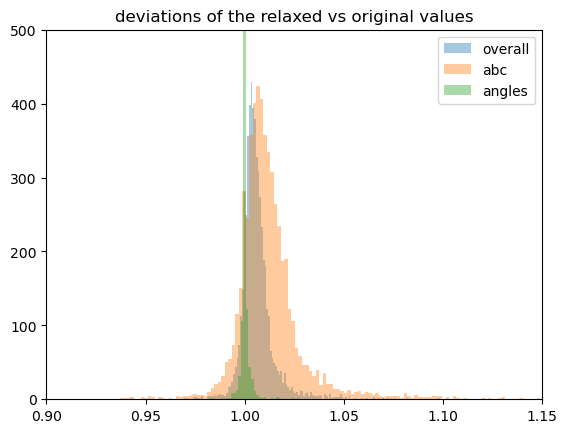

In [18]:
plt.hist(geometry_ratio,bins=1000,alpha=0.4,label='overall')
plt.hist(length_ratio,bins=1000,alpha=0.4,label='abc')
plt.hist(angle_ratio,bins=1000,alpha=0.4,label='angles')
plt.legend()
plt.title('deviations of the relaxed vs original values')
plt.xlim(0.9,1.15)
plt.ylim(0,500)
plt.show()

In [19]:
AFLOWtherm['lettfidd']=lettdiff

In [20]:
#Hg33Rb3cif = Structure.from_file('Hg33Rb3.cif')

In [21]:
geometries={}
for i in range(len(AFLOWtherm)):
    geometries[AFLOWtherm['ICSD'][i]]=Lattice.from_dict({'a':AFLOWtherm['real_geometry'][i][0],
                                           'b':AFLOWtherm['real_geometry'][i][1],
                                           'c':AFLOWtherm['real_geometry'][i][2],
                                           'alpha':AFLOWtherm['real_geometry'][i][3],
                                           'beta':AFLOWtherm['real_geometry'][i][4],
                                           'gamma':AFLOWtherm['real_geometry'][i][5]})




In [22]:
# mlcpaflow={}
# mlcpproblems=[]
# for i in range(len(AFLOWtherm)):
#     try:
#         struct=Structure(geometries[AFLOWtherm['ICSD'][i]], AFLOWtherm['sites'][i], AFLOWtherm['positions'][i])
#         mlcpaflow[AFLOWtherm['compound'][i]+'_'+AFLOWtherm['ICSD'][i]]=mlcpquicker.mlcp(struct,AFLOWtherm['compound'][i]+'_'+AFLOWtherm['ICSD'][i])
#         print(str(i)+AFLOWtherm['compound'][i]+'good')
#         mlcpproblems.append(0)
#     except:
#         mlcpproblems.append(1)
#         print(str(i)+AFLOWtherm['compound'][i]+'error')
#         mlcpaflow[AFLOWtherm['compound'][i]+'_'+AFLOWtherm['ICSD'][i]]=0

In [23]:
mlcpaflow = np.load('mlcpdata2614.npy',allow_pickle='TRUE').item()

In [24]:
mlcpaflowrelax = np.load('mlcpdata2614relaxed.npy',allow_pickle='TRUE').item()

In [25]:
mlcpproblems=[]
for i in mlcpaflow.keys():
    if mlcpaflow[i]==0:
        mlcpproblems.append(1)
    else:
        mlcpproblems.append(0)
AFLOWtherm['issues']=mlcpproblems

In [26]:
len(AFLOWtherm)-sum(mlcpproblems) #these worked

2614

In [27]:
#AFLOWtherm

In [28]:
AFLOWthermmlcp=AFLOWtherm.query('issues==0')

In [29]:
#np.save('mlcpdata2614.npy', mlcpaflow)

In [359]:
geometriesrelaxed[AFLOWtherm['ICSD'][140]]

Lattice
    abc : 7.517902499999999 7.5179025 7.5179025
 angles : 109.47122 109.47122 109.47122
 volume : 327.0906927028721
      A : 7.08794647848336 0.0 -2.505967421508423
      B : -3.543973072735903 6.1383418071631946 -2.505967421508423
      C : 0.0 0.0 7.5179025
    pbc : True True True

In [30]:
geometriesrelaxed={}
for i in range(len(AFLOWtherm)):
    geometriesrelaxed[AFLOWtherm['ICSD'][i]]=Lattice.from_dict({'a':AFLOWtherm['geometry'][i][0],
                                           'b':AFLOWtherm['geometry'][i][1],
                                           'c':AFLOWtherm['geometry'][i][2],
                                           'alpha':AFLOWtherm['geometry'][i][3],
                                           'beta':AFLOWtherm['geometry'][i][4],
                                           'gamma':AFLOWtherm['geometry'][i][5]})



In [31]:
# mlcpaflowrelax={}
# mlcpproblemsrelax=[]
# for i in range(len(AFLOWtherm)):
#     try:
#         struct=Structure(geometriesrelaxed[AFLOWtherm['ICSD'][i]], AFLOWtherm['sites'][i], AFLOWtherm['positions'][i])
#         mlcpaflowrelax[AFLOWtherm['compound'][i]+'_'+AFLOWtherm['ICSD'][i]]=mlcpquicker.mlcp(struct,AFLOWtherm['compound'][i]+'_'+AFLOWtherm['ICSD'][i])
#         print(str(i)+AFLOWtherm['compound'][i]+'good')
#         mlcpproblemsrelax.append(0)
#     except:
#         mlcpproblemsrelax.append(1)
#         print(str(i)+AFLOWtherm['compound'][i]+'error')
#         mlcpaflowrelax[AFLOWtherm['compound'][i]+'_'+AFLOWtherm['ICSD'][i]]=0

In [32]:
#np.save('mlcpdata2614relaxed.npy', mlcpaflowrelax)

In [33]:
#Hg33Rb3=Structure(geometries[str(int(AFLOWtherm[AFLOWtherm['compound']=='Hg33Rb3']['ICSD']))], AFLOWtherm['sites'][1], AFLOWtherm['positions'][1])
#Hg33Rb3cifCP=mlcpquicker.mlcp(Hg33Rb3cif,'Hg33Rb3cif')
#Hg33Rb3CP=mlcpquicker.mlcp(Hg33Rb3,'Hg33Rb3')

In [34]:
mlcpaflowresults={}
mlcpaflowrelaxresults={}
for i,j in zip(AFLOWthermmlcp['compound'],AFLOWthermmlcp['ICSD']):
    mlcpaflowresults[i+'_'+j]=mlcpaflow[i+'_'+j]
    mlcpaflowrelaxresults[i+'_'+j]=mlcpaflowrelax[i+'_'+j]

In [35]:
redform=[]
CPmin=[]
CPminsite=[]
CPminatom=[]
CPminXs=[]
CPminavg=[]

CPmintherm=[]
CPoverall=[]

CPmultmin=[]
CPmultminsum=[]
CPmultminCP=[]
CPmultminsite=[]
CPmultminatom=[]
CPmultminXs=[]

CPminzscore=[]
CPminzscoreCP=[]
CPminzscoresite=[]
CPminzscoreatom=[]
CPminzscoreXs=[]

CPmultminavg=[]

CPmax=[]
CPmultmax=[]
CPmultminsumavg=[]
CPstandev=[]
CPsumavg=[]
CPsum=[]
CPaverage=[]
CPnegpct=[]
CPrange=[]

minXs=[]
maxXs=[]
rangeXs=[]
avgXs=[]
stdevXs=[]

for i,j in zip(AFLOWthermmlcp['compound'],AFLOWthermmlcp['ICSD']):
    struct=mlcpaflowresults[i+'_'+j]
    redform.append(struct['name'])
    minimumCP=min(struct['CP'])
    CPmin.append(minimumCP)
    CPmax.append(max(struct['CP']))
    Xsvalues=[]
    for q in struct['Xs']:
        if q==q:
            Xsvalues.append(q)
        else:
            Xsvalues.append(0)
    CPrange.append(max(struct['CP'])-minimumCP)
    atomindex=struct['CP'].index(minimumCP)
    CPminsite.append(atomindex)
    CPminatom.append(struct['sites'][atomindex])
    CPoverall.append(struct['totalCP'])
    CPmean=np.mean(struct['CP'])
    CPstdev=np.std(struct['CP'])
    CPstandev.append(CPstdev)
    CPsum.append(sum(struct['CP']))
    CPsumavg.append(sum(struct['CP'])/len(struct['CP']))
    CPavg=sum([abs(c) for c in struct['CP']])/len(struct['CP'])
    CPaverage.append(CPavg)
    polarity=[1 if e<0 else 0 for e in struct['CP']]
    CPnegpct.append(sum(polarity)/len(polarity))
    CPminXs.append(Xsvalues[atomindex])
    minmult=[a*b for a, b in zip(Xsvalues, struct['CP'])]    
    minXs.append(min(Xsvalues))
    maxXs.append(max(Xsvalues))
    rangeXs.append(max(Xsvalues)-min(Xsvalues))
    avgXs.append(np.mean(Xsvalues))
    stdevXs.append(np.std(Xsvalues))
    multminCP=min(minmult)
    CPmultmin.append(multminCP)
    CPmultmax.append(max(minmult))
    CPmultminsum.append(sum(minmult))
    CPmultminsumavg.append(sum(minmult)/len(struct['CP']))
    minmultindex=minmult.index(multminCP)
    CPmultminsite.append(minmultindex)
    CPmultminatom.append(struct['sites'][minmultindex])
    CPmultminCP.append(struct['CP'][minmultindex])
    CPmultminXs.append(Xsvalues[minmultindex])
    CPmultminavg.append(multminCP/CPavg)
    CPminavg.append(minimumCP/CPavg)
    if CPstdev==0:
        zscores=[0 for d in struct['CP']]
    else:
        zscores=[(d-CPmean)/CPstdev for d in struct['CP']]
    CPminzscore.append(min(zscores))


In [36]:
# plt.scatter(rCPmin,rCPmax,alpha=0.02);
# plt.xlabel('minimum CP')
# plt.ylabel('maximum CP')
# plt.title('min vs max CP (original)')

In [37]:
AFLOWthermmlcprelax=AFLOWthermmlcp.copy()

In [38]:
rredform=[]
rCPmin=[]
rCPminsite=[]
rCPminatom=[]
rCPminXs=[]
rCPminavg=[]

rCPmintherm=[]
rCPoverall=[]

rCPmultmin=[]
rCPmultminsum=[]
rCPmultminCP=[]
rCPmultminsite=[]
rCPmultminatom=[]
rCPmultminXs=[]

rCPminzscore=[]
rCPminzscoreCP=[]
rCPminzscoresite=[]
rCPminzscoreatom=[]
rCPminzscoreXs=[]

rCPmultminavg=[]

rCPmax=[]
rCPmultmax=[]
rCPmultminsumavg=[]
rCPstandev=[]
rCPsumavg=[]
rCPsum=[]
rCPaverage=[]
rCPnegpct=[]
rCPrange=[]

rminXs=[]
rmaxXs=[]
rrangeXs=[]
ravgXs=[]
rstdevXs=[]

for i,j in zip(AFLOWthermmlcprelax['compound'],AFLOWthermmlcprelax['ICSD']):
    struct=mlcpaflowrelaxresults[i+'_'+j]
    rredform.append(struct['name'])
    rminimumCP=min(struct['CP'])
    rCPmin.append(rminimumCP)
    rCPmax.append(max(struct['CP']))
    rCPrange.append(max(struct['CP'])-rminimumCP)
    ratomindex=struct['CP'].index(rminimumCP)
    rXsvalues=[]
    for q in struct['Xs']:
        if q==q:
            rXsvalues.append(q)
        else:
            rXsvalues.append(0)
    rCPminsite.append(ratomindex)
    rCPminatom.append(struct['sites'][ratomindex])
    rCPoverall.append(struct['totalCP'])
    rCPmean=np.mean(struct['CP'])
    rCPstdev=np.std(struct['CP'])
    rCPstandev.append(rCPstdev)
    rCPsum.append(sum(struct['CP']))
    rCPsumavg.append(sum(struct['CP'])/len(struct['CP']))
    rCPavg=sum([abs(c) for c in struct['CP']])/len(struct['CP'])
    rCPaverage.append(rCPavg)
    rCPminXs.append(rXsvalues[ratomindex])
    rminmult=[a*b for a, b in zip(rXsvalues, struct['CP'])]    
    rmultminCP=min(rminmult)
    rCPmultmin.append(rmultminCP)
    rCPmultminsum.append(sum(rminmult))
    rpolarity=[1 if e<0 else 0 for e in struct['CP']]
    rCPnegpct.append(sum(rpolarity)/len(rpolarity))
    rCPmultmax.append(max(rminmult))
    rminmultindex=rminmult.index(rmultminCP)
    rminXs.append(min(rXsvalues))
    rmaxXs.append(max(rXsvalues))
    rrangeXs.append(max(rXsvalues)-min(rXsvalues))
    ravgXs.append(np.mean(rXsvalues))
    rstdevXs.append(np.std(rXsvalues))
    rCPmultminsumavg.append(sum(rminmult)/len(struct['CP']))
    rCPmultminsite.append(rminmultindex)
    rCPmultminatom.append(struct['sites'][rminmultindex])
    rCPmultminCP.append(struct['CP'][rminmultindex])
    rCPmultminXs.append(rXsvalues[rminmultindex])
    rCPmultminavg.append(rmultminCP/rCPavg)
    rCPminavg.append(rminimumCP/rCPavg)
    if rCPstdev==0:
        rzscores=[0 for d in struct['CP']]
    else:
        rzscores=[(d-rCPmean)/rCPstdev for d in struct['CP']]
    rCPminzscore.append(min(rzscores))

In [39]:
colorbracks=[]
kcolors=[]
kunder=[]

for i in AFLOWthermmlcp['kappa']:
    if i<=1:
        j='under1'
        k=5
        l='under1'
    elif i<=1.5:
        j='under1.5'
        k=4
        l='over1'
    elif i<=2:
        j='under2'
        k=3
        l='over1'
    elif i <=np.median(AFLOWthermmlcp['kappa']):
        j='undermedian'
        k=2
        l='over1'
    elif i<=6:
        j='under6'
        k=1
        l='over1'
    else:
        j='over6'
        k=0
        l='over1'
    colorbracks.append(j)
    kcolors.append(k)
    kunder.append(l)

bias=[]
for i,j in zip(CPmin,CPmax):
    if i*j<0:
        bias.append(0)
    elif i<0:
        bias.append(max(i,j))
    elif i>0:
        bias.append(min(i,j))
    else:
        bias.append(0.01)

rbias=[]
for i,j in zip(rCPmin,rCPmax):
    if i*j<0:
        rbias.append(0)
    elif i<0 and j<0:
        rbias.append(max(i,j))
    elif i>0 and j>0:
        rbias.append(min(i,j))
    else:
        rbias.append(0.01)

In [40]:
AFLOWthermmlcp['reduced']=redform #reduced formula
AFLOWthermmlcp['mincp']=CPmin #lowest CP value
AFLOWthermmlcp['site']=CPminsite #site of the minimum CP value
AFLOWthermmlcp['atom']=CPminatom #atom at site
AFLOWthermmlcp['Xs']=CPminXs #Xs at site
AFLOWthermmlcp['Xs2']=AFLOWthermmlcp['Xs']**2 #Xs at cite squared
AFLOWthermmlcp['mincpavg']=CPminavg

AFLOWthermmlcp['mmincp']=CPmultmin
AFLOWthermmlcp['mmincpcp']=CPmultminCP
AFLOWthermmlcp['mmsite']=CPmultminsite
AFLOWthermmlcp['mmatom']=CPmultminatom
AFLOWthermmlcp['mmXs']=CPmultminXs
AFLOWthermmlcp['CPD']=CPmultminavg
AFLOWthermmlcp['mmincpsum']=CPmultminsum

AFLOWthermmlcp['z']=CPminzscore
#lowestCP['zcp']=CPminzscoreCP
#lowestCP['zsite']=CPminzscoresite
#lowestCP['zatom']=CPminzscoreatom
#lowestCP['zXs']=CPminzscoreXs all identical to minCP ones

AFLOWthermmlcp['rootkappa']=AFLOWthermmlcp['kappa']**0.5
AFLOWthermmlcp['4rootkappa']=AFLOWthermmlcp['kappa']**0.25
AFLOWthermmlcp['ktiers']=kcolors
AFLOWthermmlcp['kclass']=colorbracks
AFLOWthermmlcp['kunder']=kunder
#lowestCP['undermedian']=[1 if a>=np.median(CPmintherm) else 0 for a in CPmintherm]

AFLOWthermmlcp['totalCP']=CPoverall

AFLOWthermmlcp['maxcp']=CPmax
AFLOWthermmlcp['mmaxcp']=CPmultmax
AFLOWthermmlcp['msumavgcp']=CPmultminsumavg
AFLOWthermmlcp['stdevcp']=CPstandev
AFLOWthermmlcp['sumavgcp']=CPsumavg
AFLOWthermmlcp['sumcp']=CPsum
AFLOWthermmlcp['avgcp']=CPaverage
AFLOWthermmlcp['negpctcp']=CPnegpct
AFLOWthermmlcp['rangecp']=CPrange

AFLOWthermmlcp['minXs']=minXs
AFLOWthermmlcp['maxXs']=maxXs
AFLOWthermmlcp['rangeXs']=rangeXs
AFLOWthermmlcp['avgXs']=avgXs
AFLOWthermmlcp['stdevXs']=stdevXs
AFLOWthermmlcp['bias']=bias

In [41]:
AFLOWthermmlcprelax['reduced']=rredform #reduced formula
AFLOWthermmlcprelax['mincp']=rCPmin #lowest CP value
AFLOWthermmlcprelax['site']=rCPminsite #site of the minimum CP value
AFLOWthermmlcprelax['atom']=rCPminatom #atom at site
AFLOWthermmlcprelax['Xs']=rCPminXs #Xs at site
AFLOWthermmlcprelax['Xs2']=AFLOWthermmlcprelax['Xs']**2 #Xs at cite squared
AFLOWthermmlcprelax['mincpavg']=rCPminavg

AFLOWthermmlcprelax['mmincp']=rCPmultmin
AFLOWthermmlcprelax['mmincpcp']=rCPmultminCP
AFLOWthermmlcprelax['mmsite']=rCPmultminsite
AFLOWthermmlcprelax['mmatom']=rCPmultminatom
AFLOWthermmlcprelax['mmXs']=rCPmultminXs
AFLOWthermmlcprelax['CPD']=rCPmultminavg
AFLOWthermmlcprelax['mmincpsum']=rCPmultminsum

AFLOWthermmlcprelax['z']=rCPminzscore

AFLOWthermmlcprelax['rootkappa']=AFLOWthermmlcprelax['kappa']**0.5
AFLOWthermmlcprelax['4rootkappa']=AFLOWthermmlcprelax['kappa']**0.25
AFLOWthermmlcprelax['ktiers']=kcolors
AFLOWthermmlcprelax['kclass']=colorbracks
AFLOWthermmlcprelax['kunder']=kunder

AFLOWthermmlcprelax['totalCP']=rCPoverall

AFLOWthermmlcprelax['maxcp']=rCPmax
AFLOWthermmlcprelax['mmaxcp']=rCPmultmax
AFLOWthermmlcprelax['msumavgcp']=rCPmultminsumavg
AFLOWthermmlcprelax['stdevcp']=rCPstandev
AFLOWthermmlcprelax['sumavgcp']=rCPsumavg
AFLOWthermmlcprelax['sumcp']=rCPsum
AFLOWthermmlcprelax['avgcp']=rCPaverage
AFLOWthermmlcprelax['negpctcp']=rCPnegpct
AFLOWthermmlcprelax['rangecp']=rCPrange

AFLOWthermmlcprelax['minXs']=minXs
AFLOWthermmlcprelax['maxXs']=maxXs
AFLOWthermmlcprelax['rangeXs']=rangeXs
AFLOWthermmlcprelax['avgXs']=avgXs
AFLOWthermmlcprelax['stdevXs']=stdevXs
AFLOWthermmlcprelax['bias']=rbias

In [42]:
allformula=[]
allCP=[]
allisCPmin=[]
allsite=[]
allatom=[]
allXs=[]
alltherm=[]

rallformula=[]
rallCP=[]
rallisCPmin=[]
rallsite=[]
rallatom=[]
rallXs=[]
ralltherm=[]


for k in AFLOWthermmlcprelax.index:
    i=AFLOWthermmlcprelax['compound'][k]
    j=AFLOWthermmlcprelax['ICSD'][k]
    rstruct=mlcpaflowrelaxresults[i+'_'+j]
    struct=mlcpaflowresults[i+'_'+j]
    minimumindex=struct['CP'].index(min(struct['CP']))
    for n in range(len(struct['sites'])):
        allformula.append(struct['name'])
        allCP.append(struct['CP'][n])
        if n==minimumindex:
            allisCPmin.append(1)
        else:
            allisCPmin.append(0)
        allsite.append(n)
        allatom.append(struct['sites'][n])
        allXs.append(struct['Xs'][n])
        alltherm.append(AFLOWthermmlcprelax['kappa'][k])


    rminimumindex=rstruct['CP'].index(min(rstruct['CP']))
    for m in range(len(rstruct['sites'])):
        rallformula.append(rstruct['name'])
        rallCP.append(rstruct['CP'][n])
        if m==rminimumindex:
            rallisCPmin.append(1)
        else:
            rallisCPmin.append(0)
        rallsite.append(m)
        rallatom.append(rstruct['sites'][m])
        rallXs.append(rstruct['Xs'][m])
        ralltherm.append(AFLOWthermmlcprelax['kappa'][k])

In [43]:
allatoms = pd.DataFrame()
allatomsrelax = pd.DataFrame()

In [44]:
allatoms['formulas']=allformula
allatoms['cp']=allCP
allatoms['ismin']=allisCPmin
allatoms['site']=allsite
allatoms['atom']=allatom
allatoms['Xs']=allXs
allatoms['kappa']=alltherm
allatoms['Xs2']=allatoms['Xs']**2
allatoms['mult']=allatoms['Xs']*allatoms['cp']
allatoms['rootkappa']=allatoms['kappa']**0.5
allatoms['kunder']=[1 if x<1 else 0 for x in ralltherm]


allatomsrelax['formulas']=rallformula
allatomsrelax['cp']=rallCP
allatomsrelax['ismin']=rallisCPmin
allatomsrelax['site']=rallsite
allatomsrelax['atom']=rallatom
allatomsrelax['Xs']=rallXs
allatomsrelax['kappa']=ralltherm
allatomsrelax['Xs2']=allatomsrelax['Xs']**2
allatomsrelax['mult']=allatomsrelax['Xs']*allatomsrelax['cp']
allatomsrelax['rootkappa']=allatomsrelax['kappa']**0.5
allatomsrelax['kunder']=[1 if x<1 else 0 for x in ralltherm]

In [366]:
forbiddens15=['H','He','F','Ne','Cl','Ar','Br','Kr','I','Xe']
forbiddens1=['Li','Na','K','Rb','Cs'] #can keep
forbiddens16=['O','S','Se','Te']
forbiddens=forbiddens15

In [55]:
wrong_counter=0
mlcpelements=[]
notmlcpelements=[]
for compound in AFLOWthermmlcp.index:
    compositional=Composition(AFLOWthermmlcp.loc[compound,'compound']).element_composition.as_dict().keys()
    if any(i in forbiddens for i in compositional)==True:
        notmlcpelements.append(compound)
        wrong_counter+=1
    else:
        mlcpelements.append(compound)
ATMNE=AFLOWthermmlcp.loc[notmlcpelements]
ATME=AFLOWthermmlcp.loc[mlcpelements]
ATMNER=AFLOWthermmlcprelax.loc[notmlcpelements]
ATMER=AFLOWthermmlcprelax.loc[mlcpelements]
ATMERM=ATMER.query('Etype==0')
ATMEM=ATME.query('Etype==0')
ATMERS=ATMER.query('Etype==1')
ATMES=ATME.query('Etype==1')
ATMERI=ATMER.query('Etype==2')
ATMEI=ATME.query('Etype==2')

In [52]:
AFLOWthermmlcp.columns

Index(['compound', 'real_spacegroup', 'compoundtype', 'ICSD', 'kappa',
       'bulk_modulus', 'debye', 'gruneisen', 'enthalpy', 'energy',
       'speed_sound', 'positions', 'prototype', 'spacegroup', 'Pearson',
       'geometry', 'real_geometry', 'species', 'nspecies', 'Wletters',
       'real_Wletters', 'Wmultiplicities', 'real_Wmultiplicities',
       'Wsite_symmetries', 'lenpos', 'summult', 'real_summult',
       'real_multiplier', 'multiplier', 'temperature', 'Egap', 'Egap_fit',
       'Egap_type', 'Etype', 'auid', 'aurl', 'sites', 'real_sites', 'multdif',
       'lettfidd', 'issues', 'reduced', 'mincp', 'site', 'atom', 'Xs', 'Xs2',
       'mincpavg', 'mmincp', 'mmincpcp', 'mmsite', 'mmatom', 'mmXs', 'CPD',
       'mmincpsum', 'z', 'rootkappa', '4rootkappa', 'ktiers', 'kclass',
       'kunder', 'totalCP', 'maxcp', 'mmaxcp', 'msumavgcp', 'stdevcp',
       'sumavgcp', 'sumcp', 'avgcp', 'negpctcp', 'rangecp', 'minXs', 'maxXs',
       'rangeXs', 'avgXs', 'stdevXs', 'bias'],
      dtype

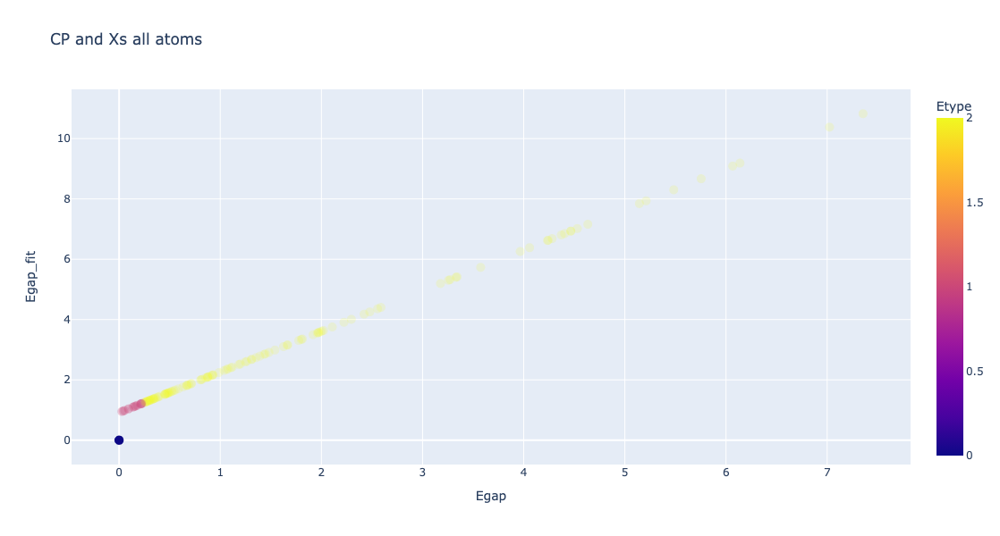

In [54]:
fig = px.scatter(ATME, x="Egap", y="Egap_fit", color="Etype",title="CP and Xs all atoms",
                width=1000, height=600,hover_data=['Xs','kappa'],opacity=0.15)
fig.update_traces(marker_size=10)
fig.show()

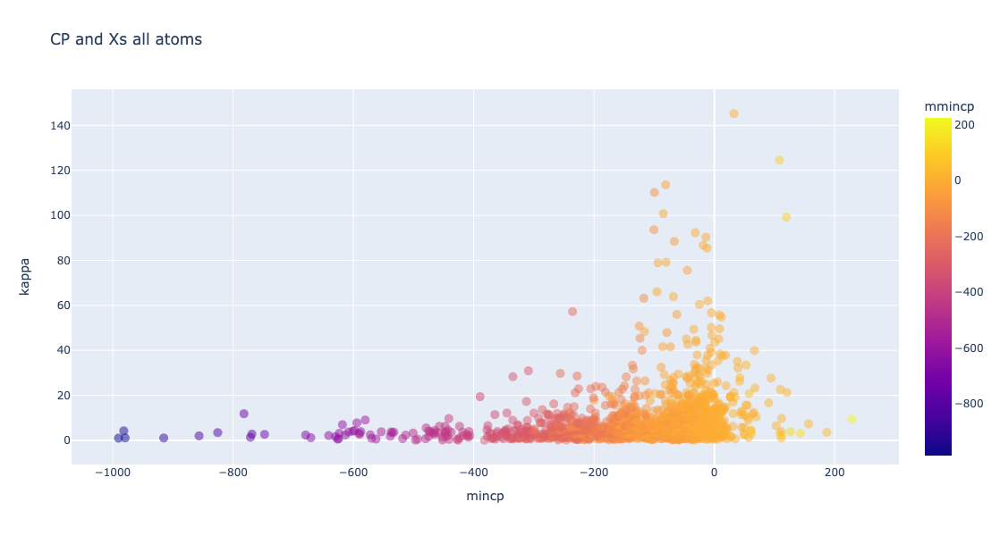

In [69]:
fig = px.scatter(ATMERM, x="mincp", y="kappa", color="mmincp",title="CP and Xs all atoms",
                width=1000, height=600,hover_data=['Xs','kappa','compound','atom'],opacity=0.5)
fig.update_traces(marker_size=10)
fig.show()

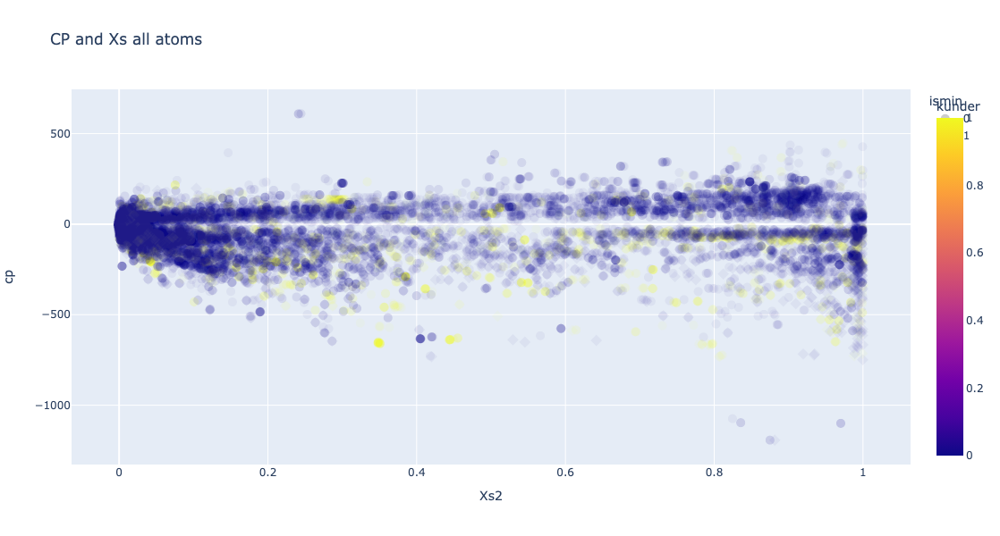

In [61]:
fig = px.scatter(allatoms, x="Xs2", y="cp", color="kunder",symbol="ismin",title="CP and Xs all atoms",
                width=1000, height=600,hover_data=['formulas','atom','site','Xs','kappa'],opacity=0.05)
fig.update_traces(marker_size=10)
fig.show()

Text(0, 0.5, 'count')

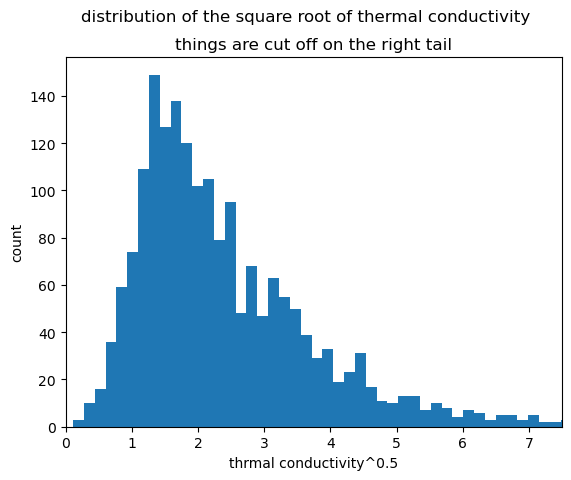

In [62]:
plt.hist(ATME['rootkappa'],bins=100);
plt.title('things are cut off on the right tail')
plt.suptitle('distribution of the square root of thermal conductivity')


plt.xlim(0,7.5)
plt.xlabel('thrmal conductivity^0.5')
plt.ylabel('count')

Text(0, 0.5, 'count')

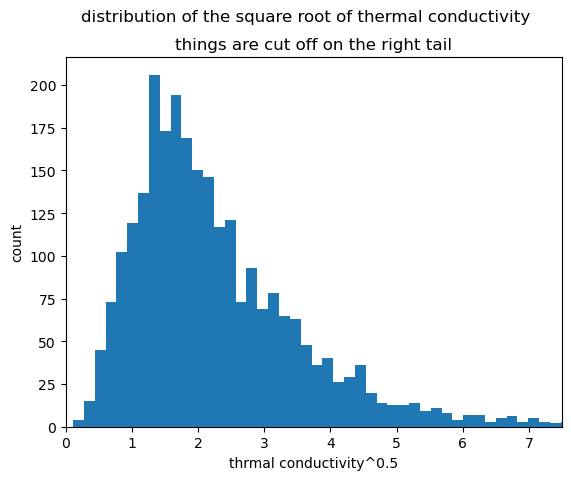

In [21]:
plt.hist(AFLOWthermmlcp['rootkappa'],bins=100);
plt.title('things are cut off on the right tail')
plt.suptitle('distribution of the square root of thermal conductivity')


plt.xlim(0,7.5)
plt.xlabel('thrmal conductivity^0.5')
plt.ylabel('count')

In [10]:
AFLOWthermmlcpnumbers.columns

NameError: name 'AFLOWthermmlcpnumbers' is not defined

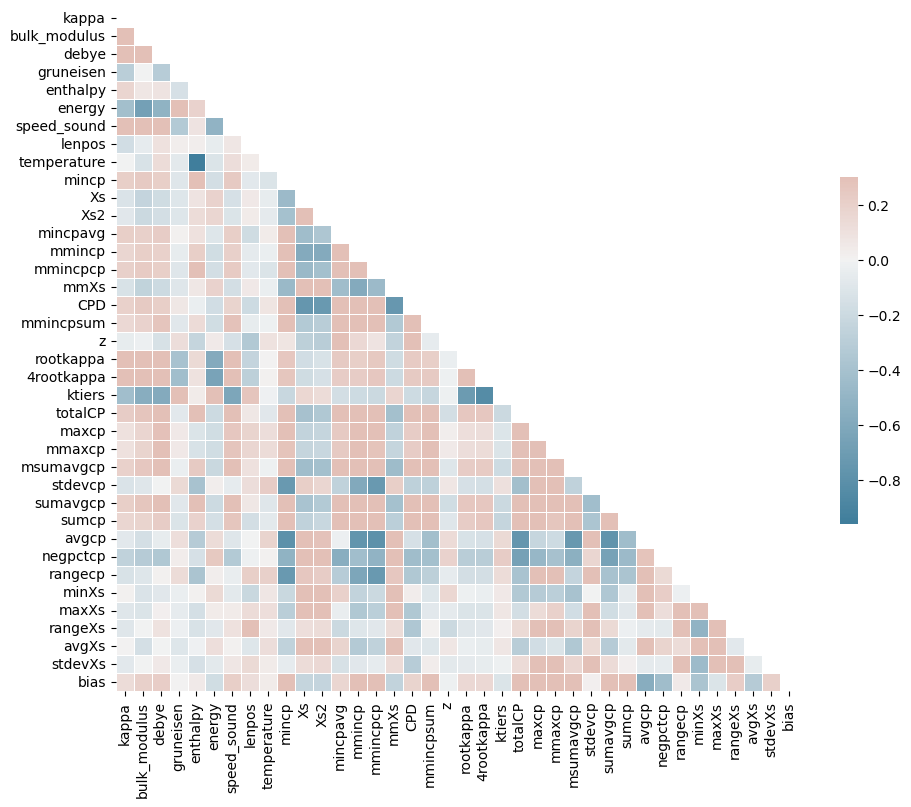

In [22]:
AFLOWthermmlcpnumbers=AFLOWthermmlcp.drop(['compound', 'real_spacegroup', 'compoundtype', 'ICSD','positions', 'prototype', 'spacegroup', 'Pearson',
       'geometry', 'real_geometry', 'species', 'nspecies', 'Wletters',
       'real_Wletters', 'Wmultiplicities', 'real_Wmultiplicities','auid', 'aurl', 'sites',
       'real_sites', 'multdif','kunder',
       'Wsite_symmetries', 'summult', 'real_summult',
       'real_multiplier', 'multiplier','lettfidd', 'issues', 'reduced','site', 'atom','mmsite',
       'mmatom','kclass','bulk_modulus','debye'], axis=1)
corr = AFLOWthermmlcpnumbers.corr(method = 'pearson')
mask = np.triu(np.ones_like(corr, dtype=bool))
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})
# plt.figure(figsize=(10,8), dpi =500)
# sns.heatmap(corr,annot=True,fmt=".2f", linewidth=.5)
plt.show()

Text(0.5, 1.0, 'least extreme value of CP for structures with all + or all - CP')

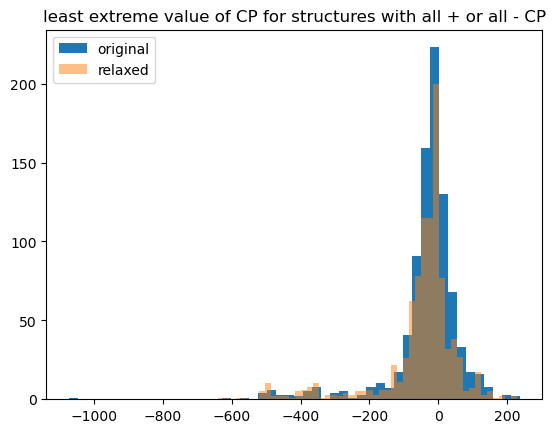

In [322]:
plt.hist([i for i in bias if i != 0],50,label='original');
plt.hist([i for i in rbias if i != 0],50,alpha=0.5,label='relaxed');
plt.legend();
plt.title('least extreme value of CP for structures with all + or all - CP')

In [323]:
AFLOWthermmlcp.columns

Index(['compound', 'real_spacegroup', 'compoundtype', 'ICSD', 'kappa',
       'bulk_modulus', 'debye', 'gruneisen', 'enthalpy', 'energy',
       'speed_sound', 'positions', 'prototype', 'spacegroup', 'Pearson',
       'geometry', 'real_geometry', 'species', 'nspecies', 'Wletters',
       'real_Wletters', 'Wmultiplicities', 'real_Wmultiplicities',
       'Wsite_symmetries', 'lenpos', 'summult', 'real_summult',
       'real_multiplier', 'multiplier', 'temperature', 'auid', 'aurl', 'sites',
       'real_sites', 'multdif', 'lettfidd', 'issues', 'reduced', 'mincp',
       'site', 'atom', 'Xs', 'Xs2', 'mincpavg', 'mmincp', 'mmincpcp', 'mmsite',
       'mmatom', 'mmXs', 'CPD', 'mmincpsum', 'z', 'rootkappa', '4rootkappa',
       'ktiers', 'kclass', 'kunder', 'totalCP', 'maxcp', 'mmaxcp', 'msumavgcp',
       'stdevcp', 'sumavgcp', 'sumcp', 'avgcp', 'negpctcp', 'rangecp', 'minXs',
       'maxXs', 'rangeXs', 'avgXs', 'stdevXs', 'bias'],
      dtype='object')

In [48]:
test_df = AFLOWthermmlcprelax[AFLOWthermmlcprelax['ktiers']>3].copy()

In [49]:
test_df.columns

Index(['compound', 'real_spacegroup', 'compoundtype', 'ICSD', 'kappa',
       'bulk_modulus', 'debye', 'gruneisen', 'enthalpy', 'energy',
       'speed_sound', 'positions', 'prototype', 'spacegroup', 'Pearson',
       'geometry', 'real_geometry', 'species', 'nspecies', 'Wletters',
       'real_Wletters', 'Wmultiplicities', 'real_Wmultiplicities',
       'Wsite_symmetries', 'lenpos', 'summult', 'real_summult',
       'real_multiplier', 'multiplier', 'temperature', 'auid', 'aurl', 'sites',
       'real_sites', 'multdif', 'lettfidd', 'issues', 'reduced', 'mincp',
       'site', 'atom', 'Xs', 'Xs2', 'mincpavg', 'mmincp', 'mmincpcp', 'mmsite',
       'mmatom', 'mmXs', 'CPD', 'mmincpsum', 'z', 'rootkappa', '4rootkappa',
       'ktiers', 'kclass', 'kunder', 'totalCP', 'maxcp', 'mmaxcp', 'msumavgcp',
       'stdevcp', 'sumavgcp', 'sumcp', 'avgcp', 'negpctcp', 'rangecp', 'minXs',
       'maxXs', 'rangeXs', 'avgXs', 'stdevXs', 'bias'],
      dtype='object')

(array([  1.,   0.,   1.,   0.,   1.,   0.,   0.,   0.,   0.,   0.,   1.,
          1.,   1.,   1.,   2.,   2.,   3.,   5.,   5.,   4.,   7.,   2.,
         11.,   6.,  10.,  21.,  25.,  50.,  37.,  68.,  67.,  82., 111.,
        132., 133., 200., 201., 135., 179., 167., 154., 161., 219., 345.,
         25.,   6.,   7.,   7.,   6.,  12.]),
 array([-6.2764512 , -6.13111039, -5.98576958, -5.84042878, -5.69508797,
        -5.54974717, -5.40440636, -5.25906555, -5.11372475, -4.96838394,
        -4.82304313, -4.67770233, -4.53236152, -4.38702071, -4.24167991,
        -4.0963391 , -3.9509983 , -3.80565749, -3.66031668, -3.51497588,
        -3.36963507, -3.22429426, -3.07895346, -2.93361265, -2.78827184,
        -2.64293104, -2.49759023, -2.35224943, -2.20690862, -2.06156781,
        -1.91622701, -1.7708862 , -1.62554539, -1.48020459, -1.33486378,
        -1.18952297, -1.04418217, -0.89884136, -0.75350056, -0.60815975,
        -0.46281894, -0.31747814, -0.17213733, -0.02679652,  0.11854428,
 

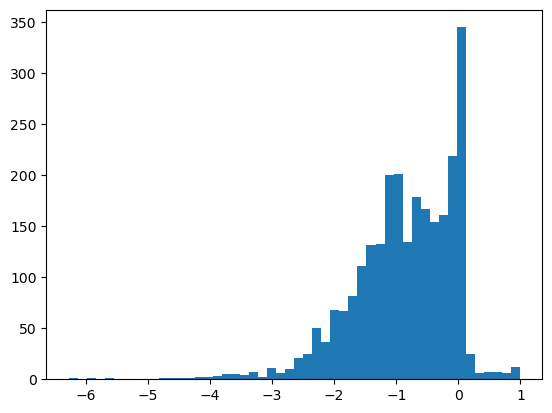

In [54]:
plt.hist(AFLOWthermmlcprelax['CPD'],50)

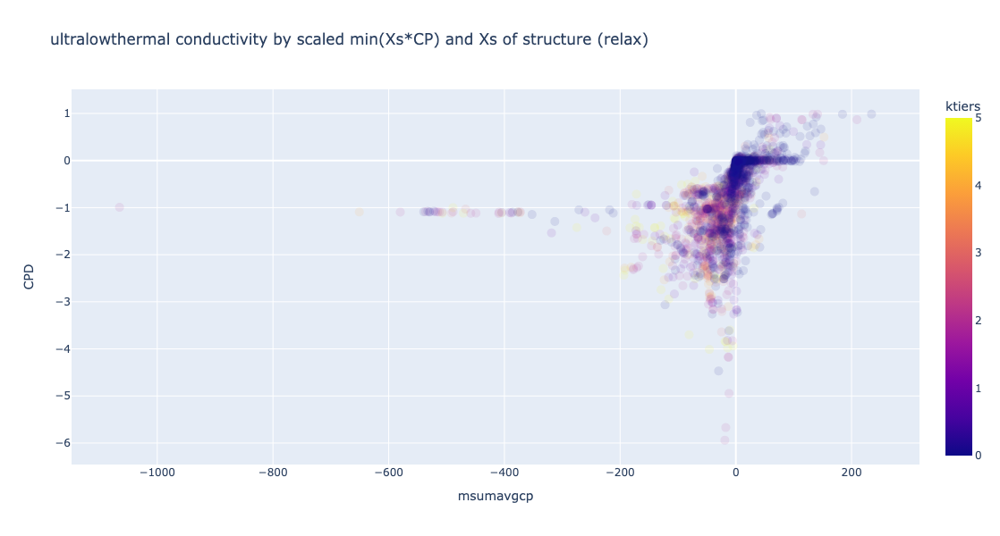

In [63]:
fig = px.scatter(ATME, y="CPD", x="msumavgcp", color="ktiers",title="ultralowthermal conductivity by scaled min(Xs*CP) and Xs of structure (relax)",
                width=1000, height=600,opacity=0.1,hover_data=['atom','site','Xs','mmXs','mmatom','compound','kappa'],log_y=False)
fig.update_traces(marker_size=10)
fig.show()

In [76]:
ATM2=AFLOWthermmlcp.query('nspecies<=2') #1295 of 2614 binary
ATM2R=AFLOWthermmlcprelax.query('nspecies<=2') #1295 of 2614 binary

ATME2=ATME.query('nspecies<=2') #984 of 1790 binary
ATME2R=ATMER.query('nspecies<=2') #984 of 1790 binary

ATMEM2=ATMEM.query('nspecies<=2') #889 of 1646 binary
ATMERM2=ATMERM.query('nspecies<=2') #889 of 1646 binary

ATMES2=ATMES.query('nspecies<=2') #13 of 26 binary
ATMERS2=ATMERS.query('nspecies<=2') #13 of 26 binary

ATMEI2=ATMEI.query('nspecies<=2') #82 of 118 binary
ATMERI2=ATMERI.query('nspecies<=2') #82 of 118 binary


In [171]:
ATMERM2.columns

Index(['compound', 'real_spacegroup', 'compoundtype', 'ICSD', 'kappa',
       'bulk_modulus', 'debye', 'gruneisen', 'enthalpy', 'energy',
       'speed_sound', 'positions', 'prototype', 'spacegroup', 'Pearson',
       'geometry', 'real_geometry', 'species', 'nspecies', 'Wletters',
       'real_Wletters', 'Wmultiplicities', 'real_Wmultiplicities',
       'Wsite_symmetries', 'lenpos', 'summult', 'real_summult',
       'real_multiplier', 'multiplier', 'temperature', 'Egap', 'Egap_fit',
       'Egap_type', 'Etype', 'auid', 'aurl', 'sites', 'real_sites', 'multdif',
       'lettfidd', 'issues', 'reduced', 'mincp', 'site', 'atom', 'Xs', 'Xs2',
       'mincpavg', 'mmincp', 'mmincpcp', 'mmsite', 'mmatom', 'mmXs', 'CPD',
       'mmincpsum', 'z', 'rootkappa', '4rootkappa', 'ktiers', 'kclass',
       'kunder', 'totalCP', 'maxcp', 'mmaxcp', 'msumavgcp', 'stdevcp',
       'sumavgcp', 'sumcp', 'avgcp', 'negpctcp', 'rangecp', 'minXs', 'maxXs',
       'rangeXs', 'avgXs', 'stdevXs', 'bias'],
      dtype

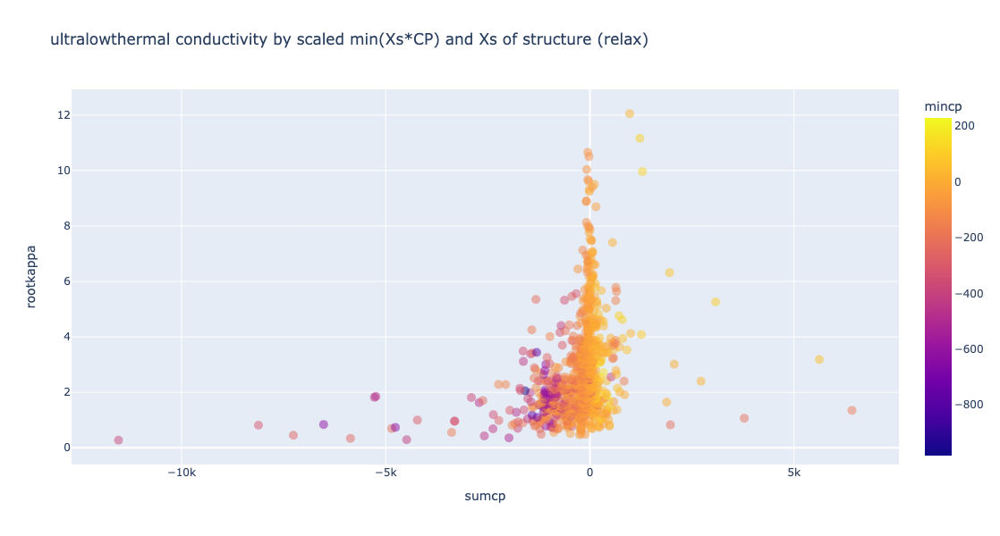

In [391]:
fig = px.scatter(ATMERM2, y="rootkappa", x="sumcp", color="mincp",title="ultralowthermal conductivity by scaled min(Xs*CP) and Xs of structure (relax)",
                width=1000, height=600,opacity=0.5,hover_data=['atom','site','Xs','mmXs','mmatom','compound','kappa'],log_y=False)
fig.update_traces(marker_size=10)
fig.show()

In [377]:
ATMERM2_analysis=ATMERM2.copy()

In [179]:
ATMERM2_analysis.columns

Index(['compound', 'real_spacegroup', 'compoundtype', 'ICSD', 'kappa',
       'bulk_modulus', 'debye', 'gruneisen', 'enthalpy', 'energy',
       'speed_sound', 'positions', 'prototype', 'spacegroup', 'Pearson',
       'geometry', 'real_geometry', 'species', 'nspecies', 'Wletters',
       'real_Wletters', 'Wmultiplicities', 'real_Wmultiplicities',
       'Wsite_symmetries', 'lenpos', 'summult', 'real_summult',
       'real_multiplier', 'multiplier', 'temperature', 'Egap', 'Egap_fit',
       'Egap_type', 'Etype', 'auid', 'aurl', 'sites', 'real_sites', 'multdif',
       'lettfidd', 'issues', 'reduced', 'mincp', 'site', 'atom', 'Xs', 'Xs2',
       'mincpavg', 'mmincp', 'mmincpcp', 'mmsite', 'mmatom', 'mmXs', 'CPD',
       'mmincpsum', 'z', 'rootkappa', '4rootkappa', 'ktiers', 'kclass',
       'kunder', 'totalCP', 'maxcp', 'mmaxcp', 'msumavgcp', 'stdevcp',
       'sumavgcp', 'sumcp', 'avgcp', 'negpctcp', 'rangecp', 'minXs', 'maxXs',
       'rangeXs', 'avgXs', 'stdevXs', 'bias'],
      dtype

In [300]:
CPvariables=['mincp','Xs','mincpavg','mmincp','mmincpcp','mmXs','CPD','mmincpsum','z','totalCP','maxcp','mmaxcp', 'msumavgcp', 'stdevcp',
       'sumavgcp', 'sumcp', 'avgcp', 'negpctcp', 'rangecp', 'minXs', 'maxXs',
       'rangeXs', 'avgXs', 'stdevXs', 'bias']

In [301]:
for i in CPvariables:
    minimum=min(ATMERM2_analysis[i])
    maximum=max(ATMERM2_analysis[i])
    therange=maximum-minimum
    scaledlist=[]
    for j in ATMERM2_analysis[i]:
        value=(j-minimum)/therange
        scaledlist.append(value)
    ATMERM2_analysis[i+'scaled']=scaledlist

In [302]:
ATMERM2scaledsections={}
ATMERM2scaledmeans={}
ATMERM2scaledstdevs={}
ATMERM2scaledcounts={}
valuetierscaled=np.linspace(0.1,1,10)

for j in CPvariables:
    ATMERM2scaledmeans[j]=[]
    ATMERM2scaledstdevs[j]=[]
    ATMERM2scaledcounts[j]=[]

for i in range(len(valuetierscaled)):
    for j in CPvariables:
        ATMERM2scaledsections['under'+j+str(i)]=ATMERM2_analysis.query(f'{valuetierscaled[i-1] if i>0 else 0}<={j}scaled<={valuetierscaled[i]}')
for j in CPvariables:
    for i in range(len(valuetierscaled)):
        ATMERM2scaledmeans[j].append(np.mean(ATMERM2scaledsections['under'+j+str(i)]['kappa'].to_list()))
        ATMERM2scaledstdevs[j].append(np.std(ATMERM2scaledsections['under'+j+str(i)]['kappa'].to_list()))
        ATMERM2scaledcounts[j].append(len(ATMERM2scaledsections['under'+j+str(i)]['kappa']))

In [367]:
ATMERM2pctsections={}
ATMERM2pctthresholds={}
ATMERM2pctmeans={}
ATMERM2pctstdevs={}
valuetierpct=np.linspace(0.1,1,10)

for j in CPvariables:
    ATMERM2pctmeans[j]=[]
    ATMERM2pctstdevs[j]=[]
    ATMERM2pctthresholds[j]=[]

for j in CPvariables:
    for i in valuetierpct:
        ATMERM2pctthresholds[j].append(ATMERM2_analysis[j].quantile(i))
for j in CPvariables:
    for i in range(len(ATMERM2pctthresholds[j])):
        ATMERM2pctsections['under'+j+str(i)]=ATMERM2_analysis.query(f'{ATMERM2pctthresholds[j][i-1] if i>0 else min(ATMERM2_analysis[j])}<={j}<={ATMERM2pctthresholds[j][i]}')
for j in CPvariables:
    for i in range(len(valuetierpct)):
        ATMERM2pctmeans[j].append(np.mean(ATMERM2pctsections['under'+j+str(i)]['kappa'].to_list()))
        ATMERM2pctstdevs[j].append(np.std(ATMERM2pctsections['under'+j+str(i)]['kappa'].to_list()))

In [312]:
ATMERM2threshsections={}
ATMERM2threshthresholds={}
ATMERM2threshmeans={}
ATMERM2threshstdevs={}
valuetierthresh=np.linspace(0.02,1,50)

for j in CPvariables:
    ATMERM2threshmeans[j]=[]
    ATMERM2threshstdevs[j]=[]
    ATMERM2threshthresholds[j]=[]

for j in CPvariables:
    for i in valuetierthresh:
        ATMERM2threshthresholds[j].append(ATMERM2_analysis[j].quantile(i))
for j in CPvariables:
    for i in range(len(ATMERM2threshthresholds[j])):
        ATMERM2threshsections['under'+j+str(i)]=ATMERM2_analysis.query(f'{j}<={ATMERM2threshthresholds[j][i]}')
for j in CPvariables:
    for i in range(len(valuetierthresh)):
        ATMERM2threshmeans[j].append(np.mean(ATMERM2threshsections['under'+j+str(i)]['kappa'].to_list()))
        ATMERM2threshstdevs[j].append(np.std(ATMERM2threshsections['under'+j+str(i)]['kappa'].to_list()))

In [371]:
CP_variable_types={}
CP_variable_types['CPmin']=['mincp','mincpavg','mmincp','mmincpcp','z','CPD']
CP_variable_types['CPmax']=['maxcp','mmaxcp']
CP_variable_types['CPXs']=['Xs','mmXs','minXs', 'maxXs','rangeXs', 'avgXs', 'stdevXs',]
CP_variable_types['CPdistribution']=['negpctcp', 'rangecp',  'bias','stdevcp']
CP_variable_types['CPoverall']=['mmincpsum','totalCP', 'msumavgcp','sumavgcp', 'sumcp', 'avgcp']
CP_variable_types['CPbasic']=['mincp','maxcp','avgcp']
CP_variable_types['ML-CP Values']=['mincp','maxcp','sumcp','maxXs']


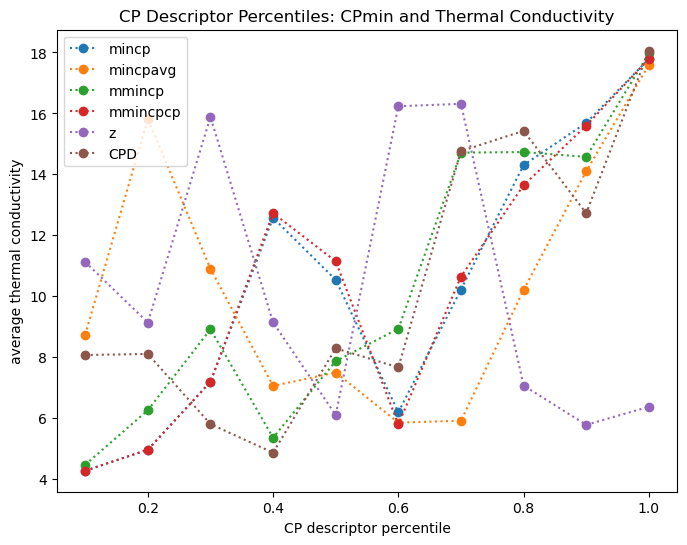

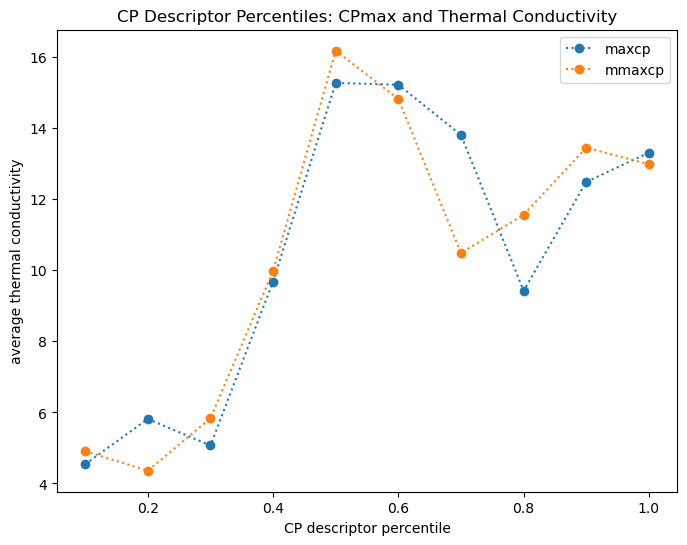

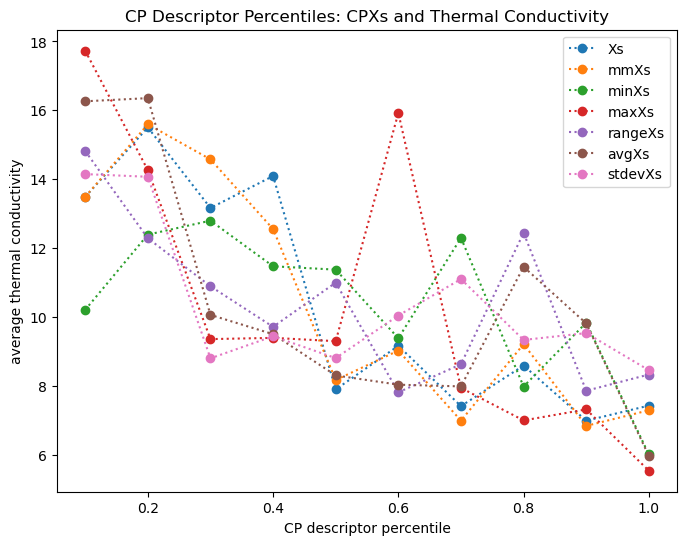

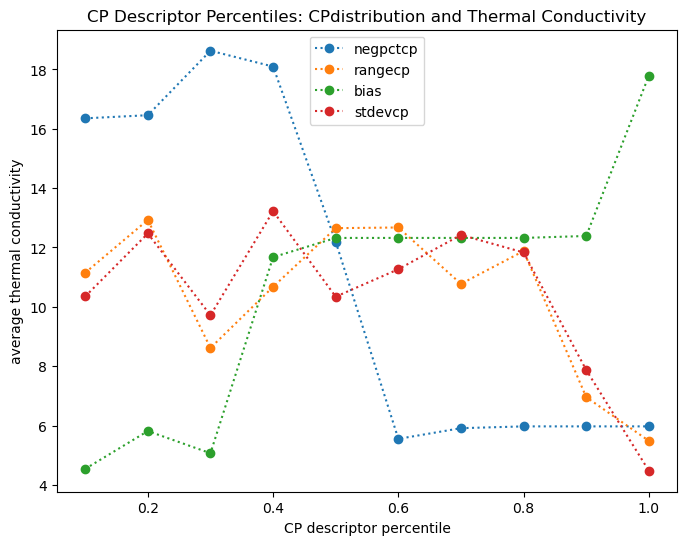

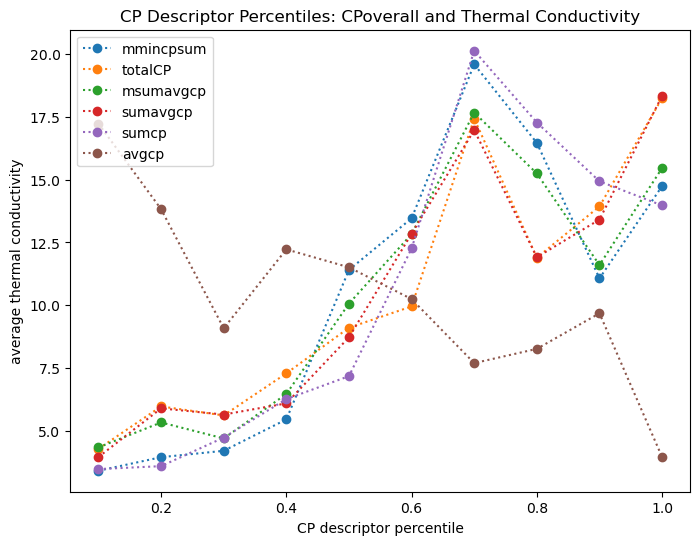

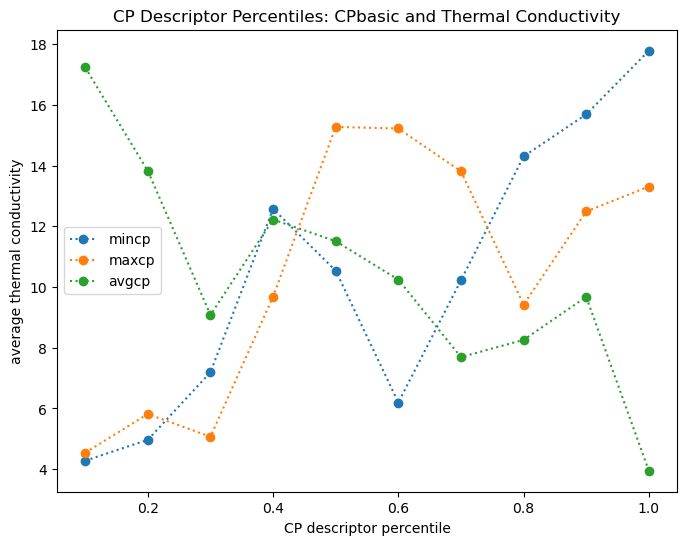

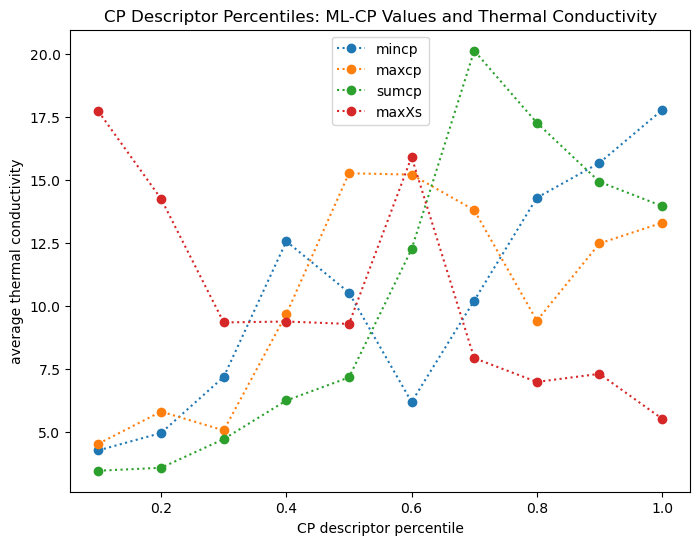

In [372]:
for graphs in CP_variable_types.keys():
    plt.figure(figsize=(8, 6))
    plt.title(f'CP Descriptor Percentiles: {graphs} and Thermal Conductivity')
    for j in CP_variable_types[graphs]:
        plt.plot(valuetierpct,ATMERM2pctmeans[j],'o:',label=j)
        #plt.errorbar(valuetierpct,ATMERM2pctmeans[j],yerr=ATMERM2pctstdevs[j],linestyle='None')
    plt.xlabel('CP descriptor percentile')
    plt.ylabel('average thermal conductivity')
    plt.legend()
    plt.show()

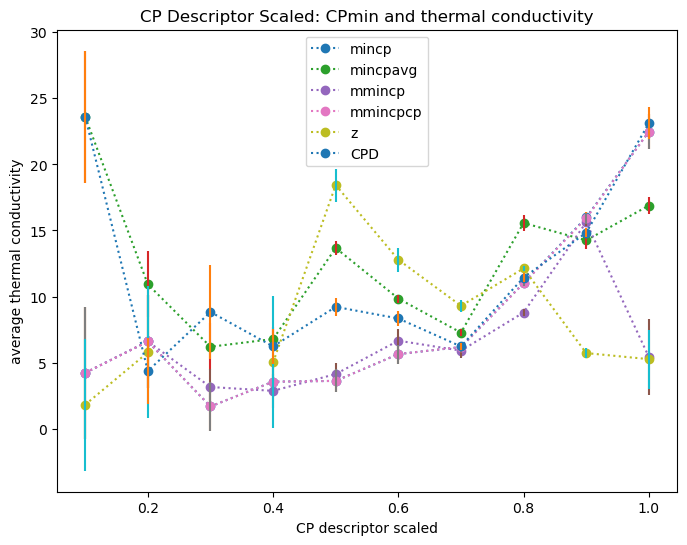

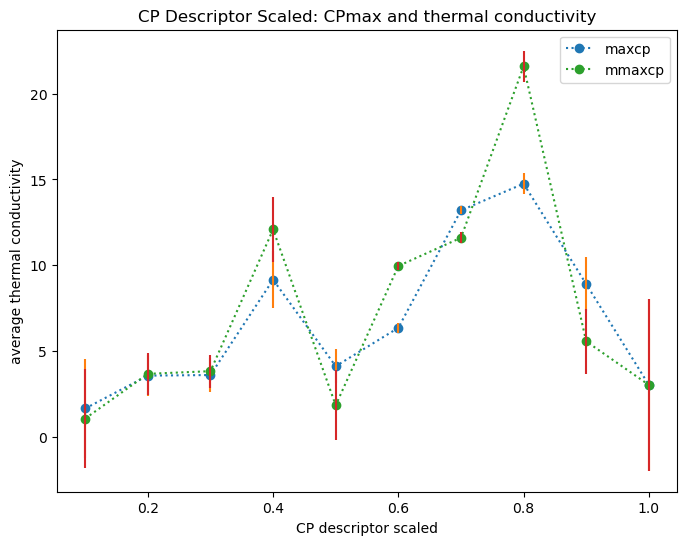

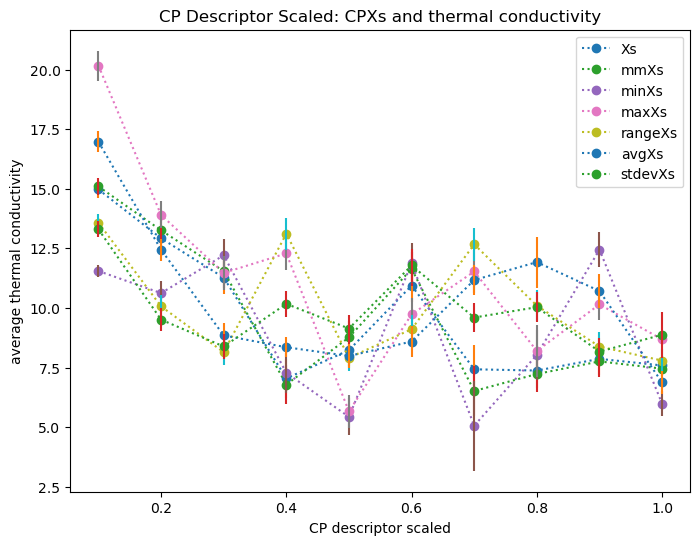

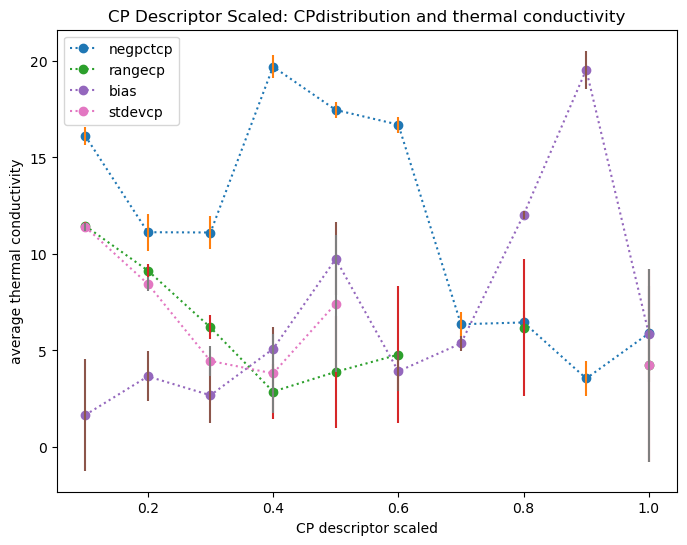

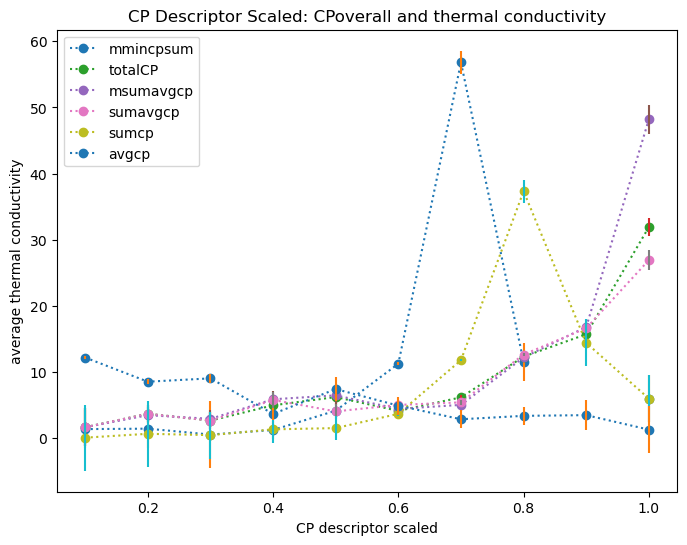

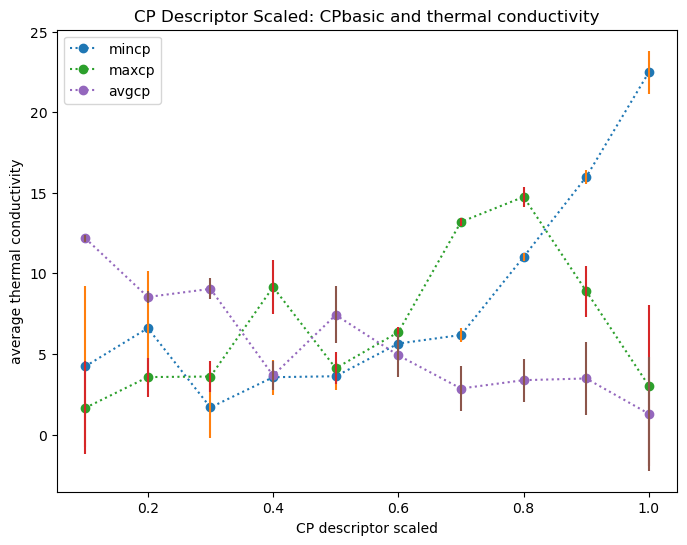

In [306]:
for graphs in CP_variable_types.keys():
    plt.figure(figsize=(8, 6))
    plt.title(f'CP Descriptor Scaled: {graphs} and thermal conductivity')
    for j in CP_variable_types[graphs]:
        plt.plot(valuetierscaled,ATMERM2scaledmeans[j],'o:',label=j)
        #plt.errorbar(valuetierscaled,ATMERM2scaledmeans[j],yerr=ATMERM2scaledstdevs[j],linestyle='None')
        plt.errorbar(valuetierscaled,ATMERM2scaledmeans[j],yerr=[5/a**0.5 if a!=0 else 6 for a in ATMERM2scaledcounts[j]],linestyle='None')
    
    plt.xlabel('CP descriptor scaled')
    plt.ylabel('average thermal conductivity')
    plt.legend()
    plt.show()

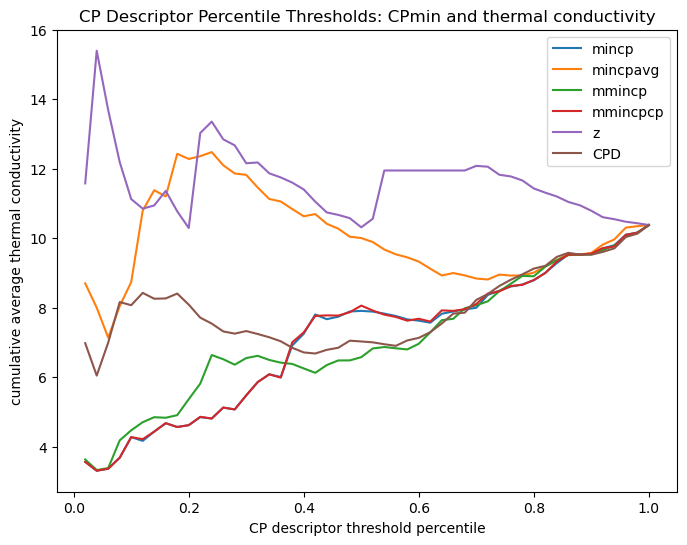

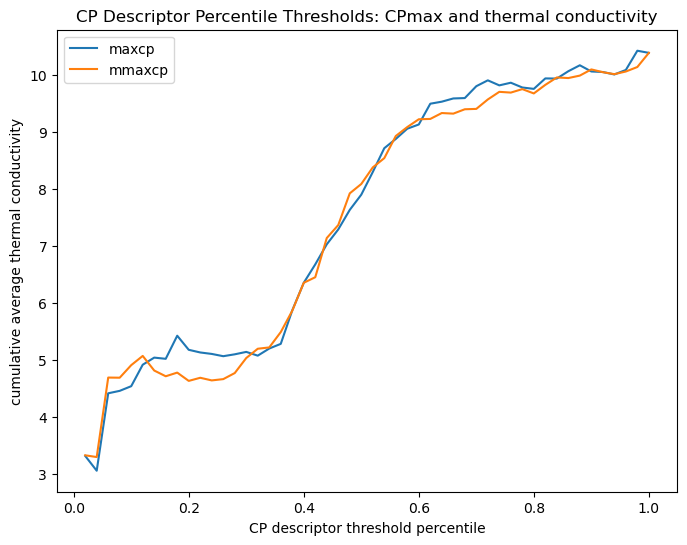

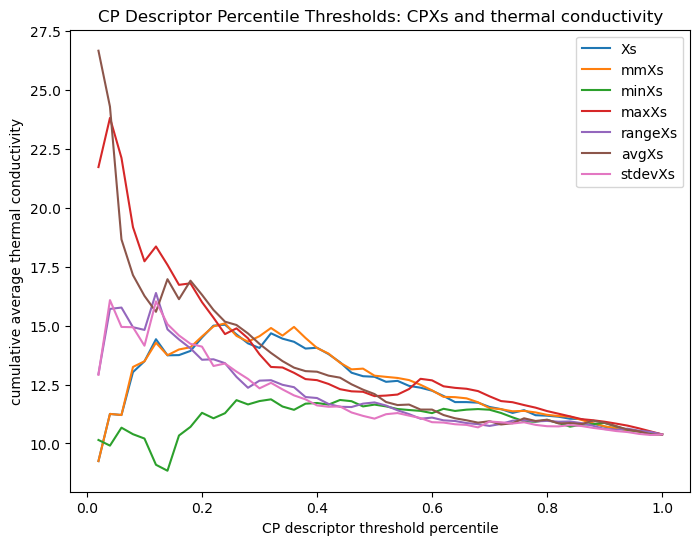

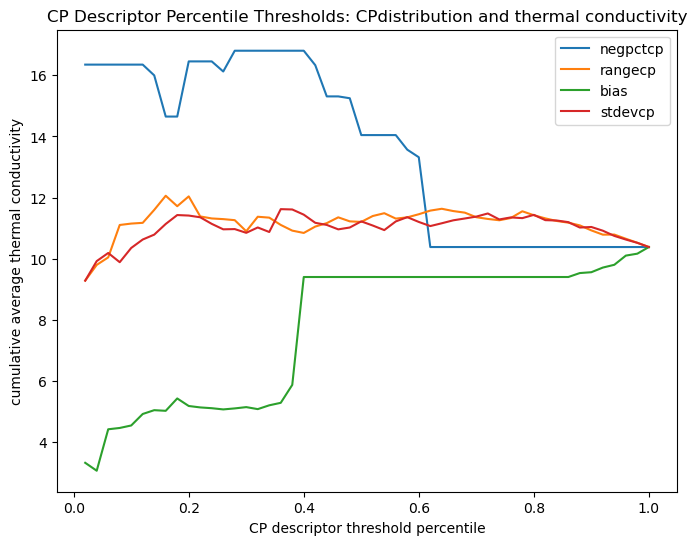

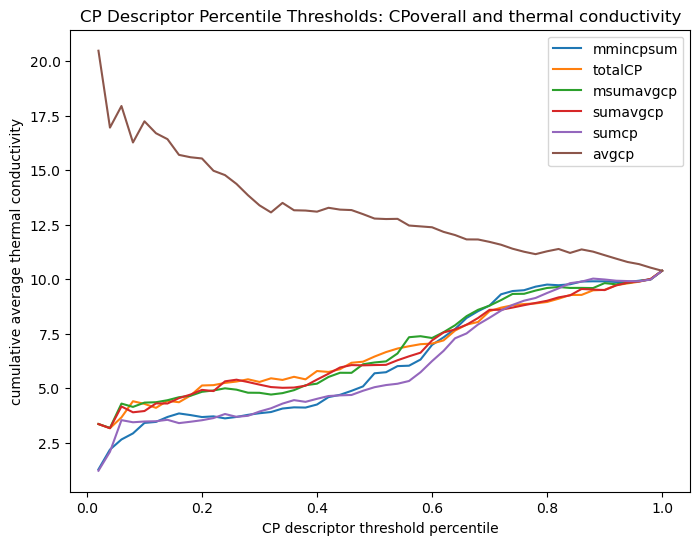

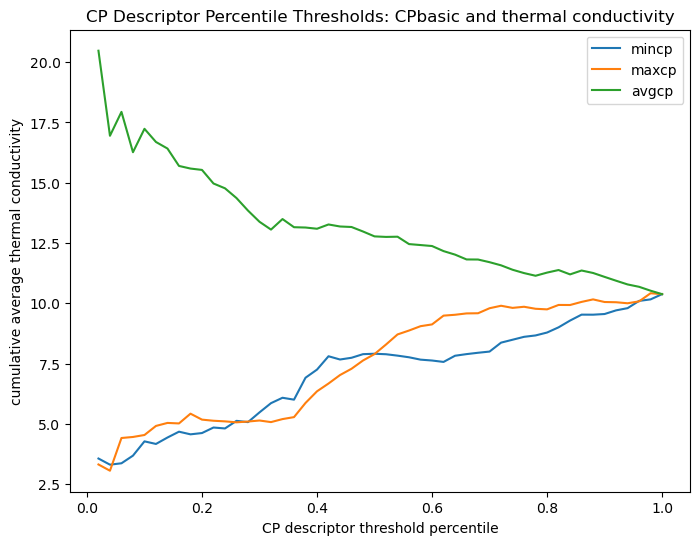

In [314]:
for graphs in CP_variable_types.keys():
    plt.figure(figsize=(8, 6))
    plt.title(f'CP Descriptor Percentile Thresholds: {graphs} and thermal conductivity')
    for j in CP_variable_types[graphs]:
        plt.plot(valuetierthresh,ATMERM2threshmeans[j],label=j)
        #plt.errorbar(valuetierthresh,ATMERM2threshmeans[j],yerr=ATMERM2threshstdevs[j],linestyle='None')    
    plt.xlabel('CP descriptor threshold percentile')
    plt.ylabel('cumulative average thermal conductivity')
    plt.legend()
    plt.show()

In [179]:
ATMERM2_analysis.columns

Index(['compound', 'real_spacegroup', 'compoundtype', 'ICSD', 'kappa',
       'bulk_modulus', 'debye', 'gruneisen', 'enthalpy', 'energy',
       'speed_sound', 'positions', 'prototype', 'spacegroup', 'Pearson',
       'geometry', 'real_geometry', 'species', 'nspecies', 'Wletters',
       'real_Wletters', 'Wmultiplicities', 'real_Wmultiplicities',
       'Wsite_symmetries', 'lenpos', 'summult', 'real_summult',
       'real_multiplier', 'multiplier', 'temperature', 'Egap', 'Egap_fit',
       'Egap_type', 'Etype', 'auid', 'aurl', 'sites', 'real_sites', 'multdif',
       'lettfidd', 'issues', 'reduced', 'mincp', 'site', 'atom', 'Xs', 'Xs2',
       'mincpavg', 'mmincp', 'mmincpcp', 'mmsite', 'mmatom', 'mmXs', 'CPD',
       'mmincpsum', 'z', 'rootkappa', '4rootkappa', 'ktiers', 'kclass',
       'kunder', 'totalCP', 'maxcp', 'mmaxcp', 'msumavgcp', 'stdevcp',
       'sumavgcp', 'sumcp', 'avgcp', 'negpctcp', 'rangecp', 'minXs', 'maxXs',
       'rangeXs', 'avgXs', 'stdevXs', 'bias'],
      dtype

In [307]:
ATMERM2sections={}
mmincpcptiers=[]
mmincptiers=[]
mincptiers=[]
valuetierhere=np.linspace(-500,200,50)
for i in range(len(valuetierhere)):
    for j in ['mmincpcp','mmincp','mincp']:
        ATMERM2sections['under'+j+str(i)]=ATMERM2.query(f'{j}<{valuetierhere[i]}')
    mmincpcptiers.append(np.mean(ATMERM2sections['under'+'mmincpcp'+str(i)]['kappa'].to_list()))
    mmincptiers.append(np.mean(ATMERM2sections['under'+'mmincp'+str(i)]['kappa'].to_list()))
    mincptiers.append(np.mean(ATMERM2sections['under'+'mincp'+str(i)]['kappa'].to_list()))
    #np.stdev(ATMERM2sections['under'+j+i]['kappa'].to_list())

Text(0.5, 0, 'CP Descriptor threshold')

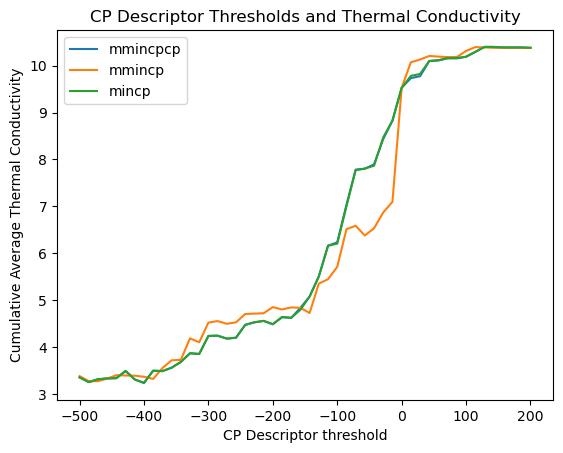

In [311]:
valuetierhere=np.linspace(-500,200,50)
plt.plot(valuetierhere,mmincpcptiers,label='mmincpcp')
plt.plot(valuetierhere,mmincptiers,label='mmincp')
plt.plot(valuetierhere,mincptiers,label='mincp')
plt.legend()
plt.title('CP Descriptor Thresholds and Thermal Conductivity')
plt.ylabel('Cumulative Average Thermal Conductivity')
plt.xlabel('CP Descriptor threshold')

In [72]:
#AFLOWthermmlcp.sort_values(['minXs'])

ATM: aflow thermal conductivity data
2: binaries only
R: relaxed lattice parameters
E: selected elements only
M: metals (Egap=0)
S: semiconductors (0<Egap<0.25)
I: insulators (Egap>0.25

In [317]:
kpred={}
kpred['ATM']=AFLOWthermmlcp
kpred['ATM2']=ATM2
kpred['ATMR']=AFLOWthermmlcprelax
kpred['ATMR2']=ATM2R
kpred['ATME']=ATME
kpred['ATME2']=ATME2
kpred['ATMER']=ATMER
kpred['ATMER2']=ATME2R
kpred['ATMEM']=ATMEM
kpred['ATMEM2']=ATMEM2
kpred['ATMERM']=ATMERM
kpred['ATMERM2']=ATMERM2
kpred['ATMES']=ATMES
kpred['ATMES2']=ATMES2
kpred['ATMERS']=ATMERS
kpred['ATMERS2']=ATMERS2
kpred['ATMEI']=ATMEI
kpred['ATMEI2']=ATMEI2
kpred['ATMERI']=ATMERI
kpred['ATMERI2']=ATMERI2


full_list_ML=['ATM','ATM2','ATMR','ATMR2','ATME','ATME2','ATMER','ATMER2','ATMEM','ATMEM2','ATMERM','ATMERM2','ATMEI','ATMEI2','ATMERI','ATMERI2','ATMES','ATMES2','ATMERS','ATMERS2']
for i in full_list_ML:
    kpred[i+'features']=ref2.write_features_ratio(kpred[i],label_col = 'compound')

100%|██████████████████████████████████████| 2614/2614 [00:09<00:00, 272.32it/s]


Data Shape: (2614, 217)


100%|██████████████████████████████████████| 1295/1295 [00:04<00:00, 320.12it/s]


Data Shape: (1295, 217)


100%|██████████████████████████████████████| 2614/2614 [00:09<00:00, 270.54it/s]


Data Shape: (2614, 217)


100%|██████████████████████████████████████| 1295/1295 [00:04<00:00, 322.88it/s]


Data Shape: (1295, 217)


100%|██████████████████████████████████████| 1790/1790 [00:06<00:00, 275.90it/s]


Data Shape: (1790, 217)


100%|████████████████████████████████████████| 984/984 [00:02<00:00, 334.39it/s]


Data Shape: (984, 217)


100%|██████████████████████████████████████| 1790/1790 [00:06<00:00, 270.00it/s]


Data Shape: (1790, 217)


100%|████████████████████████████████████████| 984/984 [00:02<00:00, 331.85it/s]


Data Shape: (984, 217)


100%|██████████████████████████████████████| 1646/1646 [00:05<00:00, 281.99it/s]


Data Shape: (1646, 217)


100%|████████████████████████████████████████| 889/889 [00:02<00:00, 336.43it/s]


Data Shape: (889, 217)


100%|██████████████████████████████████████| 1646/1646 [00:05<00:00, 282.74it/s]


Data Shape: (1646, 217)


100%|████████████████████████████████████████| 889/889 [00:02<00:00, 337.25it/s]


Data Shape: (889, 217)


100%|████████████████████████████████████████| 118/118 [00:00<00:00, 301.20it/s]


Data Shape: (118, 217)


100%|██████████████████████████████████████████| 82/82 [00:00<00:00, 343.40it/s]


Data Shape: (82, 217)


100%|████████████████████████████████████████| 118/118 [00:00<00:00, 303.51it/s]


Data Shape: (118, 217)


100%|██████████████████████████████████████████| 82/82 [00:00<00:00, 342.68it/s]


Data Shape: (82, 217)


100%|██████████████████████████████████████████| 26/26 [00:00<00:00, 273.63it/s]


Data Shape: (26, 217)


100%|██████████████████████████████████████████| 13/13 [00:00<00:00, 303.07it/s]


Data Shape: (13, 217)


100%|██████████████████████████████████████████| 26/26 [00:00<00:00, 238.15it/s]


Data Shape: (26, 217)


100%|██████████████████████████████████████████| 13/13 [00:00<00:00, 306.92it/s]

Data Shape: (13, 217)


In [348]:
kpred['ATM'].query('real_spacegroup=="204"')

,compound,real_spacegroup,compoundtype,ICSD,kappa,bulk_modulus,debye,gruneisen,enthalpy,energy,speed_sound,positions,prototype,spacegroup,Pearson,geometry,real_geometry,species,nspecies,Wletters,real_Wletters,Wmultiplicities,real_Wmultiplicities,Wsite_symmetries,lenpos,summult,real_summult,real_multiplier,multiplier,temperature,Egap,Egap_fit,Egap_type,Etype,auid,aurl,sites,real_sites,multdif,lettfidd,issues,reduced,mincp,site,atom,Xs,Xs2,mincpavg,mmincp,mmincpcp,mmsite,mmatom,mmXs,CPD,mmincpsum,z,rootkappa,4rootkappa,ktiers,kclass,kunder,totalCP,maxcp,mmaxcp,msumavgcp,stdevcp,sumavgcp,sumcp,avgcp,negpctcp,rangecp,minXs,maxXs,rangeXs,avgXs,stdevXs,bias


In [318]:
for i in full_list_ML:
    kpred[i+'data']=kpred[i+'features'].join(kpred[i].reset_index(drop=True))

0:217 is standard composition features

217:221 is composition and other identifiers

221 is kappa

222:228 is other numerical qualities

228:255 is other structural detail

255:259 is set fiters

np.r_[259,262:267,269:273,278:294] is mlcp numbers

np.r_[260:262,267:269] is atoms/sites

273:278 is other versions of kappa

note: fix 0 division error in mlcpquicker code for Xs

In [319]:
threshold=2
for i in full_list_ML:
    kpred[i+'data']['under'+str(threshold)]=[1 if k<threshold else 0 for k in kpred[i+'data']['kappa']]

for i in full_list_ML:
    kpred['train'+i],kpred['ytrain'+i],kpred['test'+i],kpred['ytest'+i]=ref.split(kpred[i+'data'],kpred[i+'data']['under'+str(threshold)],split_fraction=0.8)
    

Training data size: 2091
Test data size: 523
Training data size: 1036
Test data size: 259
Training data size: 2091
Test data size: 523
Training data size: 1036
Test data size: 259
Training data size: 1432
Test data size: 358
Training data size: 787
Test data size: 197
Training data size: 1432
Test data size: 358
Training data size: 787
Test data size: 197
Training data size: 1317
Test data size: 329
Training data size: 711
Test data size: 178
Training data size: 1317
Test data size: 329
Training data size: 711
Test data size: 178
Training data size: 94
Test data size: 24
Training data size: 66
Test data size: 16
Training data size: 94
Test data size: 24
Training data size: 66
Test data size: 16
Training data size: 21
Test data size: 5
Training data size: 10
Test data size: 3
Training data size: 21
Test data size: 5
Training data size: 10
Test data size: 3


In [333]:
kpred['train'+'ATMERM2'].columns

Index(['avg_Composition_Ag', 'avg_Composition_Al', 'avg_Composition_Ar',
       'avg_Composition_As', 'avg_Composition_Au', 'avg_Composition_B',
       'avg_Composition_Ba', 'avg_Composition_Be', 'avg_Composition_Bi',
       'avg_Composition_Br',
       ...
       'avgcp', 'negpctcp', 'rangecp', 'minXs', 'maxXs', 'rangeXs', 'avgXs',
       'stdevXs', 'bias', 'under2'],
      dtype='object', length=295)

In [340]:
kpred['test'+'ATMR2'].query('avg_Composition_La>0 & avg_Composition_Co>0 & avg_Composition_Sb>0')

,avg_Composition_Ag,avg_Composition_Al,avg_Composition_Ar,avg_Composition_As,avg_Composition_Au,avg_Composition_B,avg_Composition_Ba,avg_Composition_Be,avg_Composition_Bi,avg_Composition_Br,avg_Composition_C,avg_Composition_Ca,avg_Composition_Cd,avg_Composition_Ce,avg_Composition_Cl,avg_Composition_Co,avg_Composition_Cr,avg_Composition_Cs,avg_Composition_Cu,avg_Composition_Dy,avg_Composition_Er,avg_Composition_Eu,avg_Composition_F,avg_Composition_Fe,avg_Composition_Ga,avg_Composition_Gd,avg_Composition_Ge,avg_Composition_H,avg_Composition_He,avg_Composition_Hf,avg_Composition_Hg,avg_Composition_Ho,avg_Composition_I,avg_Composition_In,avg_Composition_Ir,avg_Composition_K,avg_Composition_Kr,avg_Composition_La,avg_Composition_Li,avg_Composition_Lu,avg_Composition_Mg,avg_Composition_Mn,avg_Composition_Mo,avg_Composition_N,avg_Composition_Na,avg_Composition_Nb,avg_Composition_Nd,avg_Composition_Ne,avg_Composition_Ni,avg_Composition_O,avg_Composition_Os,avg_Composition_P,avg_Composition_Pb,avg_Composition_Pd,avg_Composition_Pm,avg_Composition_Pr,avg_Composition_Pt,avg_Composition_Rb,avg_Composition_Re,avg_Composition_Rh,avg_Composition_Ru,avg_Composition_S,avg_Composition_Sb,avg_Composition_Sc,avg_Composition_Se,avg_Composition_Si,avg_Composition_Sm,avg_Composition_Sn,avg_Composition_Sr,avg_Composition_Ta,avg_Composition_Tb,avg_Composition_Tc,avg_Composition_Te,avg_Composition_Th,avg_Composition_Ti,avg_Composition_Tl,avg_Composition_Tm,avg_Composition_U,avg_Composition_V,avg_Composition_W,avg_Composition_Xe,avg_Composition_Y,avg_Composition_Yb,avg_Composition_Zn,avg_Composition_Zr,avg_ Atomic_Number,avg_ Atomic_Weight,avg_Period,avg_group,avg_families,avg_Mendeleev Number,avg_Atomic Radus,avg_crystal radius,avg_ Pauling_Electronegativity,avg_metallic valence,avg_number of valence electrons,avg_outer shell electrons,avg_1st ionization potential (kJ/mol),avg_polarizability\n(A^3),avg_Melting point (K),avg_Density (g/mL),avg_specific heat (J/g K),avg_heat of fusion (kJ/mol),avg_thermal conductivity (W/(m K)),avg_heat atomization\n(kJ/mol),avg_Cohesive energy,avg_electron affinity (kJ/mol),diff_ Atomic_Number,diff_ Atomic_Weight,diff_Period,diff_group,diff_families,diff_Mendeleev Number,diff_Atomic Radus,diff_crystal radius,diff_ Pauling_Electronegativity,diff_metallic valence,diff_number of valence electrons,diff_outer shell electrons,diff_1st ionization potential (kJ/mol),diff_polarizability\n(A^3),diff_Melting point (K),diff_Density (g/mL),diff_specific heat (J/g K),diff_heat of fusion (kJ/mol),diff_thermal conductivity (W/(m K)),diff_heat atomization\n(kJ/mol),diff_Cohesive energy,diff_electron affinity (kJ/mol),max_ Atomic_Number,max_ Atomic_Weight,max_Period,max_group,max_families,max_Mendeleev Number,max_Atomic Radus,max_crystal radius,max_ Pauling_Electronegativity,max_metallic valence,max_number of valence electrons,max_outer shell electrons,max_1st ionization potential (kJ/mol),max_polarizability\n(A^3),max_Melting point (K),max_Density (g/mL),max_specific heat (J/g K),max_heat of fusion (kJ/mol),max_thermal conductivity (W/(m K)),max_heat atomization\n(kJ/mol),max_Cohesive energy,max_electron affinity (kJ/mol),min_ Atomic_Number,min_ Atomic_Weight,min_Period,min_group,min_families,min_Mendeleev Number,min_Atomic Radus,min_crystal radius,min_ Pauling_Electronegativity,min_metallic valence,min_number of valence electrons,min_outer shell electrons,min_1st ionization potential (kJ/mol),min_polarizability\n(A^3),min_Melting point (K),min_Density (g/mL),min_specific heat (J/g K),min_heat of fusion (kJ/mol),min_thermal conductivity (W/(m K)),min_heat atomization\n(kJ/mol),min_Cohesive energy,min_electron affinity (kJ/mol),sum_ Atomic_Number,sum_ Atomic_Weight,sum_Period,sum_group,sum_families,sum_Mendeleev Number,sum_Atomic Radus,sum_crystal radius,sum_ Pauling_Electronegativity,sum_metallic valence,sum_number of valence electrons,sum_outer shell electrons,sum_1st ionization potential (kJ/mol),sum_polarizability\n(A^3),sum_Melting p

In [320]:
for i in full_list_ML:
    kpred['Rtrain'+i],kpred['Rytrain'+i],kpred['Rtest'+i],kpred['Rytest'+i]=ref.split(kpred[i+'data'],kpred[i+'data']['kappa'],split_fraction=0.8)

Training data size: 2091
Test data size: 523
Training data size: 1036
Test data size: 259
Training data size: 2091
Test data size: 523
Training data size: 1036
Test data size: 259
Training data size: 1432
Test data size: 358
Training data size: 787
Test data size: 197
Training data size: 1432
Test data size: 358
Training data size: 787
Test data size: 197
Training data size: 1317
Test data size: 329
Training data size: 711
Test data size: 178
Training data size: 1317
Test data size: 329
Training data size: 711
Test data size: 178
Training data size: 94
Test data size: 24
Training data size: 66
Test data size: 16
Training data size: 94
Test data size: 24
Training data size: 66
Test data size: 16
Training data size: 21
Test data size: 5
Training data size: 10
Test data size: 3
Training data size: 21
Test data size: 5
Training data size: 10
Test data size: 3


In [321]:
for i in full_list_ML:
    kpred['Xtrain'+i]=kpred['train'+i].iloc[:,np.r_[0:217]]
    kpred['Xtrain'+i+'CP']=kpred['train'+i].iloc[:,np.r_[0:217,259,262:267,269:273,278:294]]
    kpred['Xtrain'+i+'CPO']=kpred['train'+i].iloc[:,np.r_[259,262:267,269:273,278:294]]
    kpred['Xtest'+i]=kpred['test'+i].iloc[:,np.r_[0:217]]
    kpred['Xtest'+i+'CP']=kpred['test'+i].iloc[:,np.r_[0:217,259,262:267,269:273,278:294]]
    kpred['Xtest'+i+'CPO']=kpred['test'+i].iloc[:,np.r_[259,262:267,269:273,278:294]]

In [322]:
for i in full_list_ML:
    kpred['RXtrain'+i]=kpred['Rtrain'+i].iloc[:,np.r_[0:217]]
    kpred['RXtrain'+i+'CP']=kpred['Rtrain'+i].iloc[:,np.r_[0:217,259,262:267,269:273,278:294]]
    kpred['RXtrain'+i+'CPO']=kpred['Rtrain'+i].iloc[:,np.r_[259,262:267,269:273,278:294]]
    kpred['RXtest'+i]=kpred['Rtest'+i].iloc[:,np.r_[0:217]]
    kpred['RXtest'+i+'CP']=kpred['Rtest'+i].iloc[:,np.r_[0:217,259,262:267,269:273,278:294]]
    kpred['RXtest'+i+'CPO']=kpred['Rtest'+i].iloc[:,np.r_[259,262:267,269:273,278:294]]

In [323]:
#DecisionTreeClassifier
#RandomForestClassifier
#HistGradientBoostingClassifier
#GradientBoostingClassifier

# modelthermCP=RandomForestClassifier(max_depth=3).fit(X_trainCP,y_train)
# modeltherm=RandomForestClassifier(max_depth=3).fit(X_train,y_train)
# modelthermCPonly=RandomForestClassifier(max_depth=3).fit(X_trainCPonly,y_train)

for i in full_list_ML[-12:]:
    for j in ['','CP','CPO']:
        kpred['rfcmodel'+i+j]=RandomForestClassifier(max_depth=3).fit(kpred['Xtrain'+i+j],kpred['ytrain'+i])
        kpred['dtcmodel'+i+j]=DecisionTreeClassifier(max_depth=3).fit(kpred['Xtrain'+i+j],kpred['ytrain'+i])
        kpred['hgbcmodel'+i+j]=HistGradientBoostingClassifier().fit(kpred['Xtrain'+i+j],kpred['ytrain'+i])
        kpred['gbcmodel'+i+j]=GradientBoostingClassifier().fit(kpred['Xtrain'+i+j],kpred['ytrain'+i])

In [327]:
for i in full_list_ML[:-12]:
    for j in ['','CP','CPO']:
        kpred['rfrmodel'+i+j]=RandomForestRegressor(max_depth=3).fit(kpred['RXtrain'+i+j],kpred['Rytrain'+i])
        kpred['gbrmodel'+i+j]=GradientBoostingRegressor().fit(kpred['RXtrain'+i+j],kpred['Rytrain'+i])

ATM
Cross validation r2_score 0.5847
Cross validation mean_absolute_error 4.9502
Cross validation mean_squared_error 93.8326


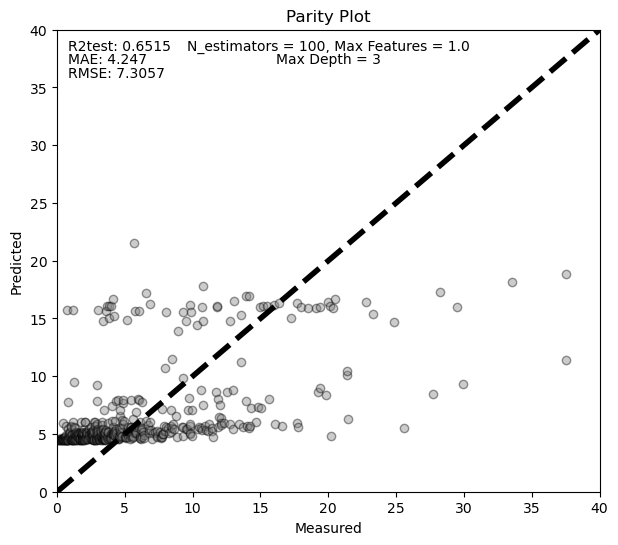

Cross validation r2_score 0.747
Cross validation mean_absolute_error 2.9786
Cross validation mean_squared_error 57.1517


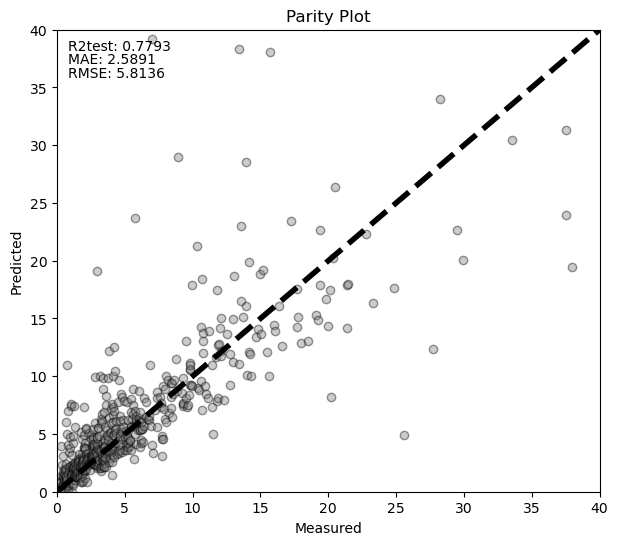

ATMCP
Cross validation r2_score 0.5851
Cross validation mean_absolute_error 4.9254
Cross validation mean_squared_error 93.7304


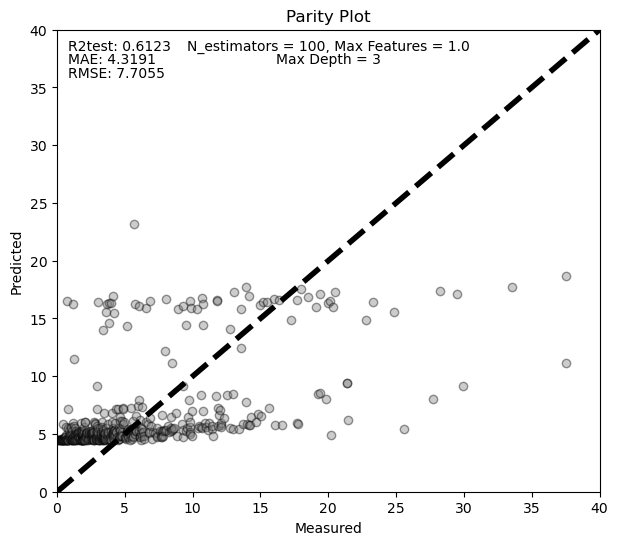

Cross validation r2_score 0.7554
Cross validation mean_absolute_error 2.976
Cross validation mean_squared_error 55.2649


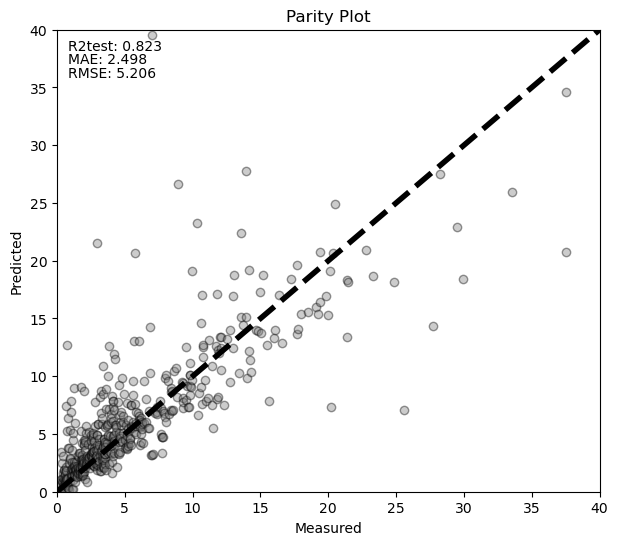

ATMCPO
Cross validation r2_score 0.1171
Cross validation mean_absolute_error 6.7877
Cross validation mean_squared_error 199.4609


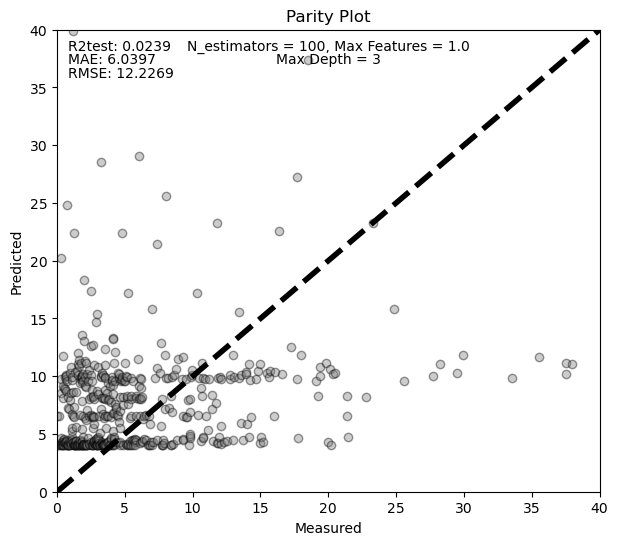

Cross validation r2_score 0.1427
Cross validation mean_absolute_error 6.519
Cross validation mean_squared_error 193.6819


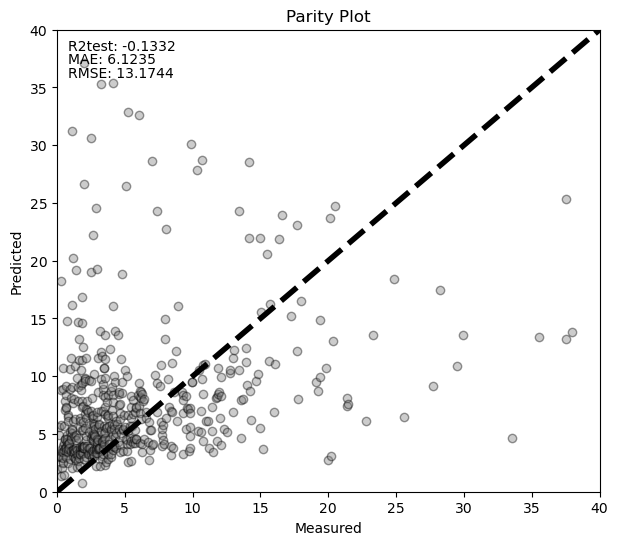

ATM2
Cross validation r2_score 0.6383
Cross validation mean_absolute_error 5.7018
Cross validation mean_squared_error 98.4532


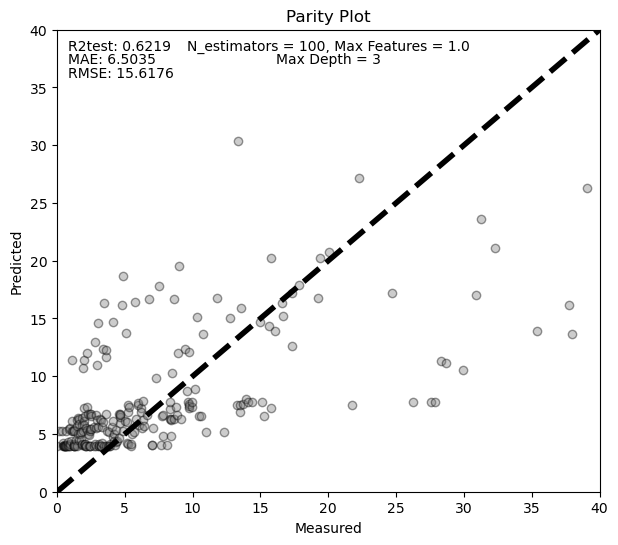

Cross validation r2_score 0.7126
Cross validation mean_absolute_error 4.1258
Cross validation mean_squared_error 78.2115


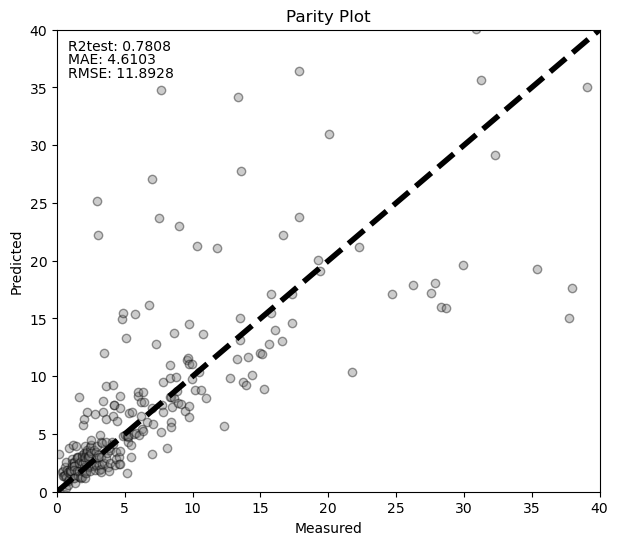

ATM2CP
Cross validation r2_score 0.6396
Cross validation mean_absolute_error 5.6891
Cross validation mean_squared_error 98.0907


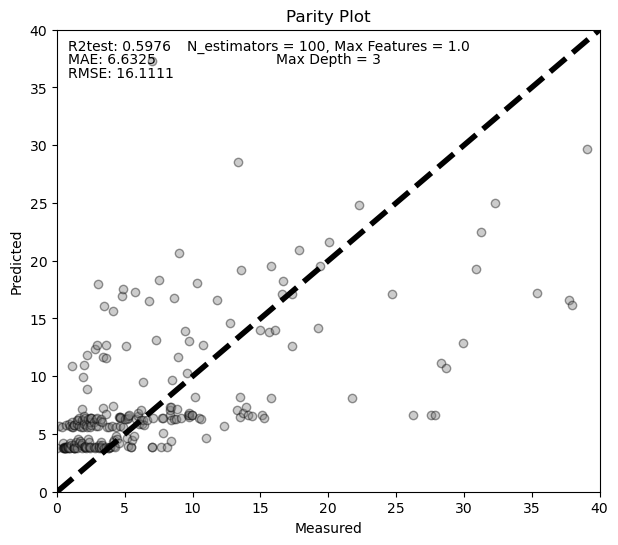

Cross validation r2_score 0.721
Cross validation mean_absolute_error 4.1176
Cross validation mean_squared_error 75.9406


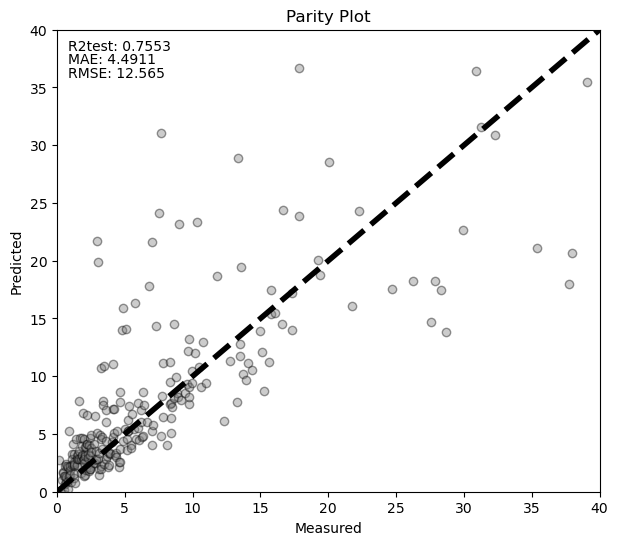

ATM2CPO
Cross validation r2_score 0.1537
Cross validation mean_absolute_error 8.4914
Cross validation mean_squared_error 230.3401


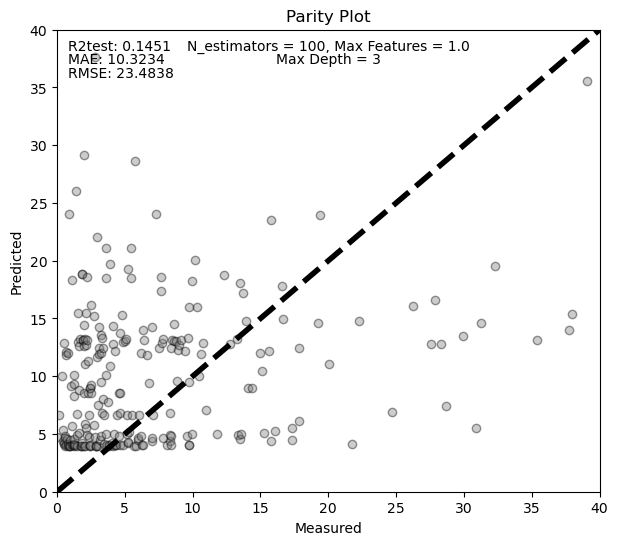

Cross validation r2_score 0.1824
Cross validation mean_absolute_error 8.436
Cross validation mean_squared_error 222.5316


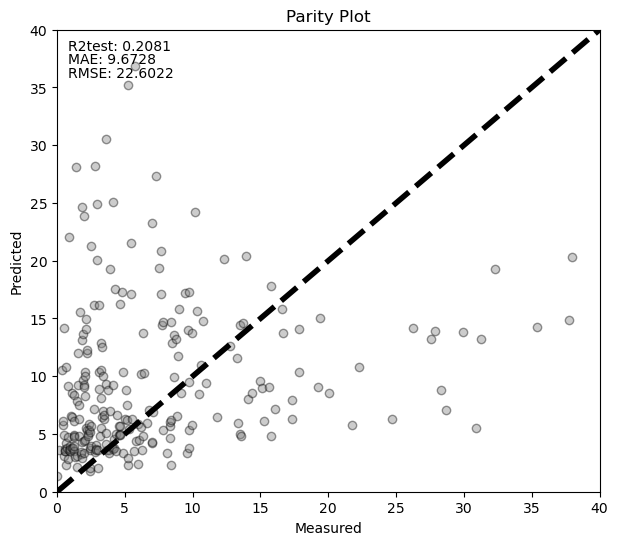

ATMR
Cross validation r2_score 0.59
Cross validation mean_absolute_error 4.9089
Cross validation mean_squared_error 92.6326


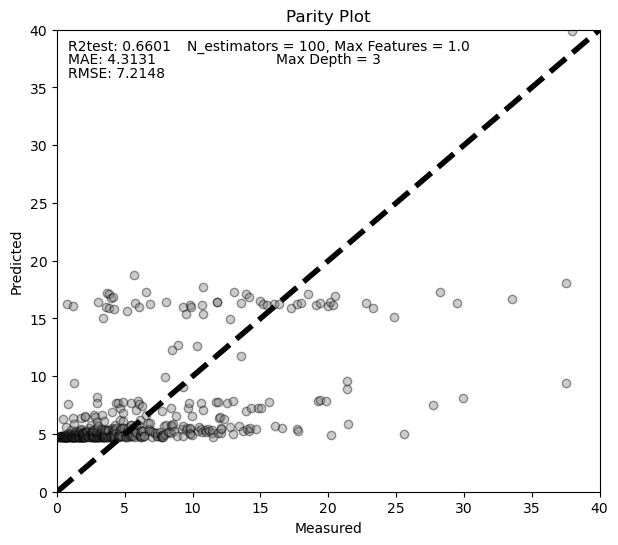

Cross validation r2_score 0.7493
Cross validation mean_absolute_error 3.0341
Cross validation mean_squared_error 56.64


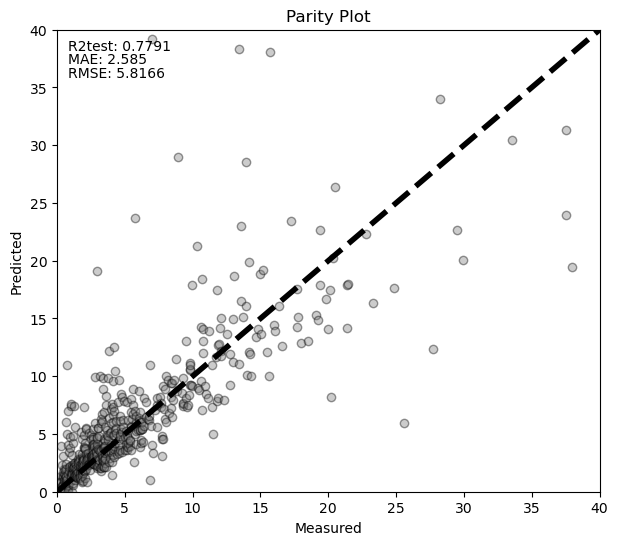

ATMRCP
Cross validation r2_score 0.5801
Cross validation mean_absolute_error 4.9681
Cross validation mean_squared_error 94.8665


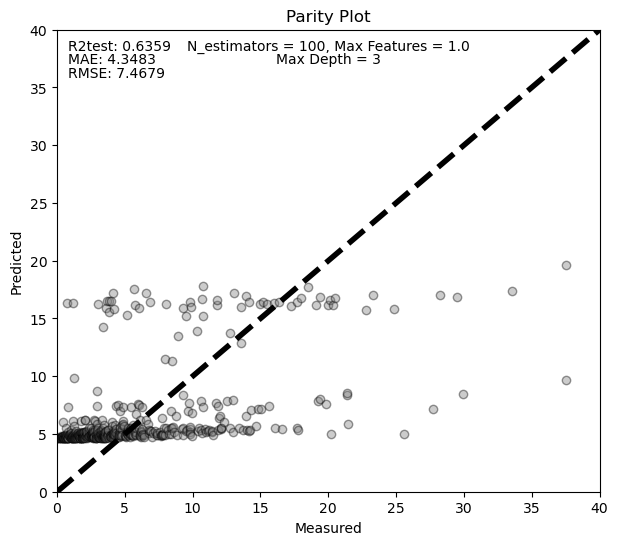

Cross validation r2_score 0.7277
Cross validation mean_absolute_error 3.0881
Cross validation mean_squared_error 61.5213


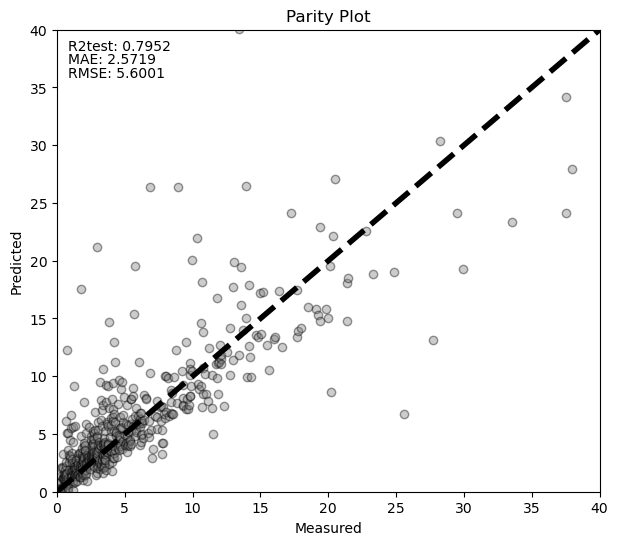

ATMRCPO
Cross validation r2_score 0.1498
Cross validation mean_absolute_error 6.6181
Cross validation mean_squared_error 192.0655


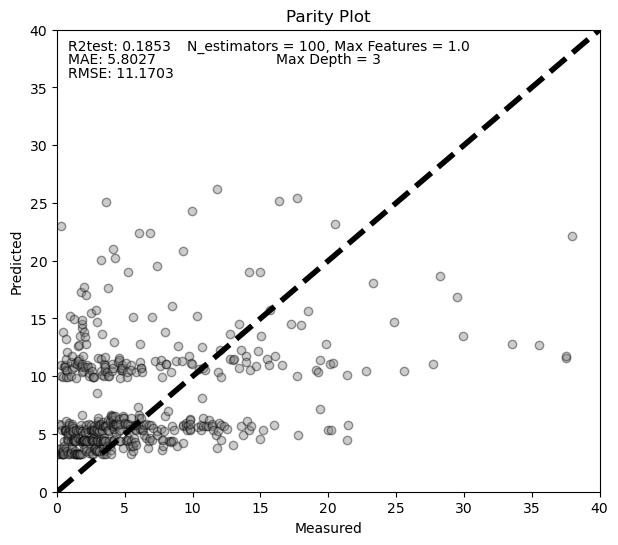

Cross validation r2_score 0.0105
Cross validation mean_absolute_error 6.6563
Cross validation mean_squared_error 223.5365


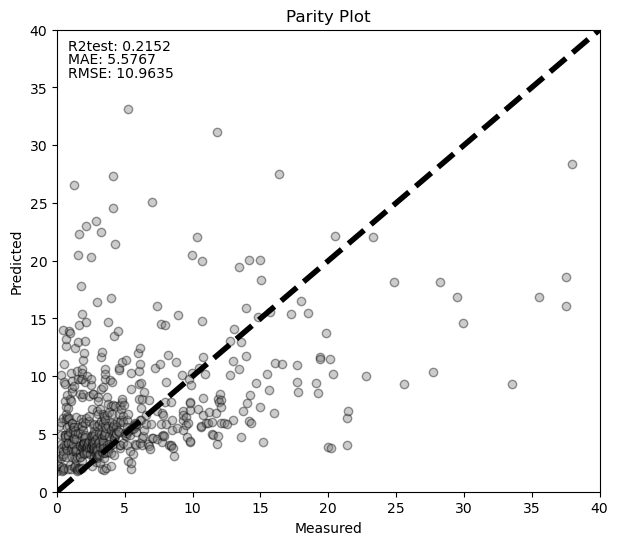

ATMR2
Cross validation r2_score 0.6271
Cross validation mean_absolute_error 5.7559
Cross validation mean_squared_error 101.5003


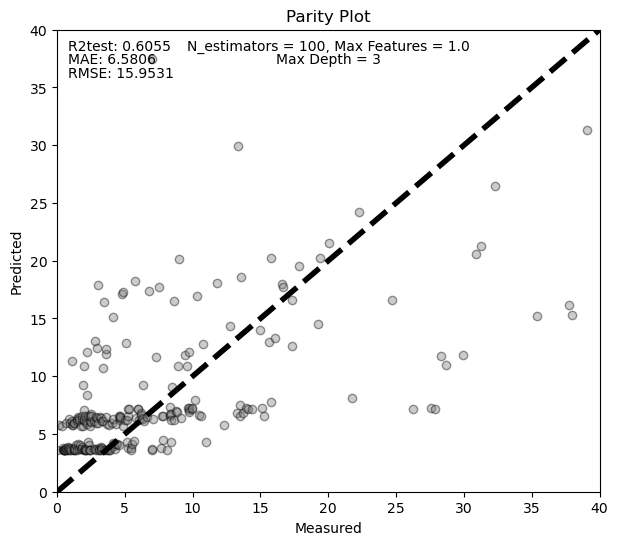

Cross validation r2_score 0.7062
Cross validation mean_absolute_error 4.1475
Cross validation mean_squared_error 79.9622


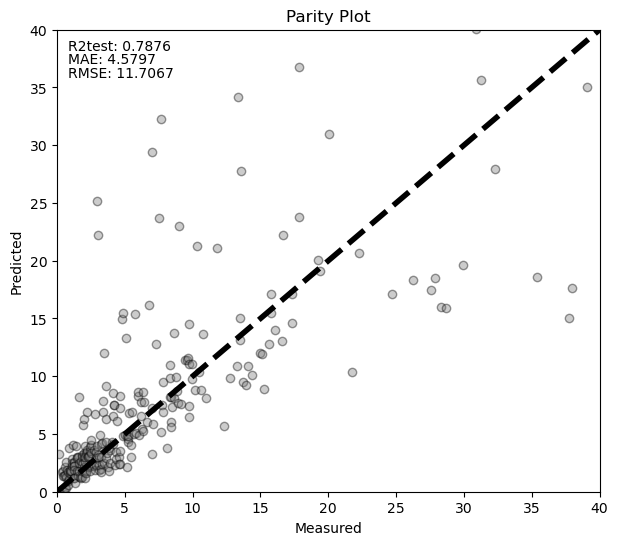

ATMR2CP
Cross validation r2_score 0.6375
Cross validation mean_absolute_error 5.6743
Cross validation mean_squared_error 98.6512


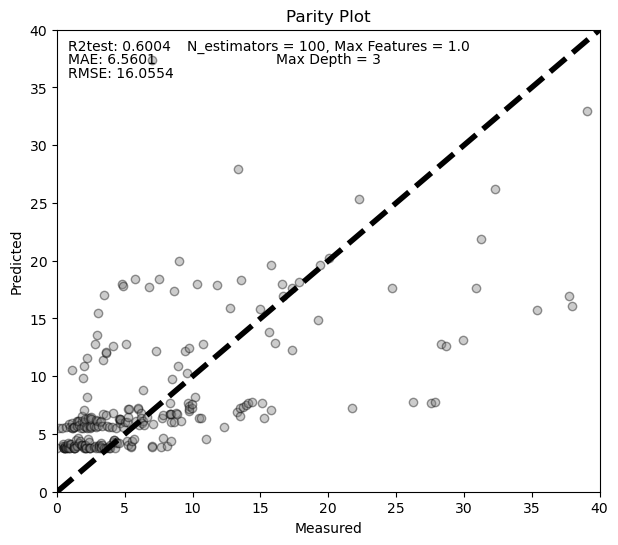

Cross validation r2_score 0.725
Cross validation mean_absolute_error 4.0485
Cross validation mean_squared_error 74.8381


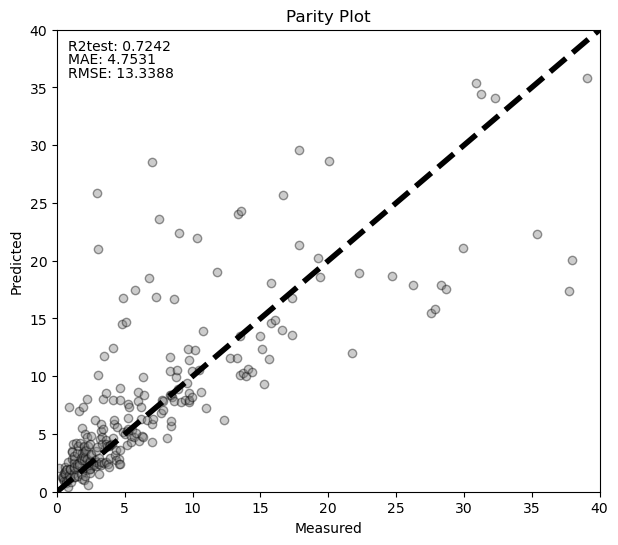

ATMR2CPO
Cross validation r2_score 0.175
Cross validation mean_absolute_error 8.3689
Cross validation mean_squared_error 224.5302


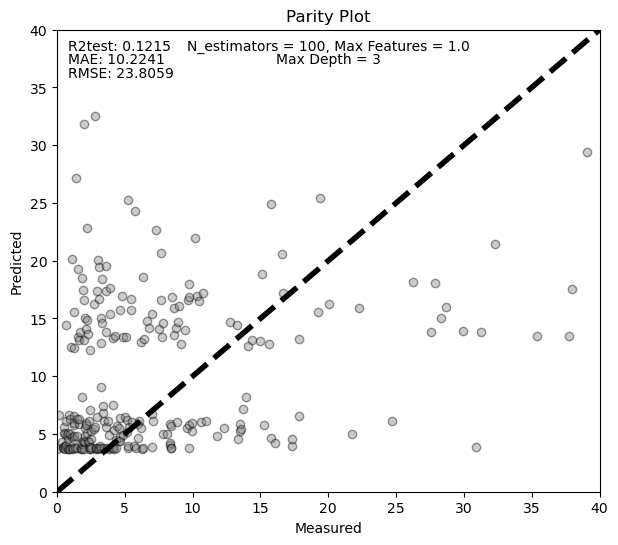

Cross validation r2_score 0.2529
Cross validation mean_absolute_error 7.7834
Cross validation mean_squared_error 203.3515


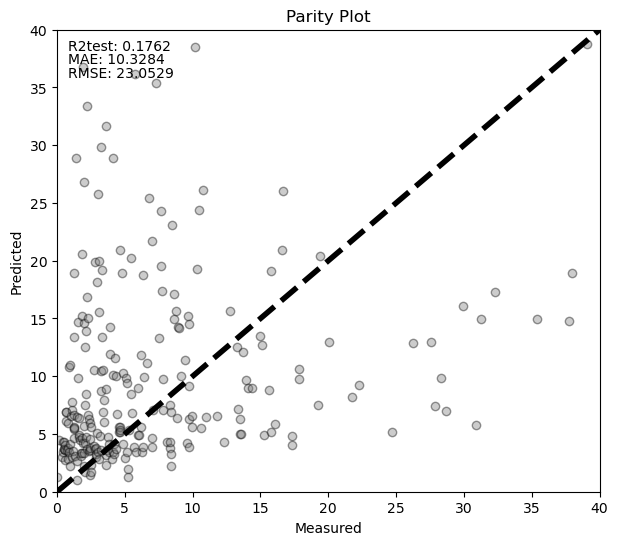

ATME
Cross validation r2_score 0.6584
Cross validation mean_absolute_error 4.8863
Cross validation mean_squared_error 81.6898


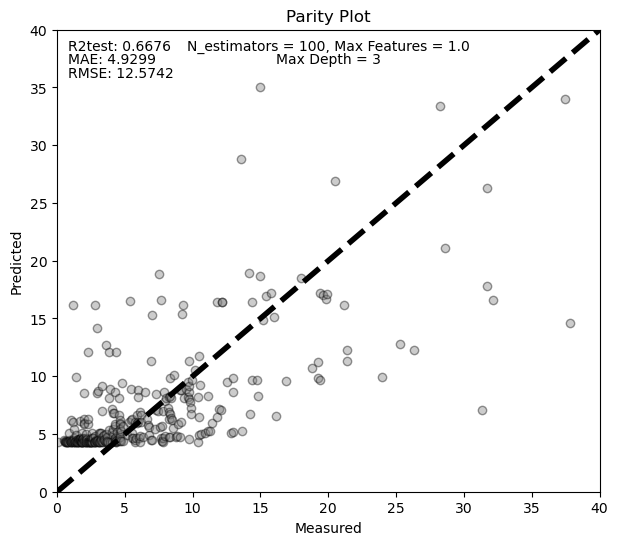

Cross validation r2_score 0.7449
Cross validation mean_absolute_error 3.3571
Cross validation mean_squared_error 60.9916


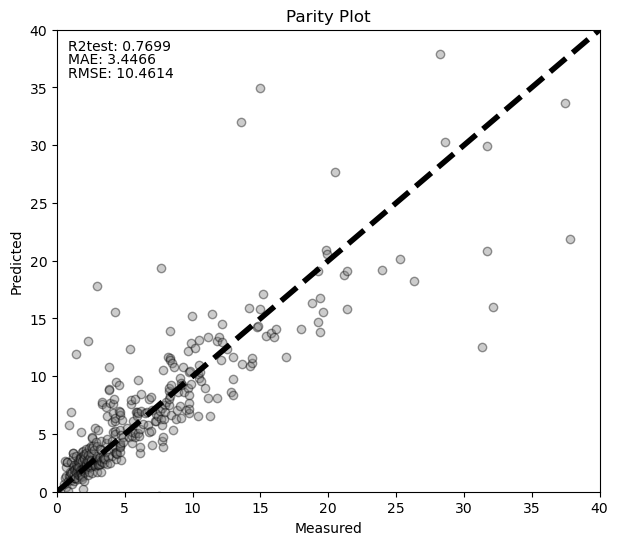

ATMECP
Cross validation r2_score 0.6396
Cross validation mean_absolute_error 4.9497
Cross validation mean_squared_error 86.183


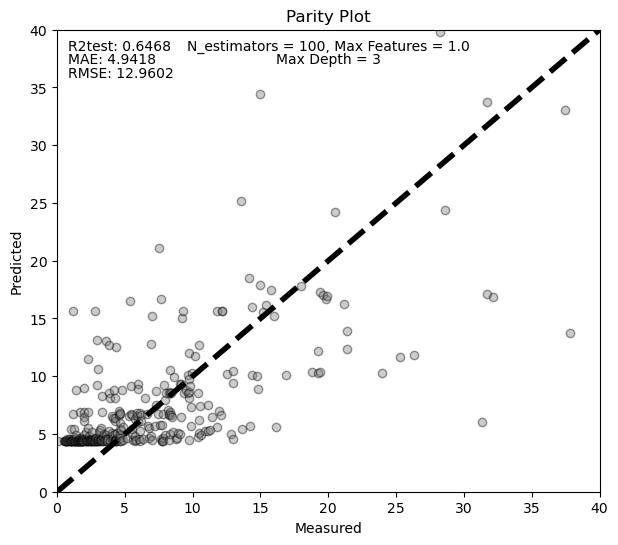

Cross validation r2_score 0.7278
Cross validation mean_absolute_error 3.403
Cross validation mean_squared_error 65.0925


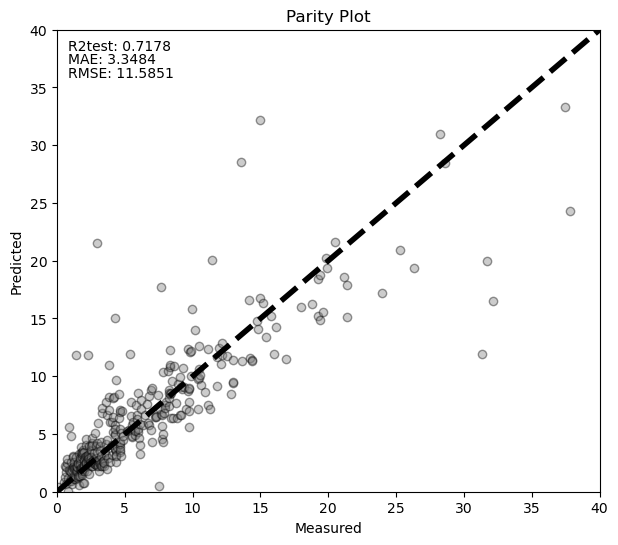

ATMECPO
Cross validation r2_score 0.1849
Cross validation mean_absolute_error 7.2239
Cross validation mean_squared_error 194.9022


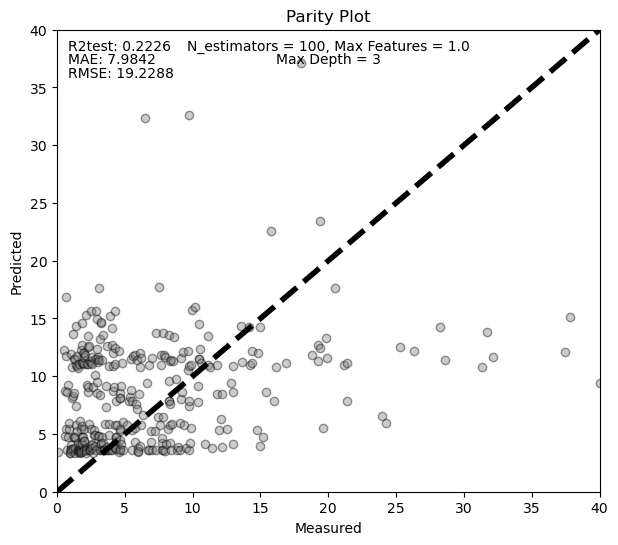

Cross validation r2_score 0.2356
Cross validation mean_absolute_error 6.9677
Cross validation mean_squared_error 182.774


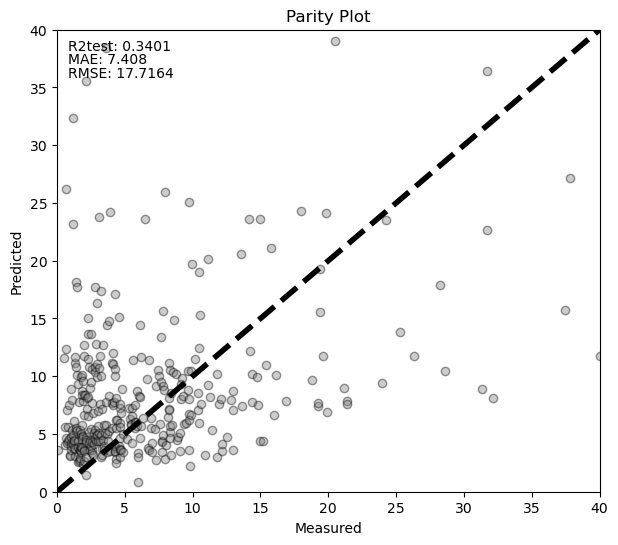

ATME2
Cross validation r2_score 0.653
Cross validation mean_absolute_error 6.4526
Cross validation mean_squared_error 147.7891


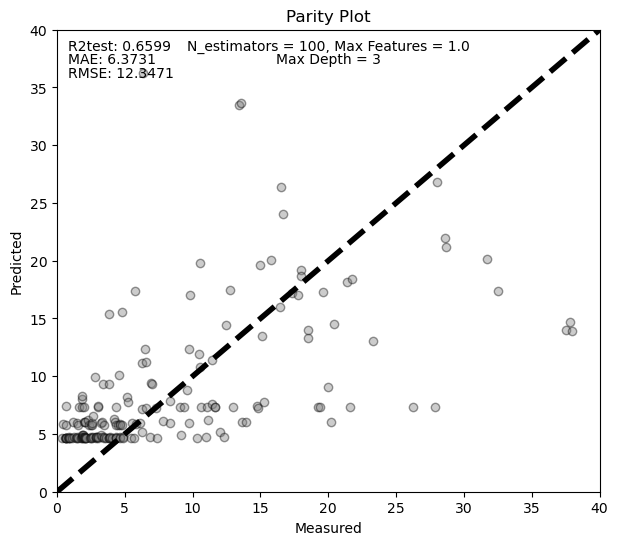

Cross validation r2_score 0.7107
Cross validation mean_absolute_error 4.8365
Cross validation mean_squared_error 123.238


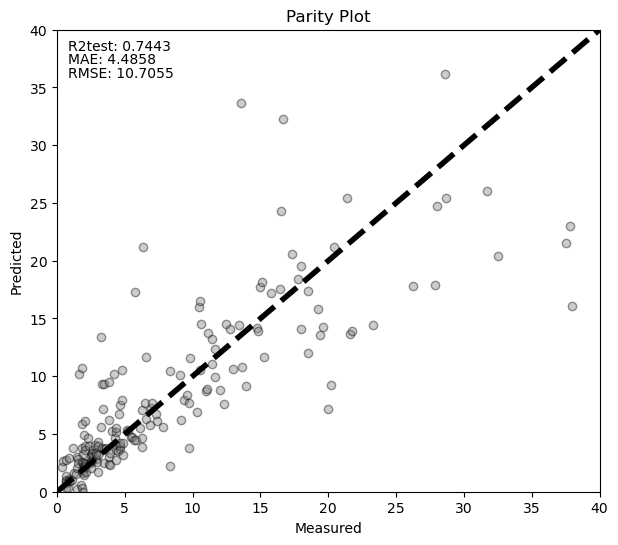

ATME2CP
Cross validation r2_score 0.5989
Cross validation mean_absolute_error 6.5906
Cross validation mean_squared_error 170.8623


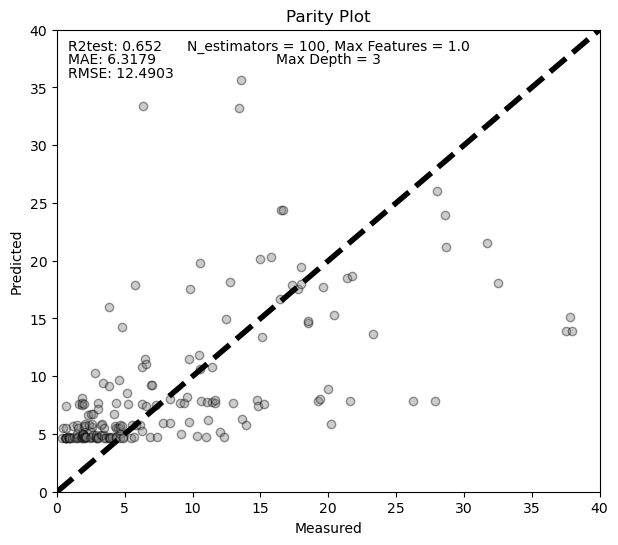

Cross validation r2_score 0.7035
Cross validation mean_absolute_error 4.8659
Cross validation mean_squared_error 126.2726


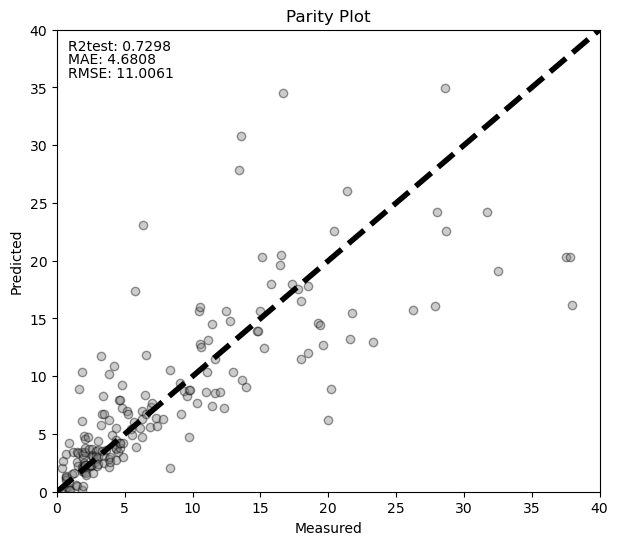

ATME2CPO
Cross validation r2_score 0.0497
Cross validation mean_absolute_error 10.628
Cross validation mean_squared_error 404.7954


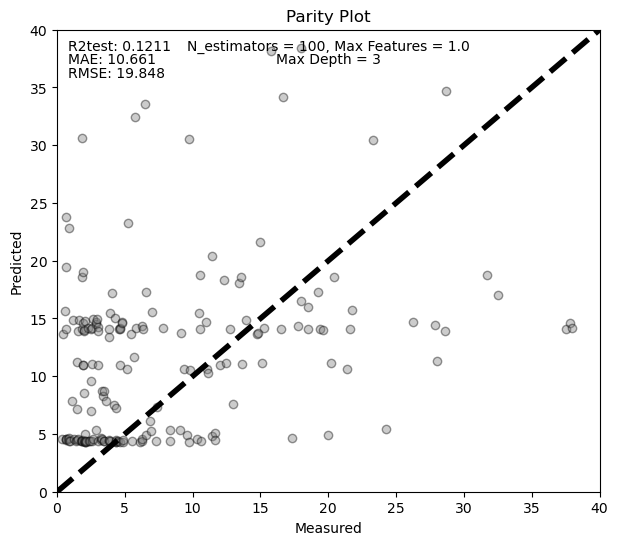

Cross validation r2_score 0.1194
Cross validation mean_absolute_error 10.072
Cross validation mean_squared_error 375.0784


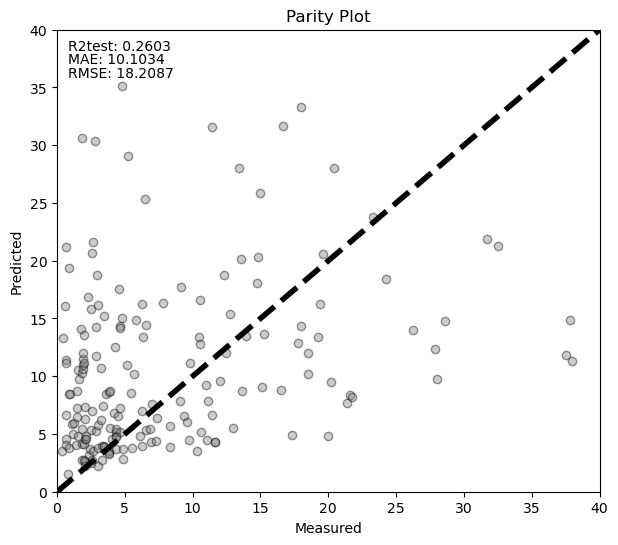

ATMER
Cross validation r2_score 0.6593
Cross validation mean_absolute_error 4.8289
Cross validation mean_squared_error 81.4642


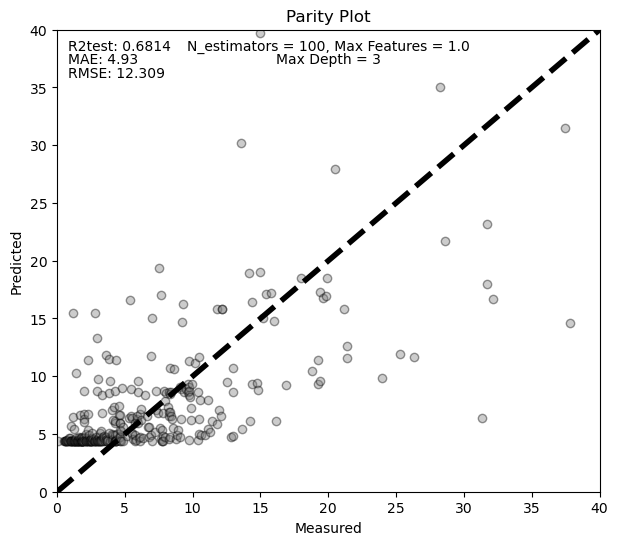

Cross validation r2_score 0.748
Cross validation mean_absolute_error 3.3661
Cross validation mean_squared_error 60.2575


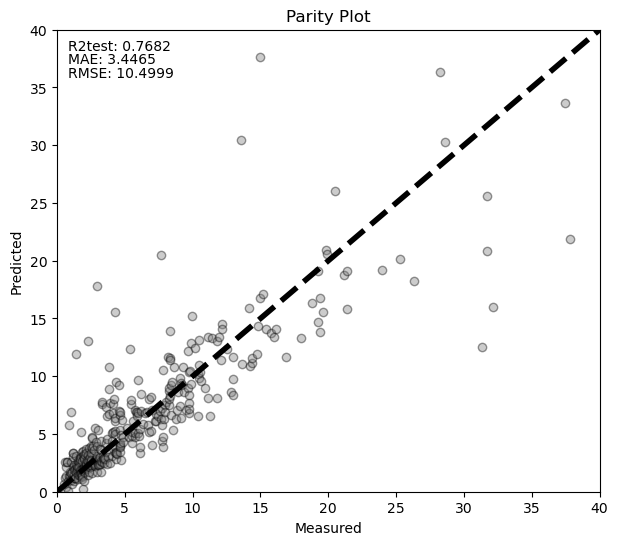

ATMERCP
Cross validation r2_score 0.6507
Cross validation mean_absolute_error 4.894
Cross validation mean_squared_error 83.53


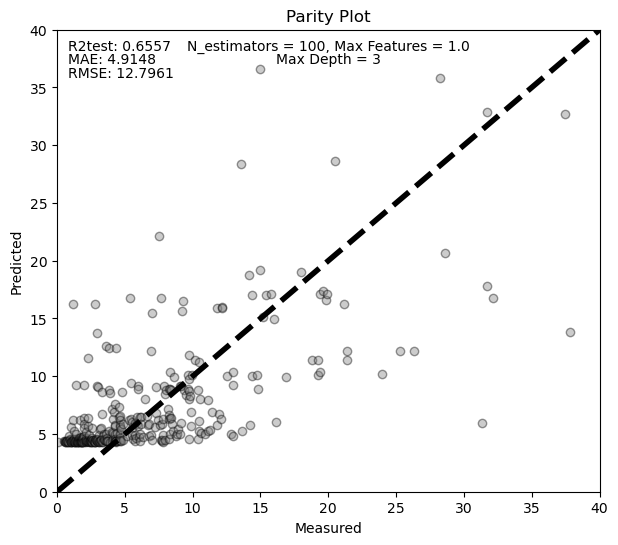

Cross validation r2_score 0.7611
Cross validation mean_absolute_error 3.3717
Cross validation mean_squared_error 57.1242


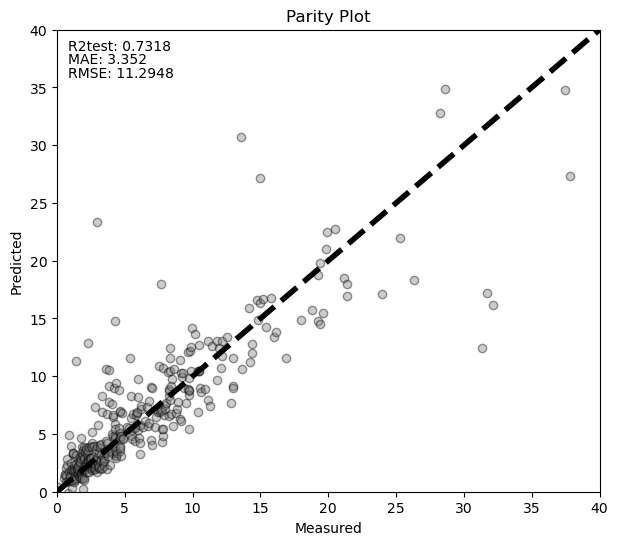

ATMERCPO
Cross validation r2_score 0.1929
Cross validation mean_absolute_error 7.0526
Cross validation mean_squared_error 192.986


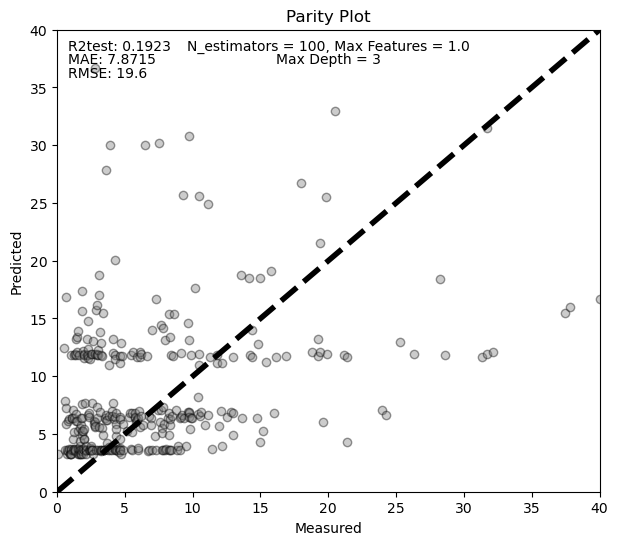

Cross validation r2_score 0.3035
Cross validation mean_absolute_error 6.6247
Cross validation mean_squared_error 166.5536


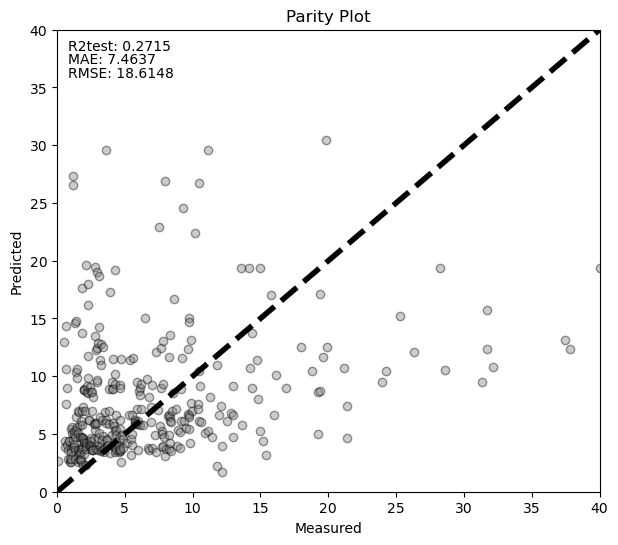

ATMER2
Cross validation r2_score 0.6502
Cross validation mean_absolute_error 6.4423
Cross validation mean_squared_error 149.0129


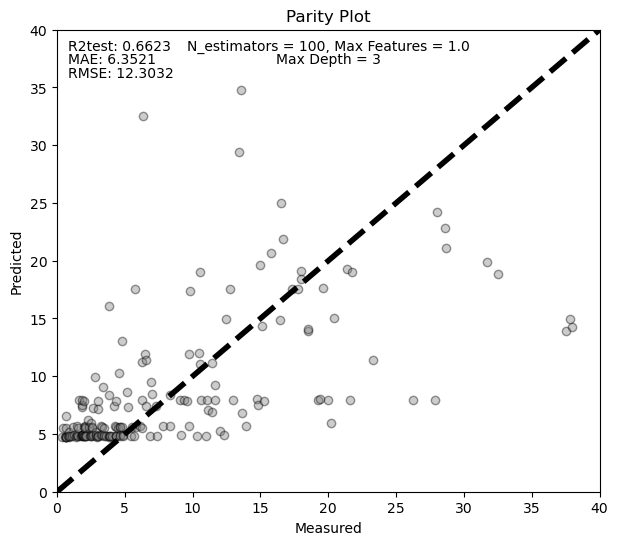

Cross validation r2_score 0.7482
Cross validation mean_absolute_error 4.8022
Cross validation mean_squared_error 107.2683


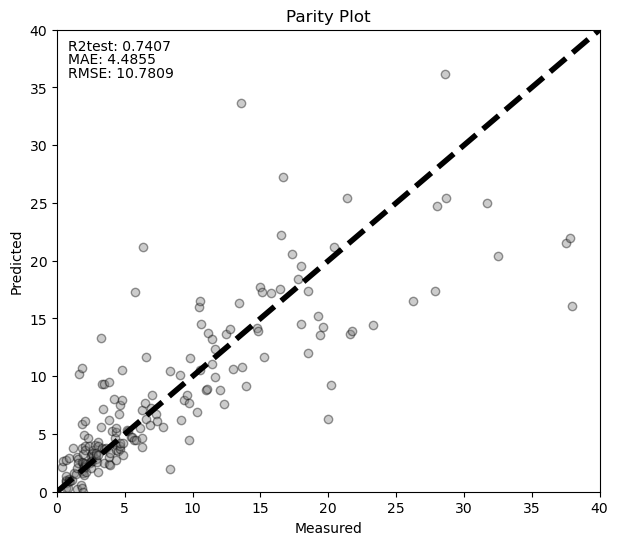

ATMER2CP
Cross validation r2_score 0.6311
Cross validation mean_absolute_error 6.5835
Cross validation mean_squared_error 157.1288


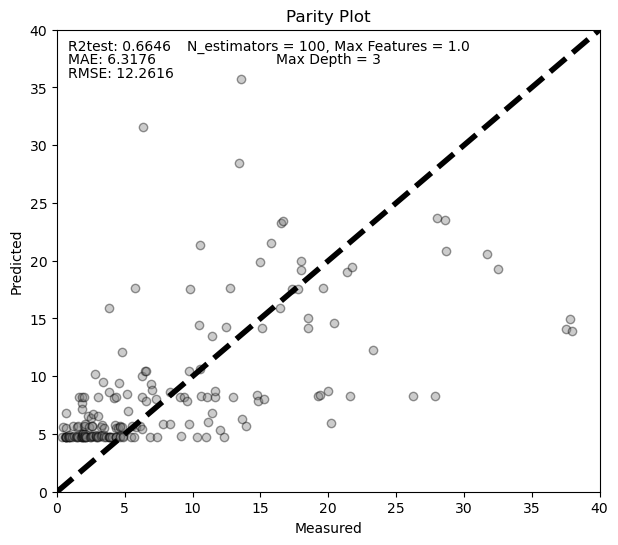

Cross validation r2_score 0.723
Cross validation mean_absolute_error 4.7752
Cross validation mean_squared_error 118.004


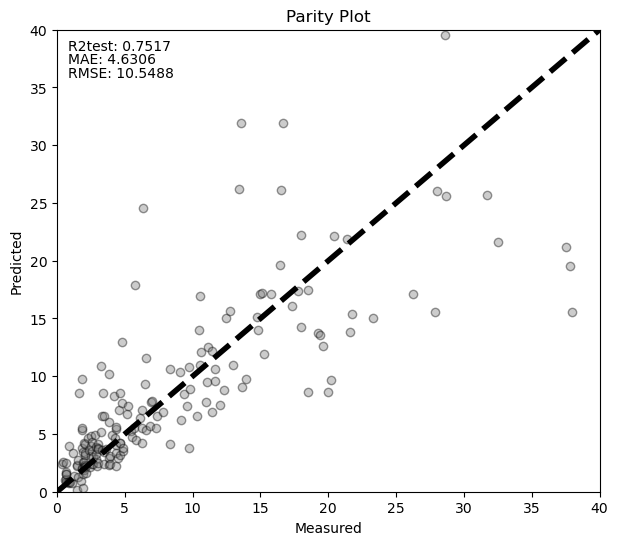

ATMER2CPO
Cross validation r2_score 0.1063
Cross validation mean_absolute_error 10.2302
Cross validation mean_squared_error 380.658


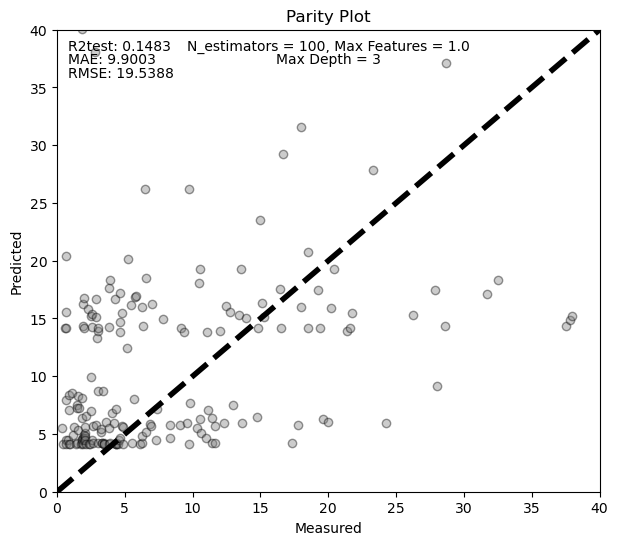

Cross validation r2_score 0.0555
Cross validation mean_absolute_error 10.1678
Cross validation mean_squared_error 402.2975


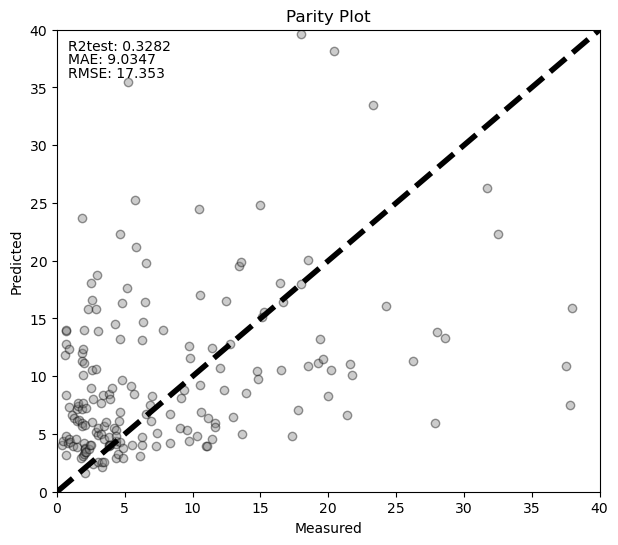

In [328]:
for i in full_list_ML[:-12]:
    for j in ['','CP','CPO']:
        print(i+j)
        ref2.test_rf_model2(kpred['RXtrain'+i+j],kpred['Rytrain'+i],kpred['RXtest'+i+j],kpred['Rytest'+i],kpred['rfrmodel'+i+j],dim=40)
        ref2.test_rf_modelboost2(kpred['RXtrain'+i+j],kpred['Rytrain'+i],kpred['RXtest'+i+j],kpred['Rytest'+i],kpred['gbrmodel'+i+j],dim=40)

ATMERM2
Cross validation r2_score 0.7132
Cross validation mean_absolute_error 4.0202
Cross validation mean_squared_error 65.9243


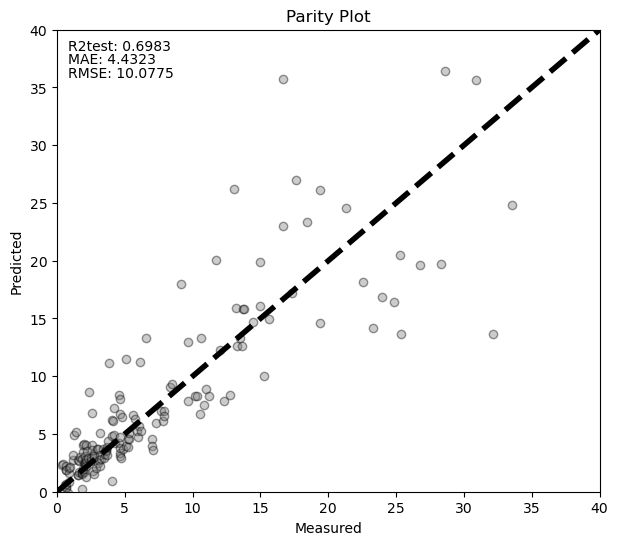

ATMERM2CP
Cross validation r2_score 0.717
Cross validation mean_absolute_error 3.9441
Cross validation mean_squared_error 65.0342


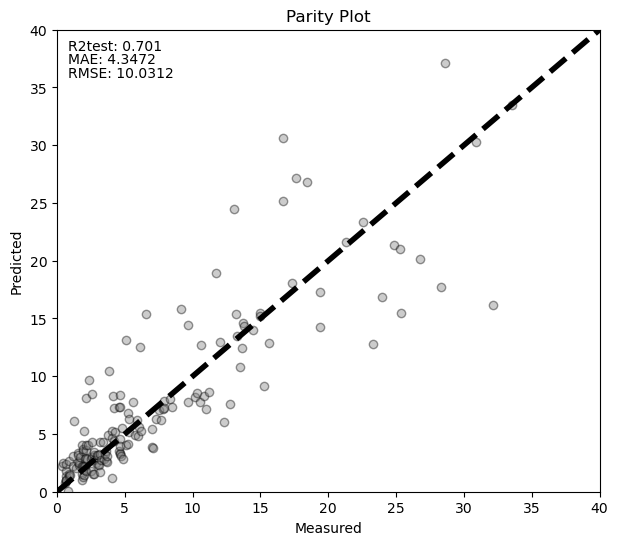

ATMERM2CPO
Cross validation r2_score 0.2358
Cross validation mean_absolute_error 7.6674
Cross validation mean_squared_error 175.6398


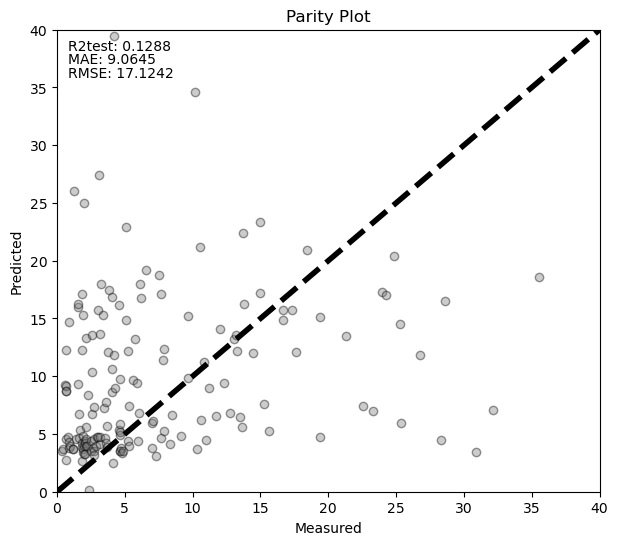

In [329]:
for i in ['ATMERM2']:
    for j in ['','CP','CPO']:
        print(i+j)
        #ref2.test_rf_model2(kpred['RXtrain'+i+j],kpred['Rytrain'+i],kpred['RXtest'+i+j],kpred['Rytest'+i],kpred['rfrmodel'+i+j],dim=40)
        ref2.test_rf_modelboost2(kpred['RXtrain'+i+j],kpred['Rytrain'+i],kpred['RXtest'+i+j],kpred['Rytest'+i],kpred['gbrmodel'+i+j],dim=40)

In [324]:
for i in full_list_ML[-12:]:
    for j in ['','CP','CPO']:
        kpred['rfrmodel'+i+j]=RandomForestRegressor(max_depth=3).fit(kpred['RXtrain'+i+j],kpred['Rytrain'+i])
        kpred['gbrmodel'+i+j]=GradientBoostingRegressor().fit(kpred['RXtrain'+i+j],kpred['Rytrain'+i])

ATMEM
Cross validation r2_score 0.6029
Cross validation mean_absolute_error 4.0017
Cross validation mean_squared_error 54.6879


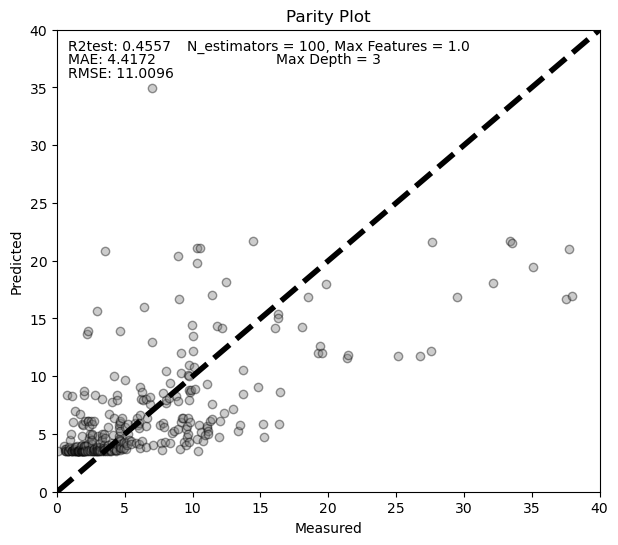

Cross validation r2_score 0.6696
Cross validation mean_absolute_error 2.9636
Cross validation mean_squared_error 45.4994


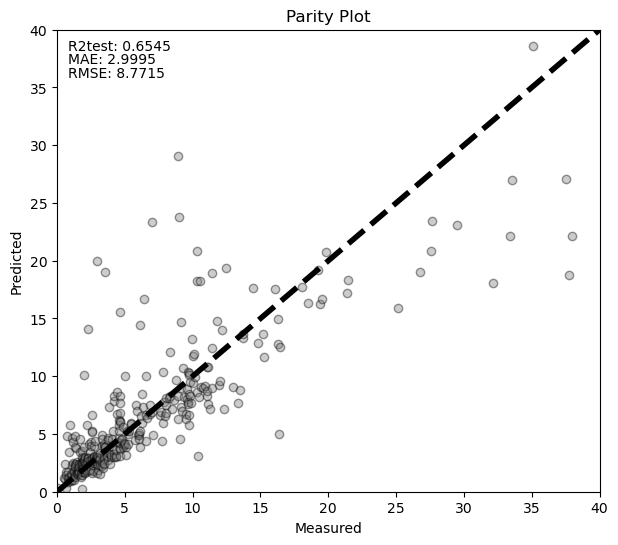

ATMEMCP
Cross validation r2_score 0.6347
Cross validation mean_absolute_error 3.9495
Cross validation mean_squared_error 50.309


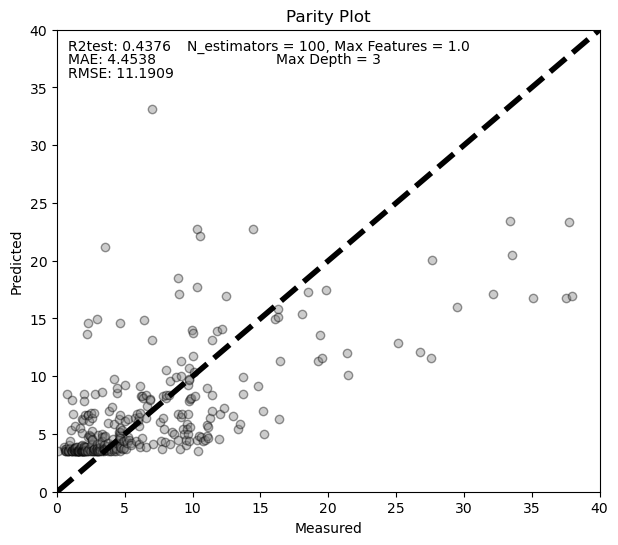

Cross validation r2_score 0.6999
Cross validation mean_absolute_error 2.8935
Cross validation mean_squared_error 41.335


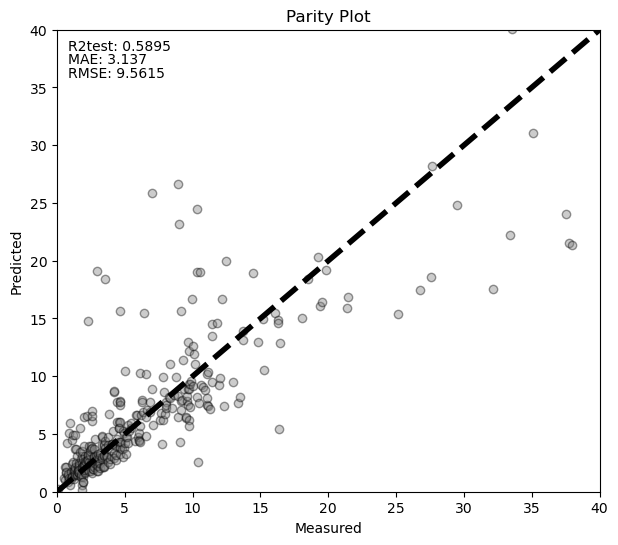

ATMEMCPO
Cross validation r2_score 0.1522
Cross validation mean_absolute_error 6.2095
Cross validation mean_squared_error 116.7608


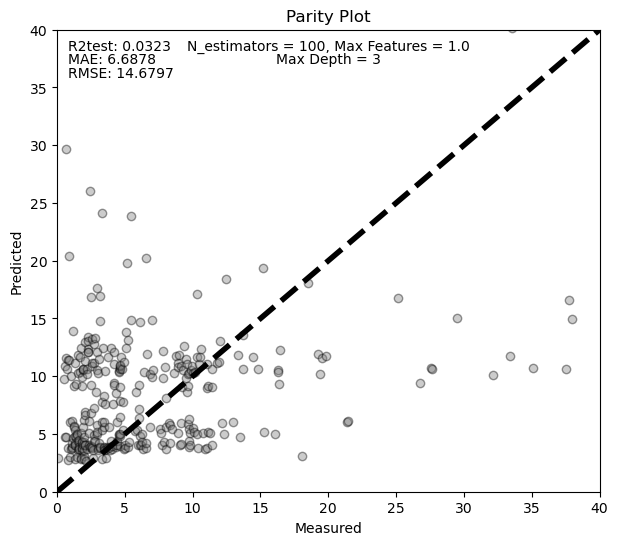

Cross validation r2_score 0.1639
Cross validation mean_absolute_error 6.0464
Cross validation mean_squared_error 115.1506


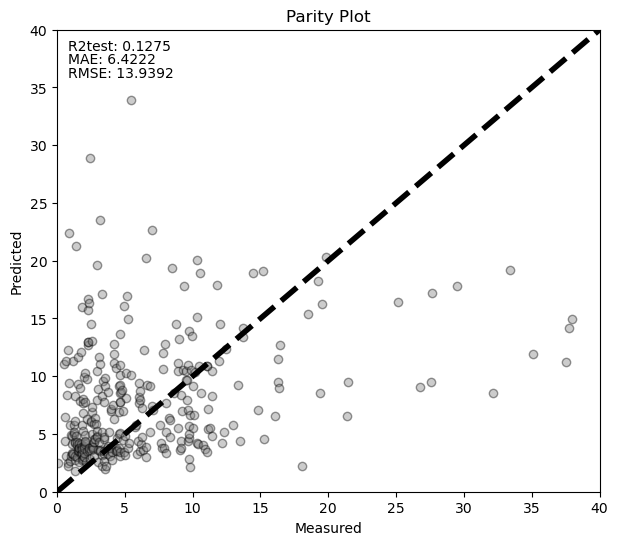

ATMEM2
Cross validation r2_score 0.6633
Cross validation mean_absolute_error 5.2249
Cross validation mean_squared_error 77.3869


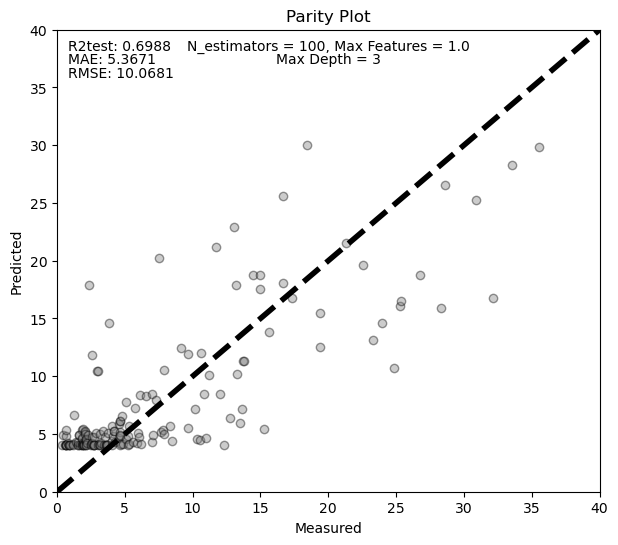

Cross validation r2_score 0.7271
Cross validation mean_absolute_error 3.9003
Cross validation mean_squared_error 62.7291


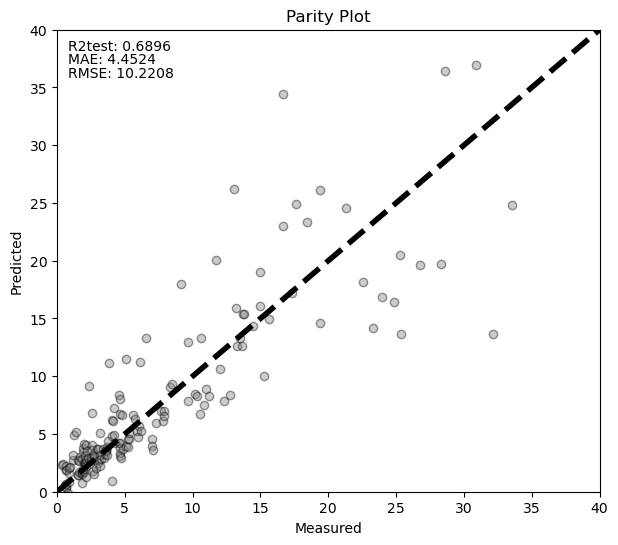

ATMEM2CP
Cross validation r2_score 0.6385
Cross validation mean_absolute_error 5.2626
Cross validation mean_squared_error 83.0789


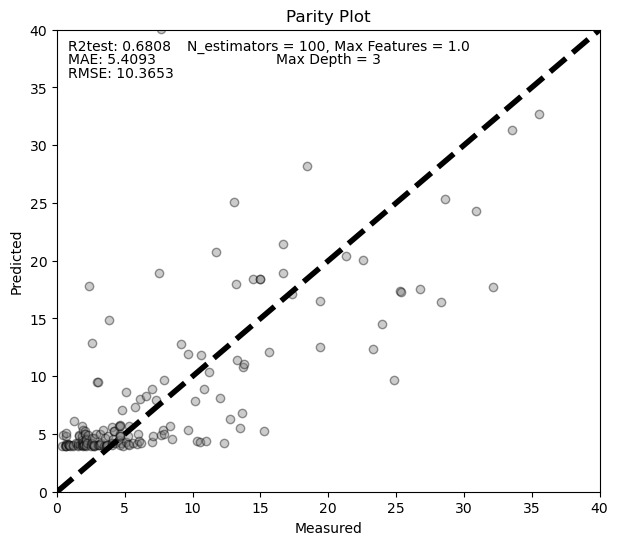

Cross validation r2_score 0.747
Cross validation mean_absolute_error 3.893
Cross validation mean_squared_error 58.1566


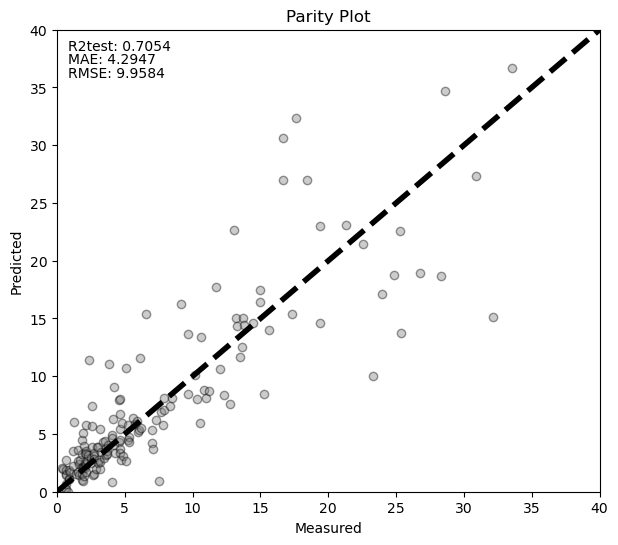

ATMEM2CPO
Cross validation r2_score 0.0905
Cross validation mean_absolute_error 8.3789
Cross validation mean_squared_error 209.027


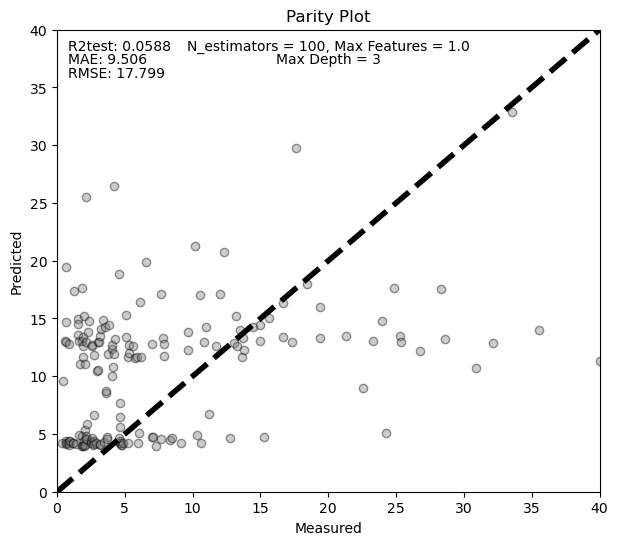

Cross validation r2_score 0.1014
Cross validation mean_absolute_error 8.0651
Cross validation mean_squared_error 206.5245


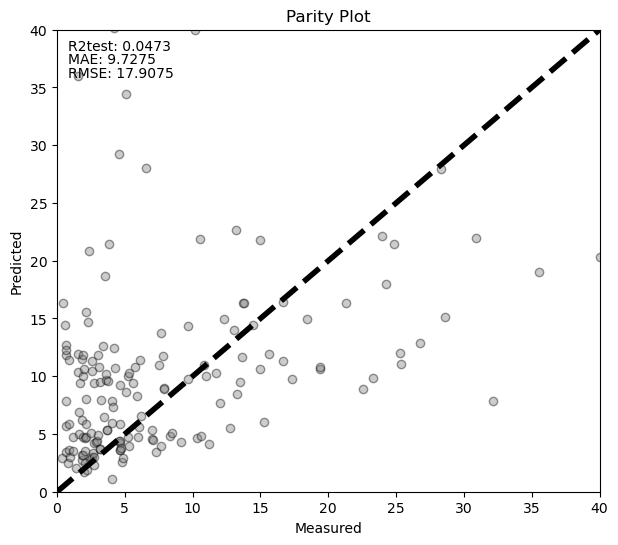

ATMERM
Cross validation r2_score 0.6155
Cross validation mean_absolute_error 3.9755
Cross validation mean_squared_error 52.9522


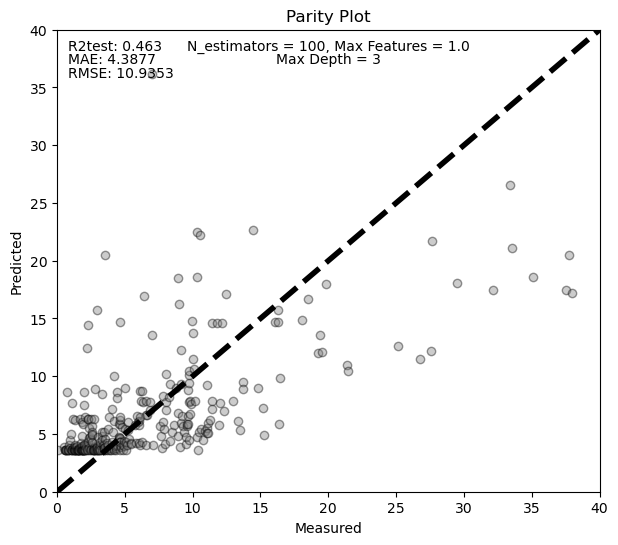

Cross validation r2_score 0.6962
Cross validation mean_absolute_error 2.8458
Cross validation mean_squared_error 41.8365


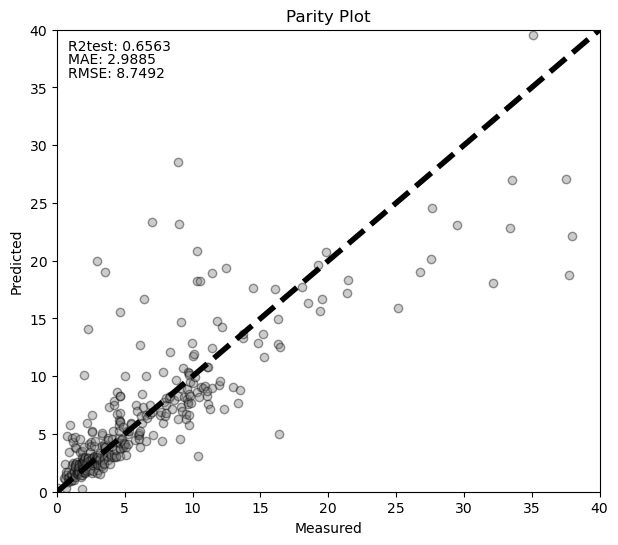

ATMERMCP
Cross validation r2_score 0.6284
Cross validation mean_absolute_error 3.9785
Cross validation mean_squared_error 51.1829


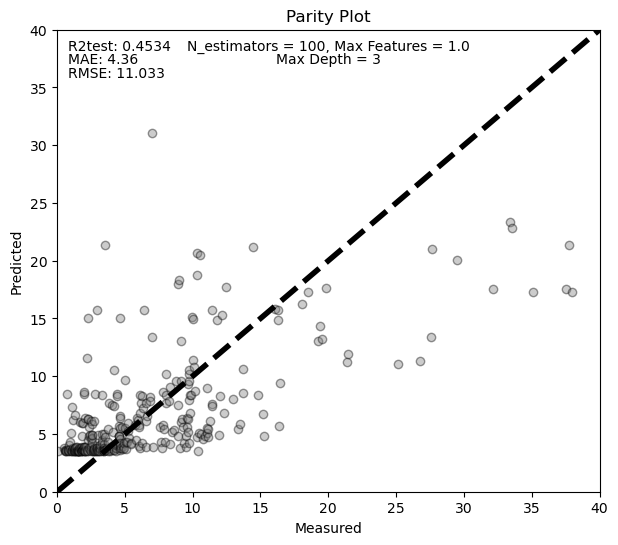

Cross validation r2_score 0.701
Cross validation mean_absolute_error 2.9019
Cross validation mean_squared_error 41.175


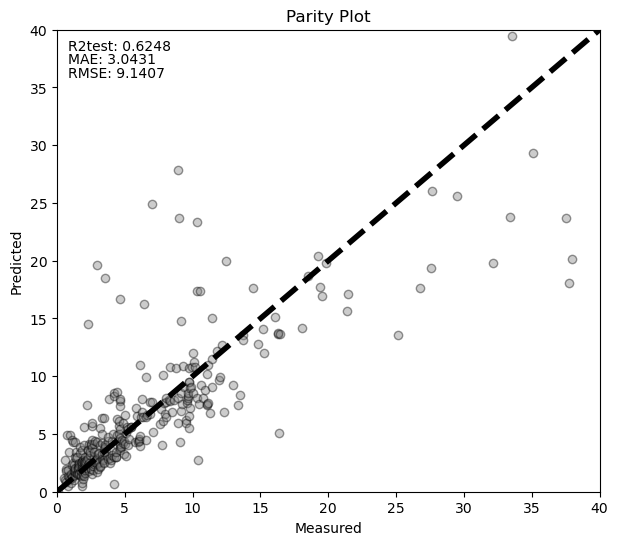

ATMERMCPO
Cross validation r2_score 0.1854
Cross validation mean_absolute_error 5.9911
Cross validation mean_squared_error 112.1904


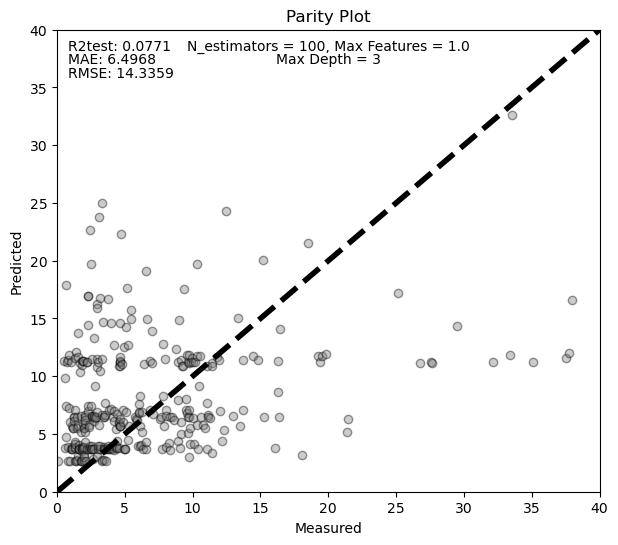

Cross validation r2_score 0.2076
Cross validation mean_absolute_error 5.8548
Cross validation mean_squared_error 109.1256


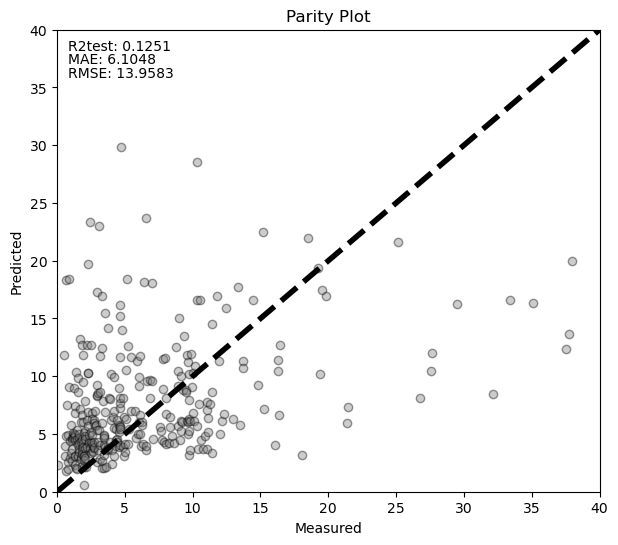

ATMERM2
Cross validation r2_score 0.65
Cross validation mean_absolute_error 5.2174
Cross validation mean_squared_error 80.4507


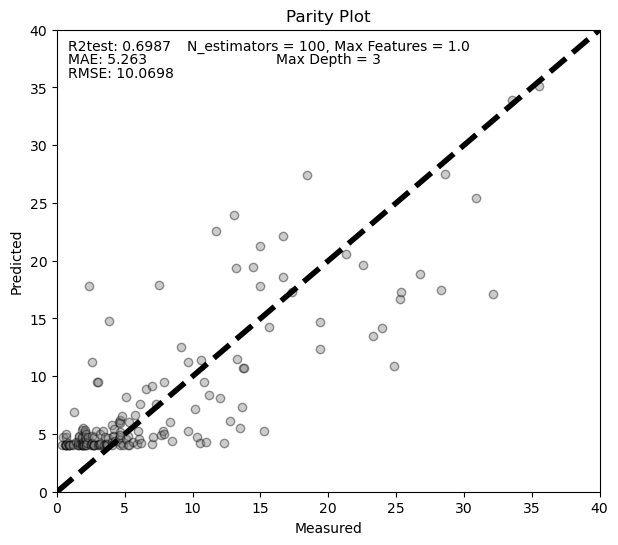

Cross validation r2_score 0.7655
Cross validation mean_absolute_error 3.8078
Cross validation mean_squared_error 53.8895


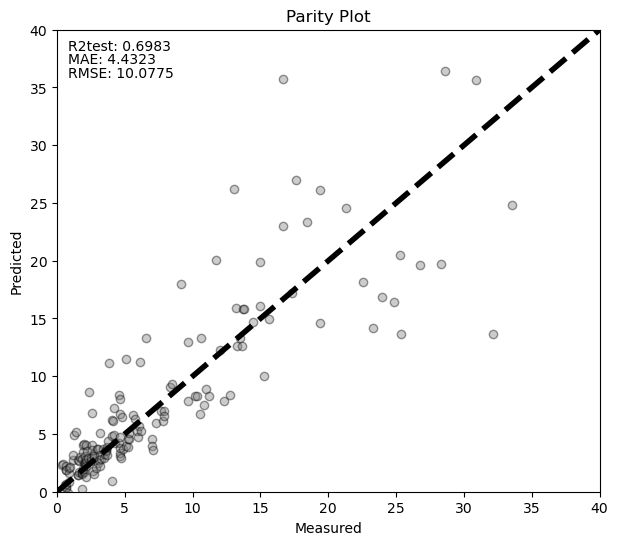

ATMERM2CP
Cross validation r2_score 0.6593
Cross validation mean_absolute_error 5.2412
Cross validation mean_squared_error 78.2986


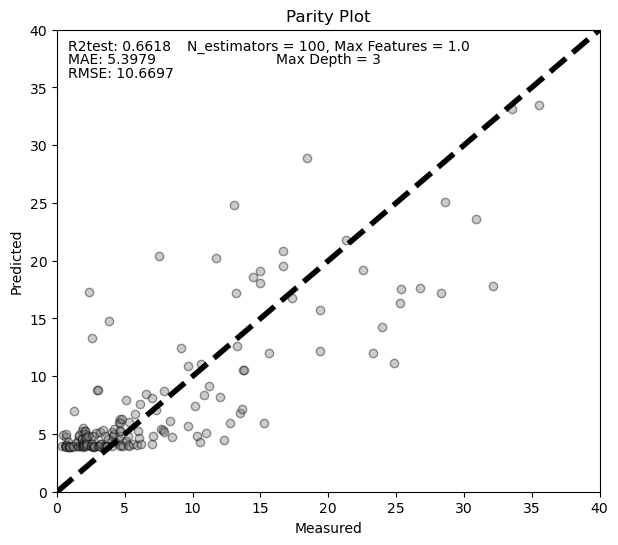

Cross validation r2_score 0.7611
Cross validation mean_absolute_error 3.8808
Cross validation mean_squared_error 54.8995


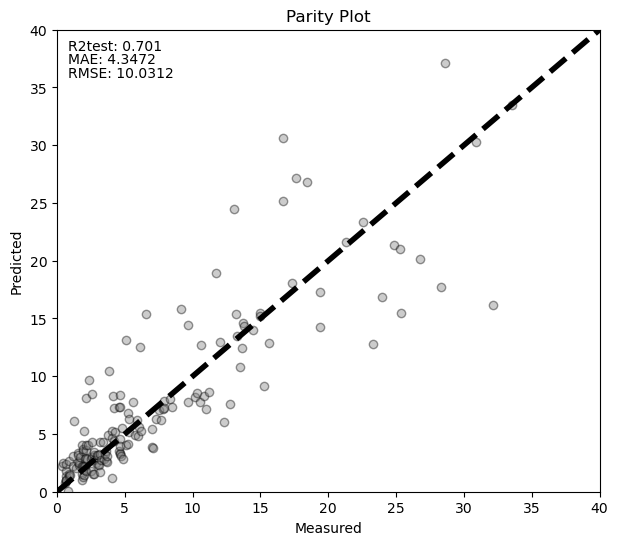

ATMERM2CPO
Cross validation r2_score 0.1491
Cross validation mean_absolute_error 8.0094
Cross validation mean_squared_error 195.5546


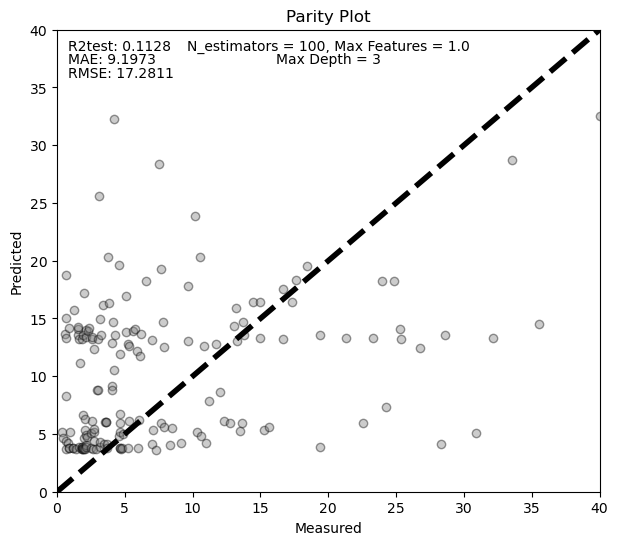

Cross validation r2_score 0.1962
Cross validation mean_absolute_error 7.6312
Cross validation mean_squared_error 184.7334


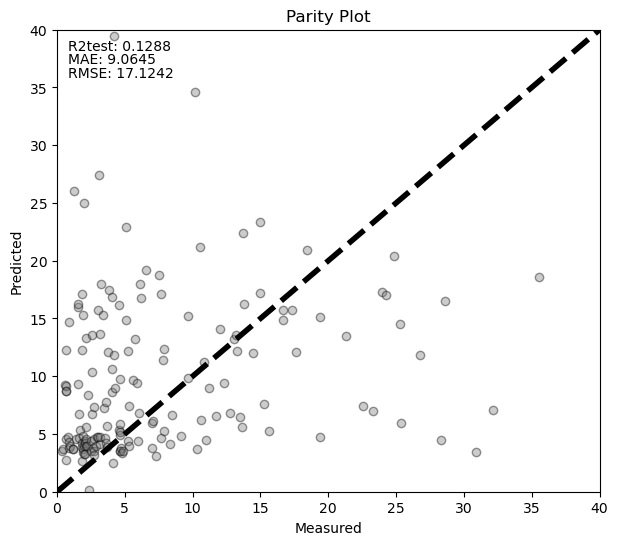

ATMEI
Cross validation r2_score 0.7158
Cross validation mean_absolute_error 11.9438
Cross validation mean_squared_error 520.3492


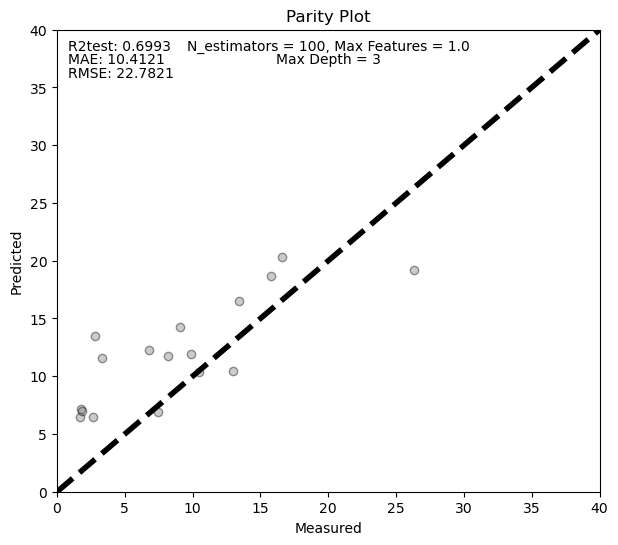

Cross validation r2_score 0.8614
Cross validation mean_absolute_error 8.4169
Cross validation mean_squared_error 253.753


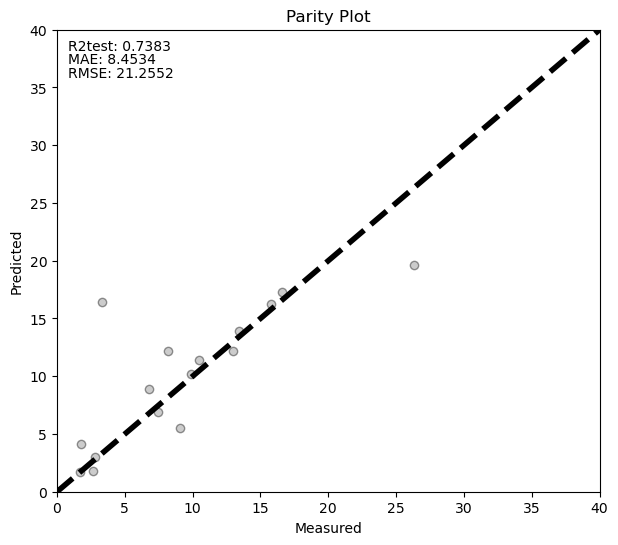

ATMEICP
Cross validation r2_score 0.5526
Cross validation mean_absolute_error 14.0174
Cross validation mean_squared_error 819.1696


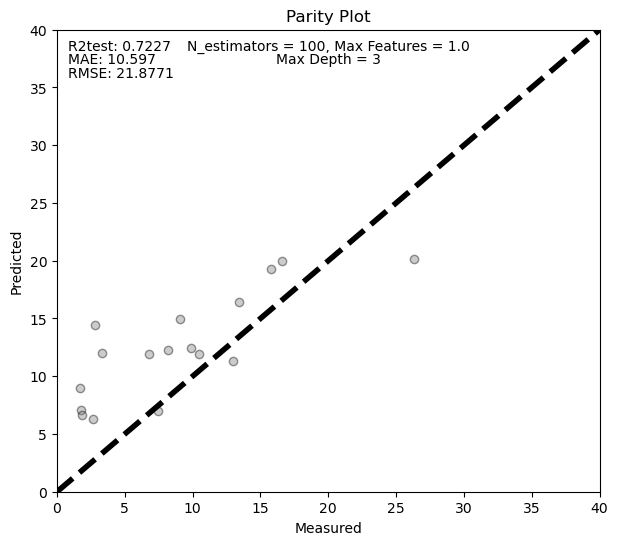

Cross validation r2_score 0.5076
Cross validation mean_absolute_error 13.3801
Cross validation mean_squared_error 901.5751


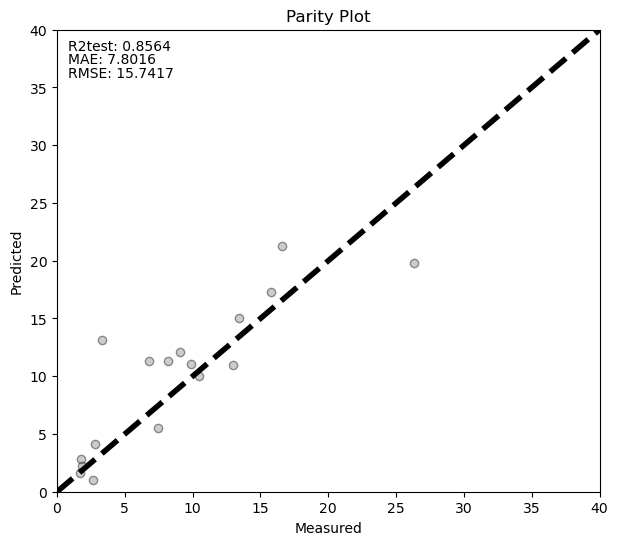

ATMEICPO
Cross validation r2_score 0.0909
Cross validation mean_absolute_error 23.3838
Cross validation mean_squared_error 1664.3637


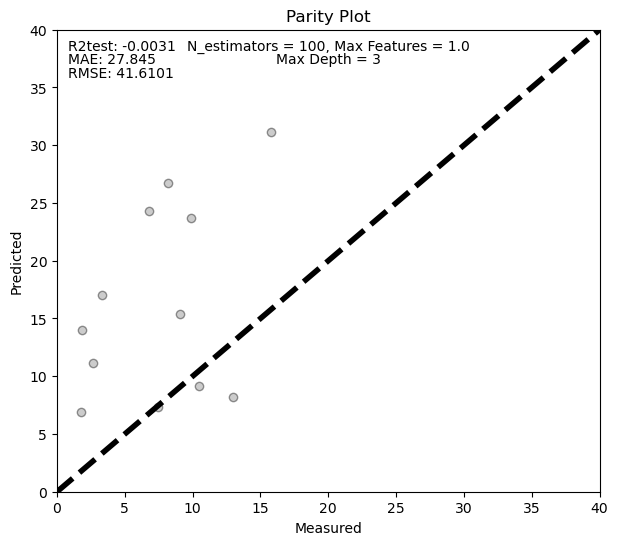

Cross validation r2_score 0.2506
Cross validation mean_absolute_error 21.9151
Cross validation mean_squared_error 1371.9702


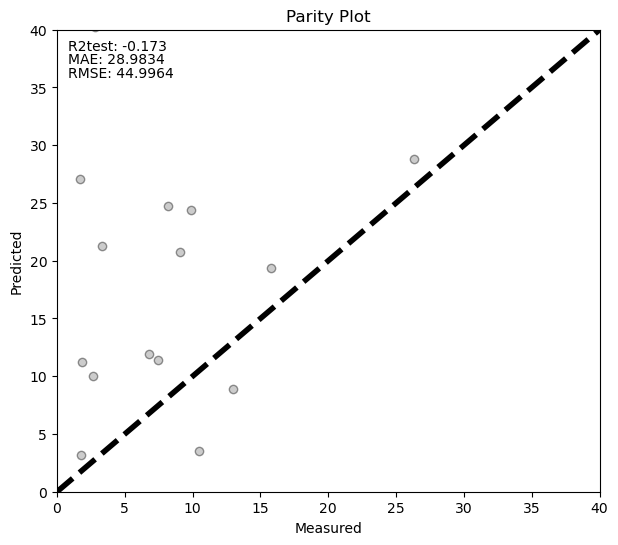

ATMEI2
Cross validation r2_score 0.529
Cross validation mean_absolute_error 16.9266
Cross validation mean_squared_error 947.9208


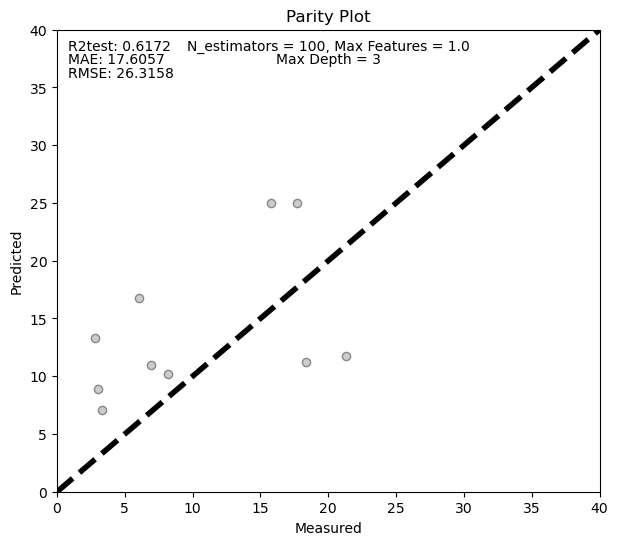

Cross validation r2_score 0.5751
Cross validation mean_absolute_error 14.21
Cross validation mean_squared_error 855.1914


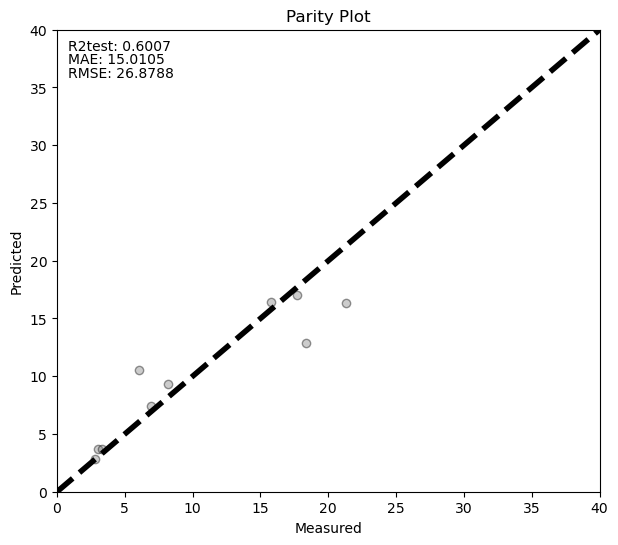

ATMEI2CP
Cross validation r2_score 0.4463
Cross validation mean_absolute_error 17.674
Cross validation mean_squared_error 1114.2883


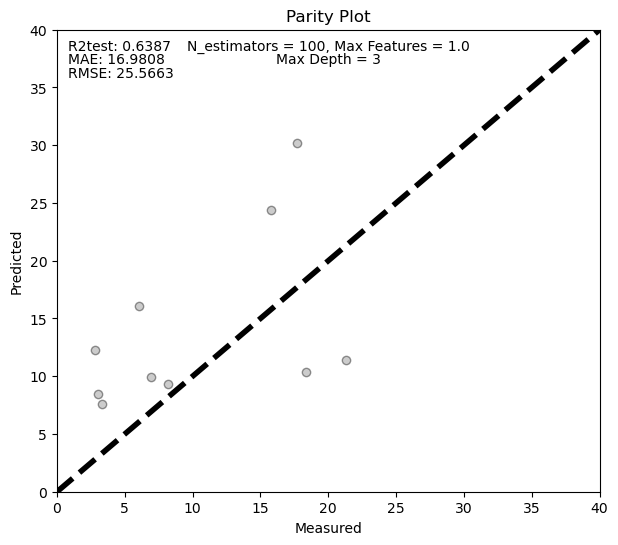

Cross validation r2_score 0.4688
Cross validation mean_absolute_error 15.6552
Cross validation mean_squared_error 1069.0268


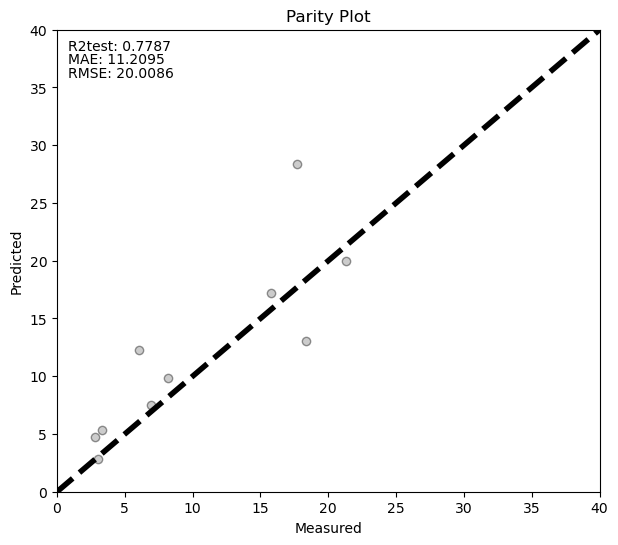

ATMEI2CPO
Cross validation r2_score -0.0967
Cross validation mean_absolute_error 28.7035
Cross validation mean_squared_error 2207.2211


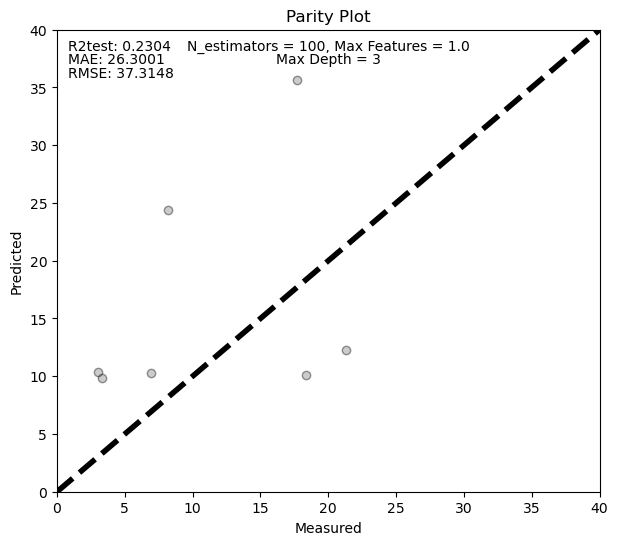

Cross validation r2_score -0.2963
Cross validation mean_absolute_error 28.4603
Cross validation mean_squared_error 2608.8758


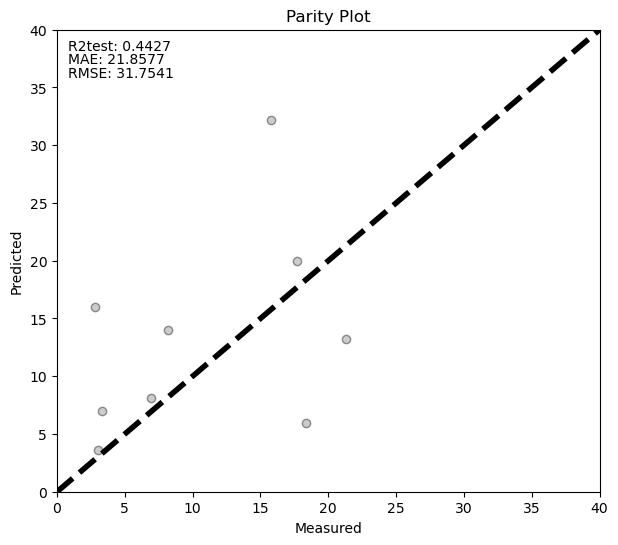

ATMERI
Cross validation r2_score 0.7625
Cross validation mean_absolute_error 11.7603
Cross validation mean_squared_error 434.7453


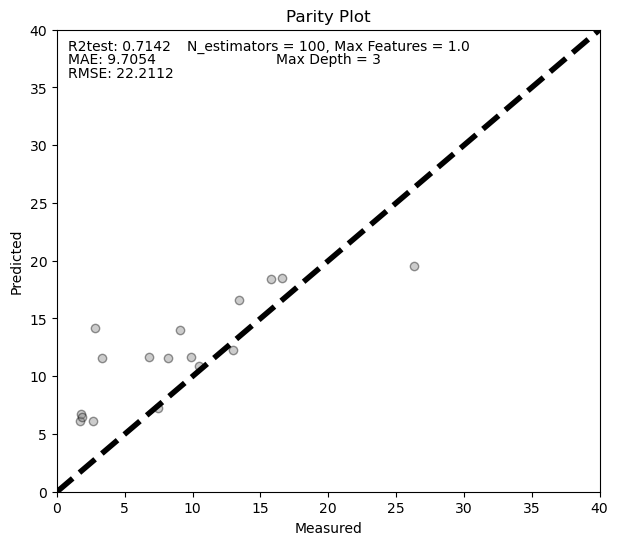

Cross validation r2_score 0.5188
Cross validation mean_absolute_error 12.0877
Cross validation mean_squared_error 881.0373


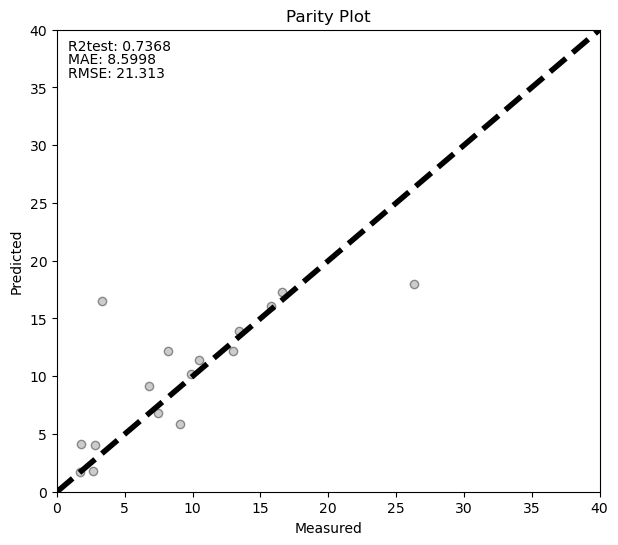

ATMERICP
Cross validation r2_score 0.7083
Cross validation mean_absolute_error 11.8551
Cross validation mean_squared_error 534.014


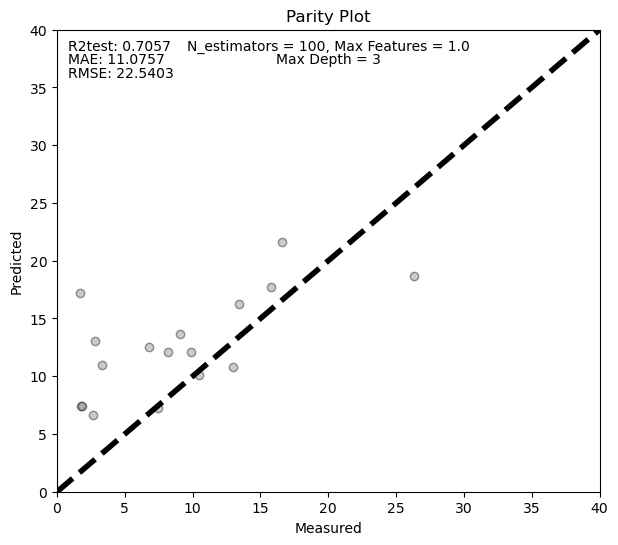

Cross validation r2_score 0.5982
Cross validation mean_absolute_error 11.4316
Cross validation mean_squared_error 735.5369


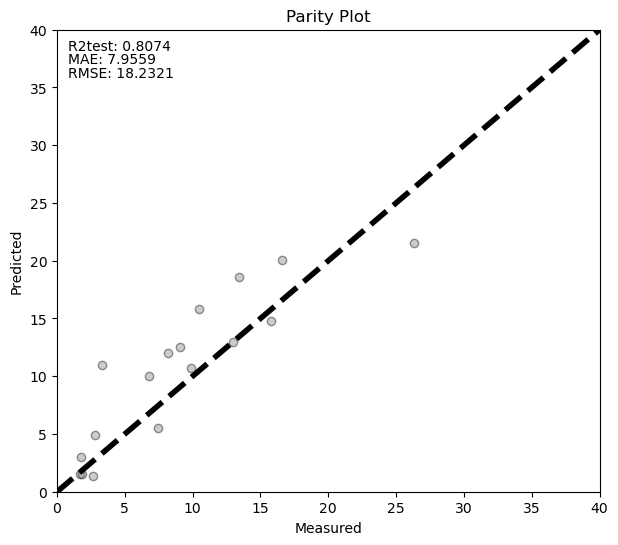

ATMERICPO
Cross validation r2_score 0.1627
Cross validation mean_absolute_error 21.5368
Cross validation mean_squared_error 1532.9475


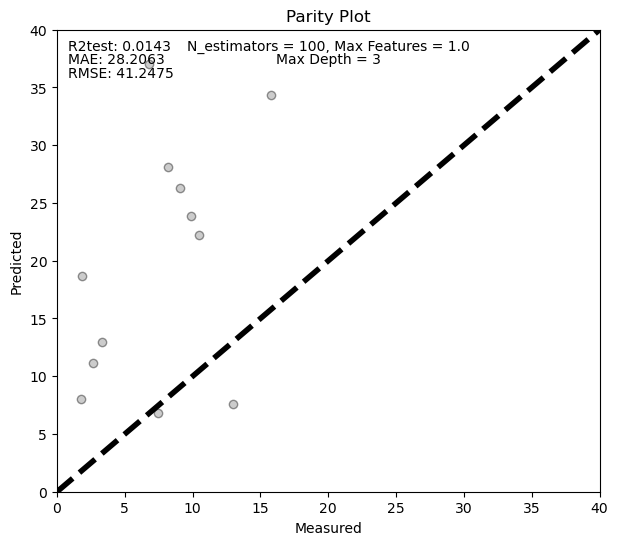

Cross validation r2_score -0.0047
Cross validation mean_absolute_error 23.0062
Cross validation mean_squared_error 1839.4622


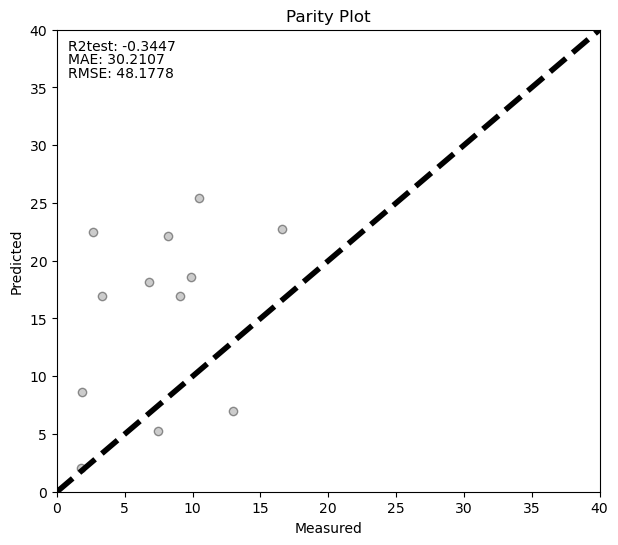

ATMERI2
Cross validation r2_score 0.605
Cross validation mean_absolute_error 15.3378
Cross validation mean_squared_error 794.8913


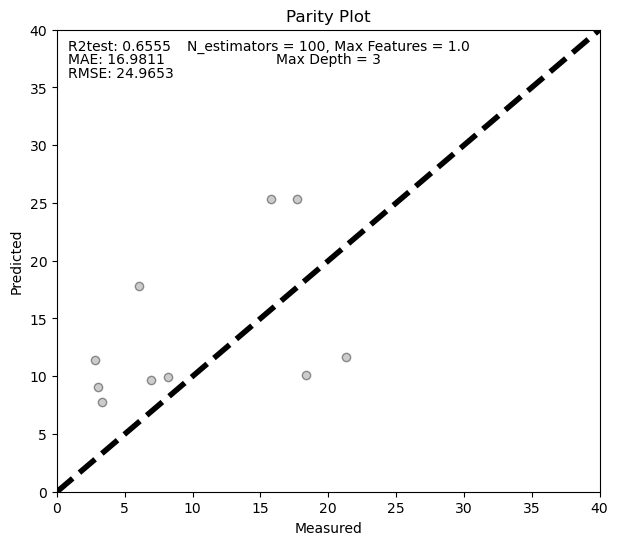

Cross validation r2_score 0.6382
Cross validation mean_absolute_error 12.9776
Cross validation mean_squared_error 728.1396


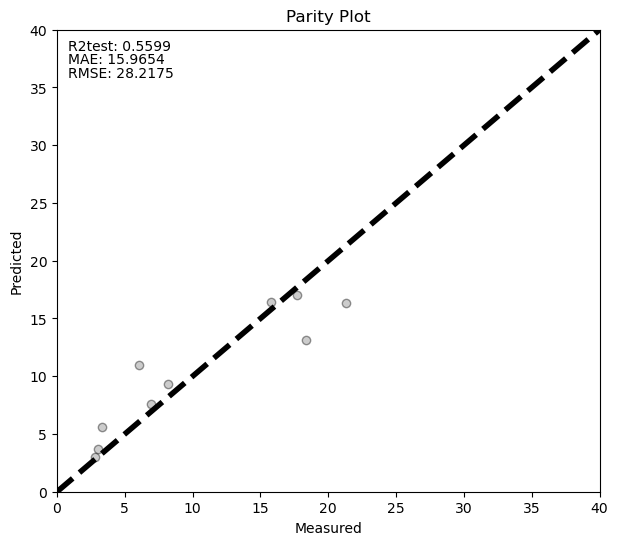

ATMERI2CP
Cross validation r2_score 0.4838
Cross validation mean_absolute_error 17.0165
Cross validation mean_squared_error 1038.8797


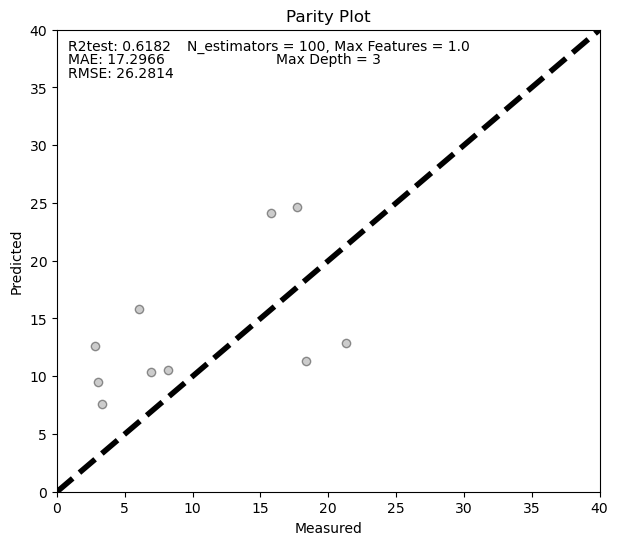

Cross validation r2_score 0.5
Cross validation mean_absolute_error 14.8968
Cross validation mean_squared_error 1006.2591


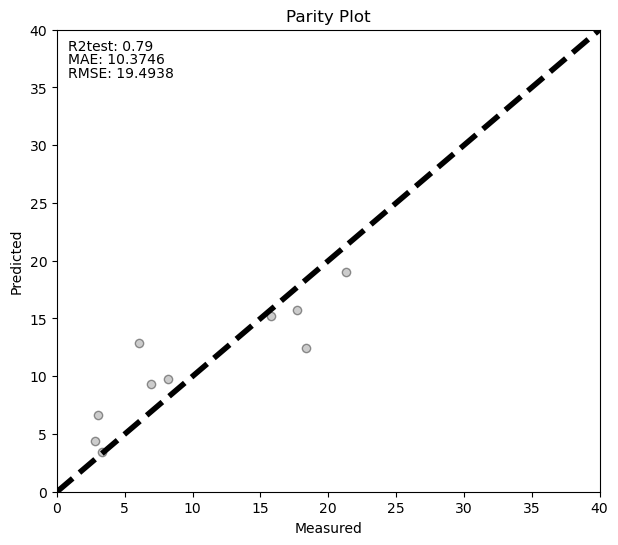

ATMERI2CPO
Cross validation r2_score -0.0237
Cross validation mean_absolute_error 25.9432
Cross validation mean_squared_error 2060.3089


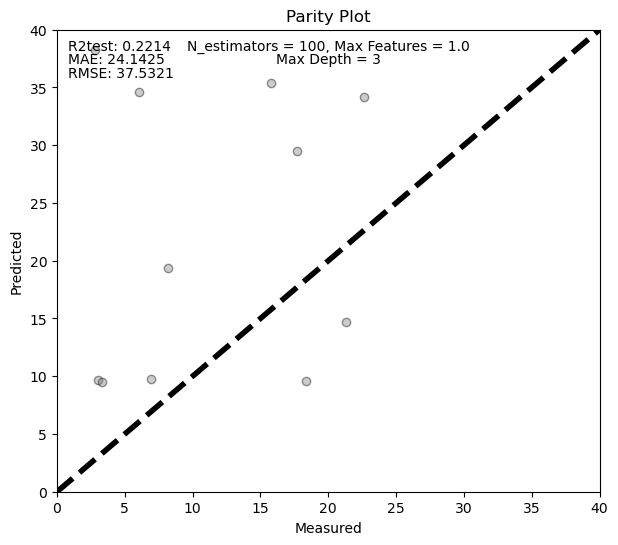

Cross validation r2_score -0.2789
Cross validation mean_absolute_error 30.2505
Cross validation mean_squared_error 2573.8534


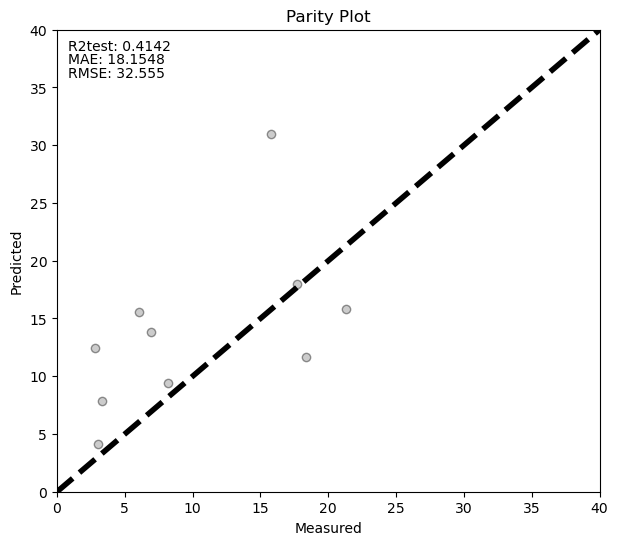

ATMES
Cross validation r2_score 0.4352
Cross validation mean_absolute_error 4.0466
Cross validation mean_squared_error 43.9443


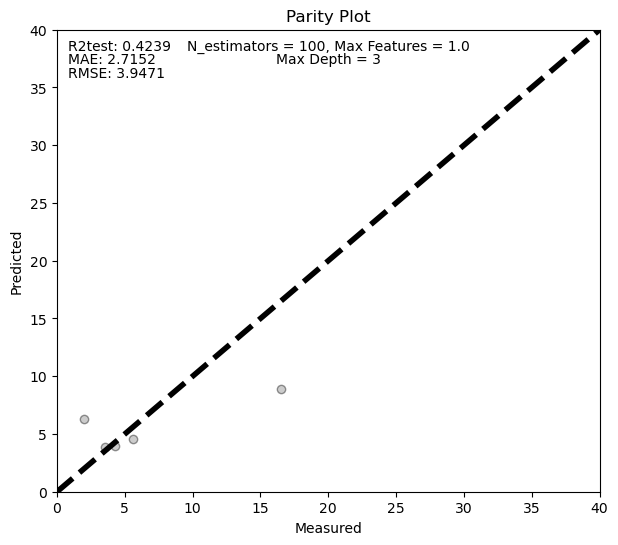

Cross validation r2_score 0.158
Cross validation mean_absolute_error 4.5782
Cross validation mean_squared_error 65.508


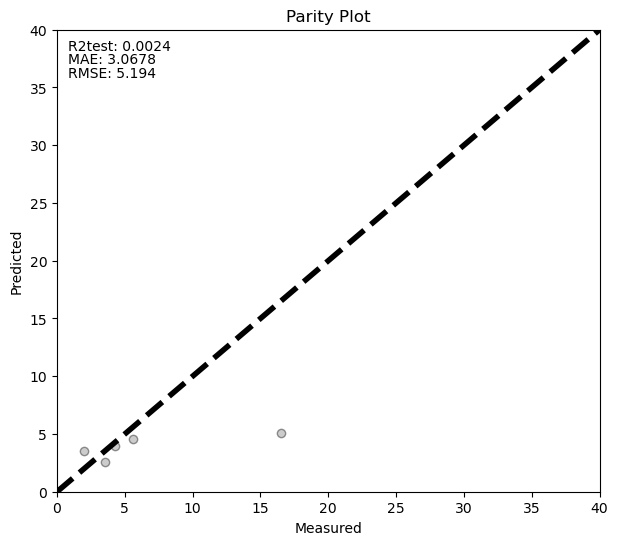

ATMESCP
Cross validation r2_score 0.4234
Cross validation mean_absolute_error 3.9854
Cross validation mean_squared_error 44.8624


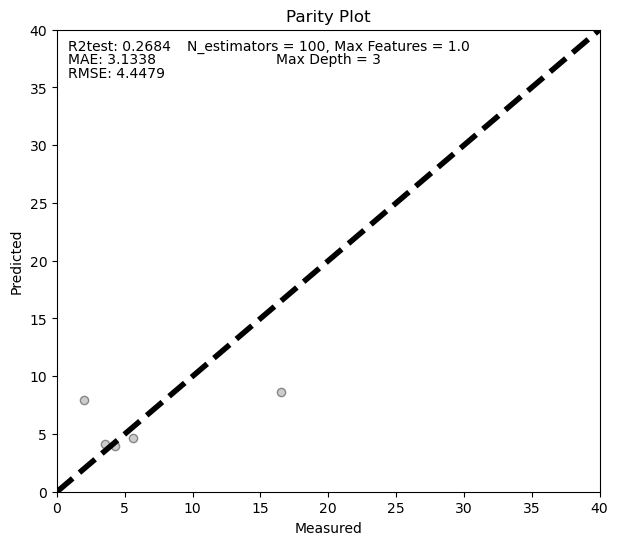

Cross validation r2_score 0.0469
Cross validation mean_absolute_error 5.0575
Cross validation mean_squared_error 74.1496


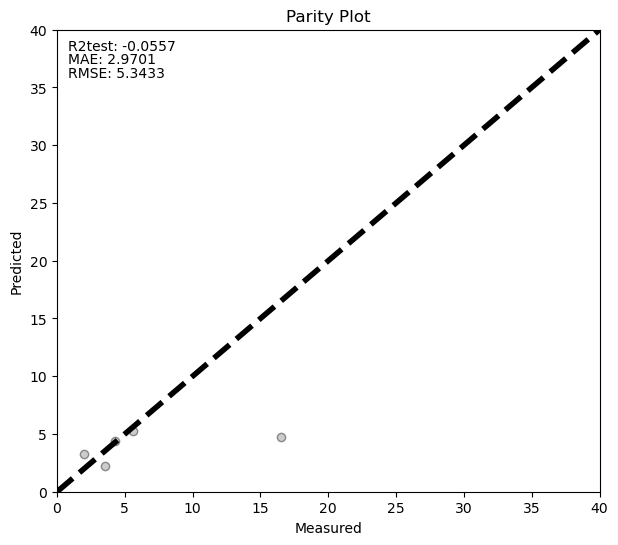

ATMESCPO
Cross validation r2_score -0.1048
Cross validation mean_absolute_error 6.8664
Cross validation mean_squared_error 85.9518


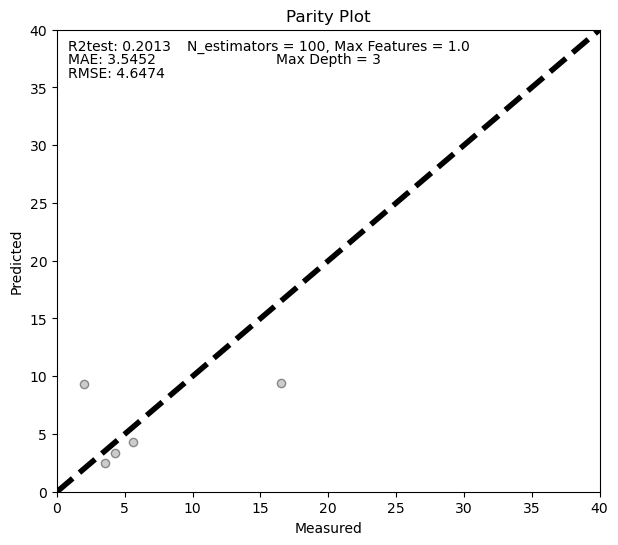

Cross validation r2_score -0.5315
Cross validation mean_absolute_error 7.5435
Cross validation mean_squared_error 119.1536


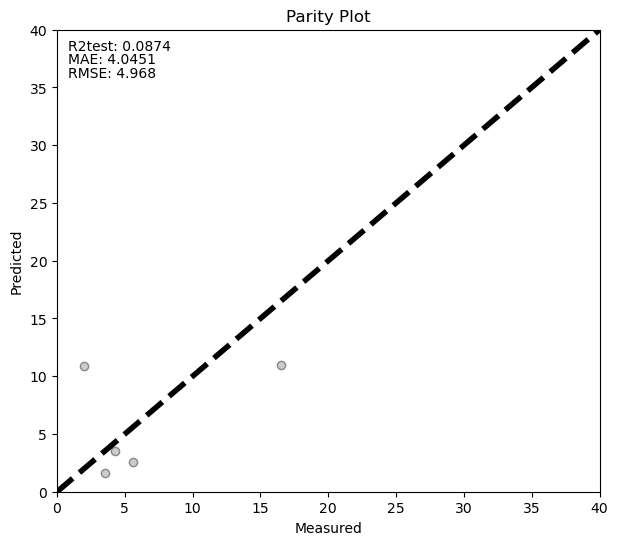

ATMES2
Cross validation r2_score 0.2516
Cross validation mean_absolute_error 6.1418
Cross validation mean_squared_error 56.3489


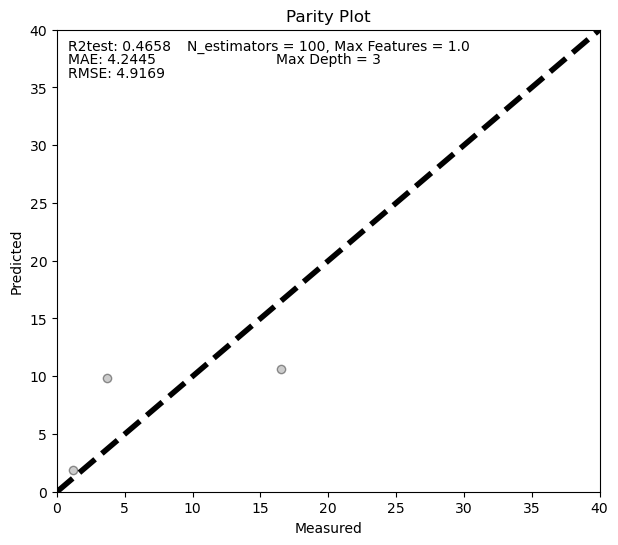

Cross validation r2_score 0.1912
Cross validation mean_absolute_error 6.6144
Cross validation mean_squared_error 60.8952


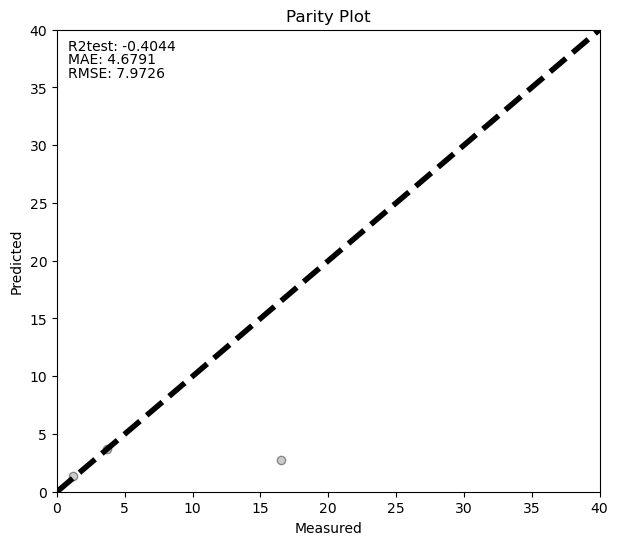

ATMES2CP
Cross validation r2_score 0.1943
Cross validation mean_absolute_error 6.3405
Cross validation mean_squared_error 60.6623


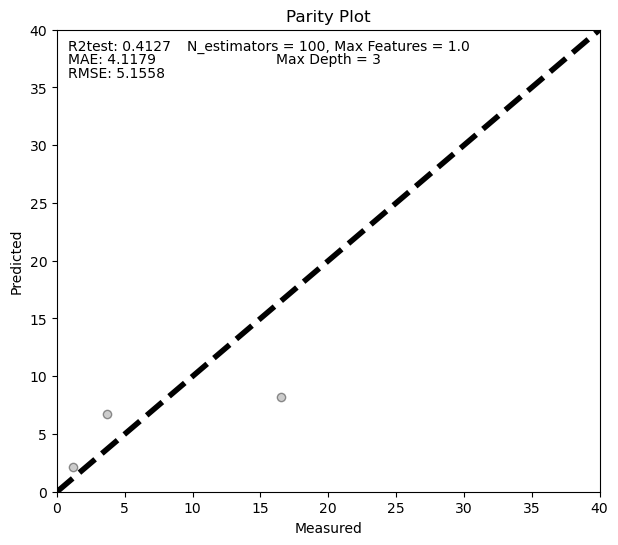

Cross validation r2_score -0.2849
Cross validation mean_absolute_error 8.5038
Cross validation mean_squared_error 96.7449


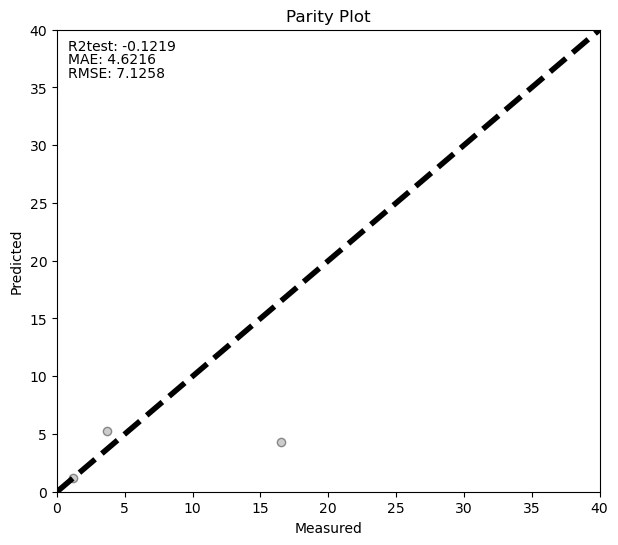

ATMES2CPO
Cross validation r2_score -0.3206
Cross validation mean_absolute_error 8.4631
Cross validation mean_squared_error 99.4296


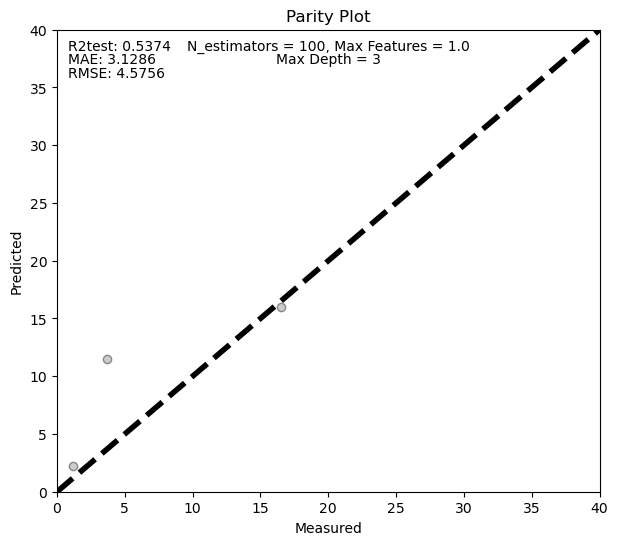

Cross validation r2_score -1.7846
Cross validation mean_absolute_error 12.3658
Cross validation mean_squared_error 209.6564


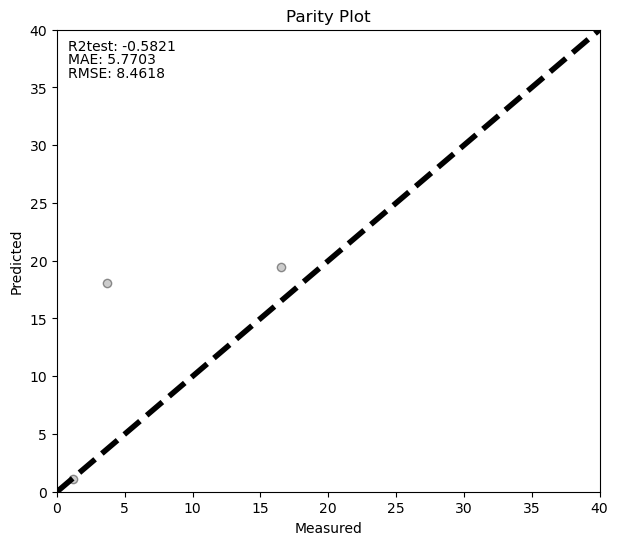

ATMERS
Cross validation r2_score 0.4514
Cross validation mean_absolute_error 3.9707
Cross validation mean_squared_error 42.6773


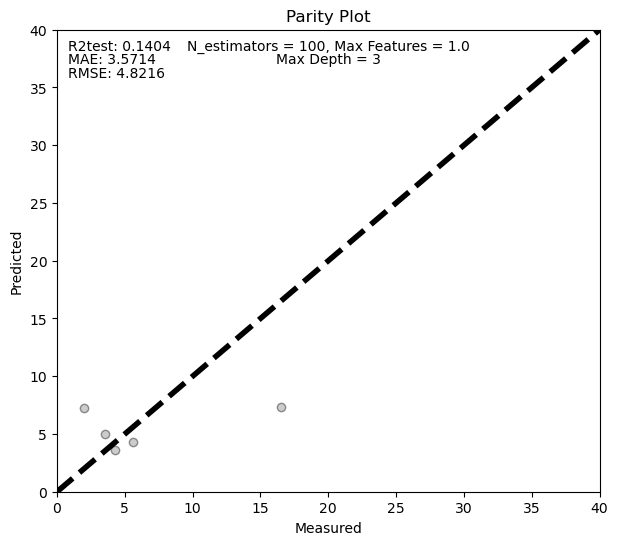

Cross validation r2_score 0.1315
Cross validation mean_absolute_error 5.0294
Cross validation mean_squared_error 67.5732


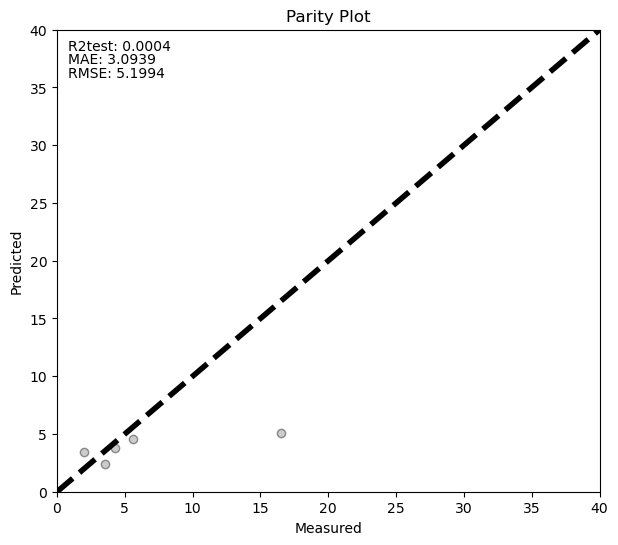

ATMERSCP
Cross validation r2_score 0.4257
Cross validation mean_absolute_error 4.1924
Cross validation mean_squared_error 44.6801


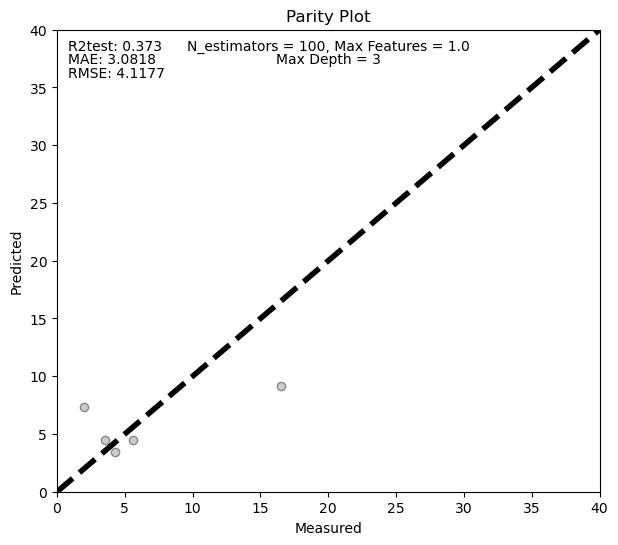

Cross validation r2_score 0.1238
Cross validation mean_absolute_error 4.6972
Cross validation mean_squared_error 68.1687


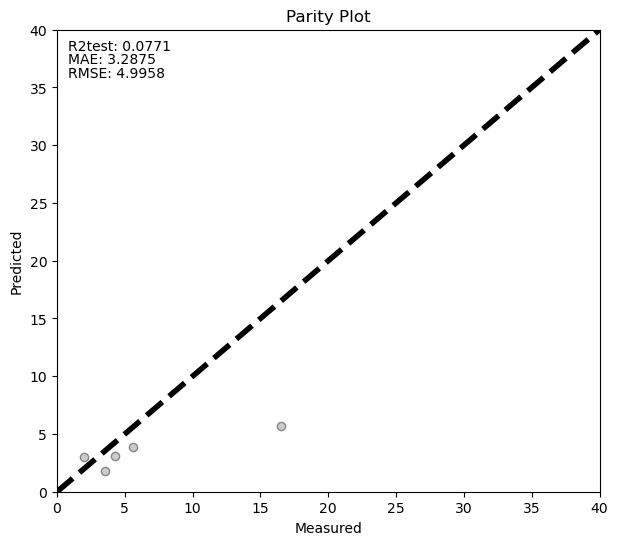

ATMERSCPO
Cross validation r2_score -0.1672
Cross validation mean_absolute_error 6.8581
Cross validation mean_squared_error 90.8111


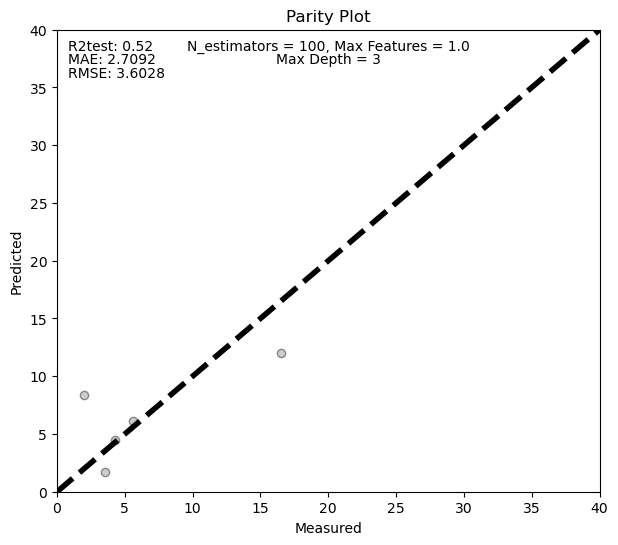

Cross validation r2_score -0.9129
Cross validation mean_absolute_error 8.3525
Cross validation mean_squared_error 148.8236


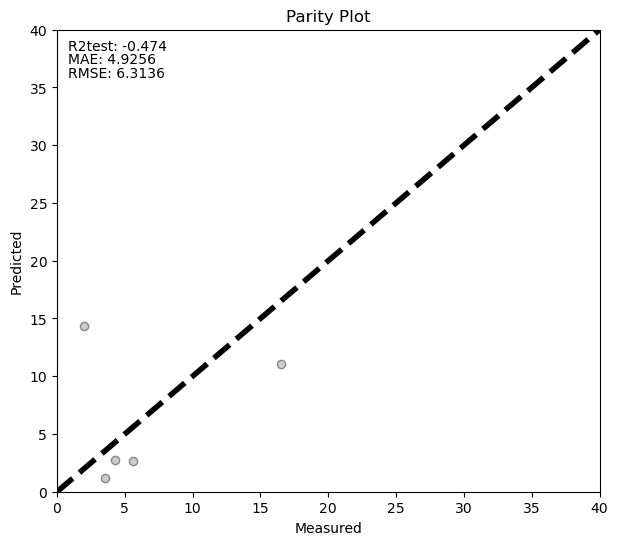

ATMERS2
Cross validation r2_score 0.3421
Cross validation mean_absolute_error 5.9015
Cross validation mean_squared_error 49.5345


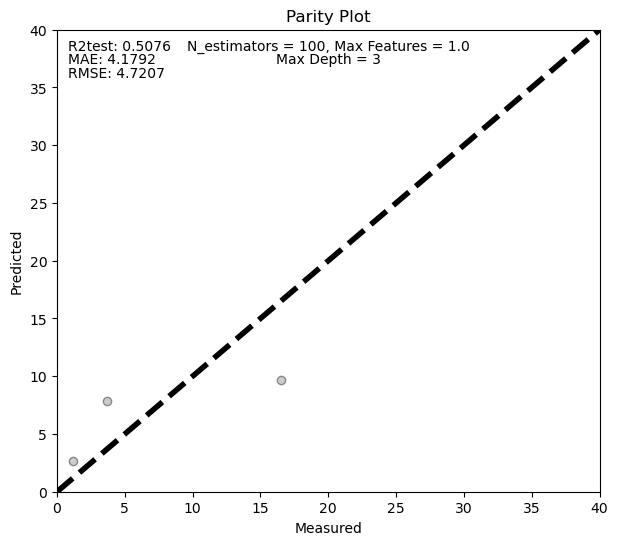

Cross validation r2_score -0.1034
Cross validation mean_absolute_error 7.581
Cross validation mean_squared_error 83.0741


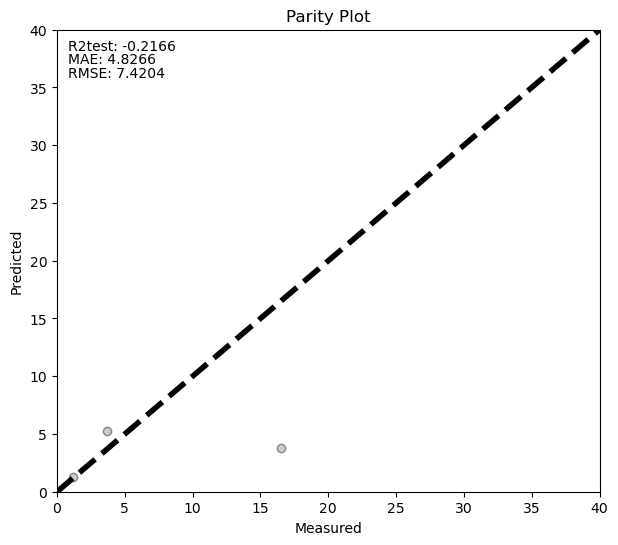

ATMERS2CP
Cross validation r2_score 0.2469
Cross validation mean_absolute_error 6.2632
Cross validation mean_squared_error 56.705


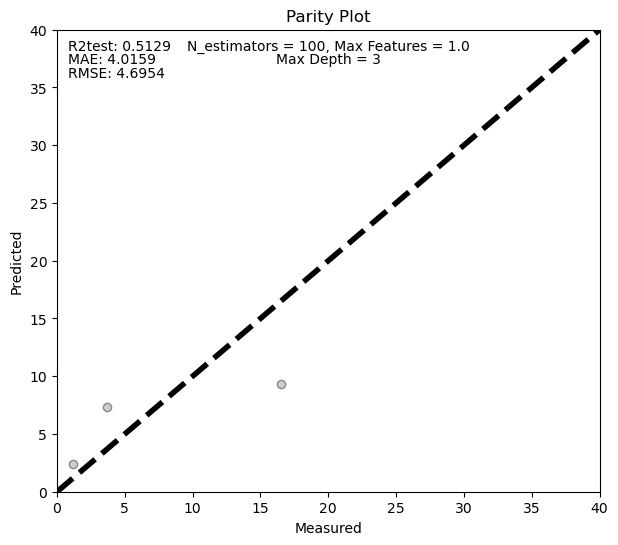

Cross validation r2_score -0.1671
Cross validation mean_absolute_error 8.0068
Cross validation mean_squared_error 87.8704


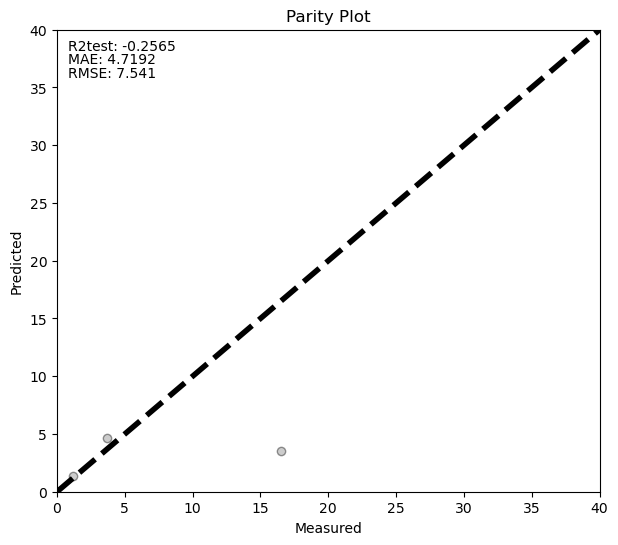

ATMERS2CPO
Cross validation r2_score -0.2033
Cross validation mean_absolute_error 7.9424
Cross validation mean_squared_error 90.5976


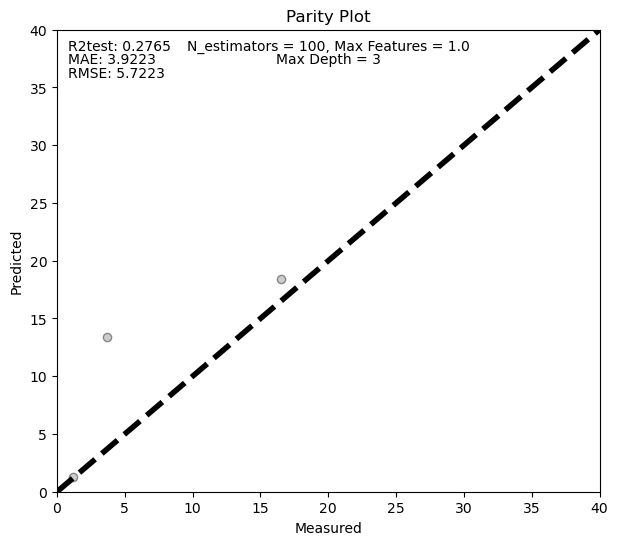

Cross validation r2_score -1.6012
Cross validation mean_absolute_error 11.9852
Cross validation mean_squared_error 195.8494


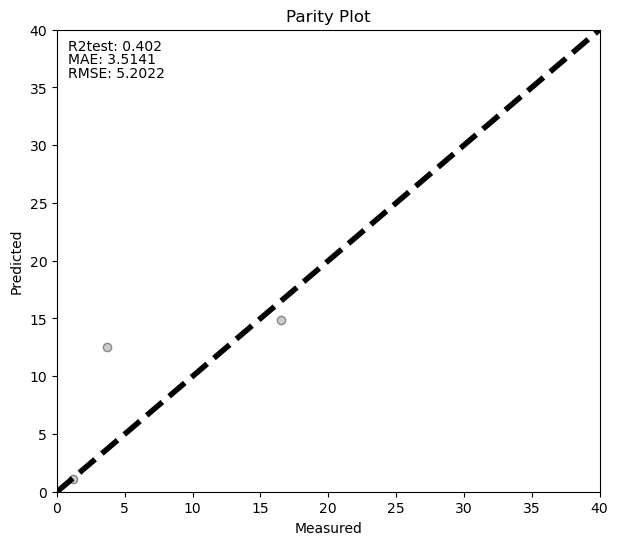

In [325]:
for i in full_list_ML[-12:]:
    for j in ['','CP','CPO']:
        print(i+j)
        ref2.test_rf_model2(kpred['RXtrain'+i+j],kpred['Rytrain'+i],kpred['RXtest'+i+j],kpred['Rytest'+i],kpred['rfrmodel'+i+j],dim=40)
        ref2.test_rf_modelboost2(kpred['RXtrain'+i+j],kpred['Rytrain'+i],kpred['RXtest'+i+j],kpred['Rytest'+i],kpred['gbrmodel'+i+j],dim=40)

ATMEM


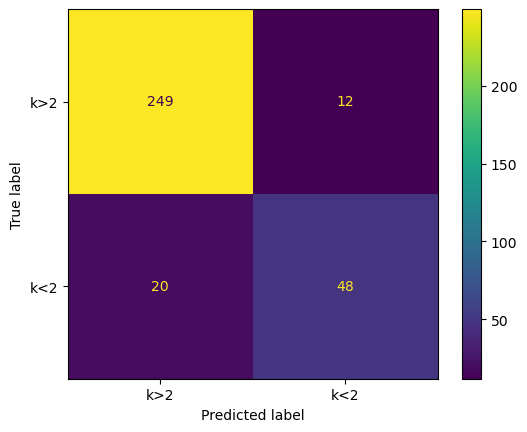

Accuracy:  0.903
Precision:  0.8
Recall:  0.706


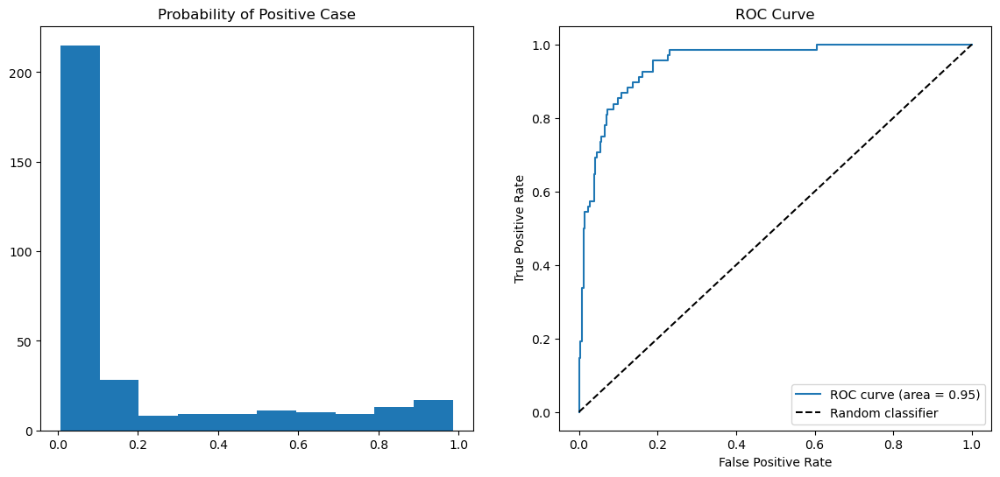

ATMEMCP


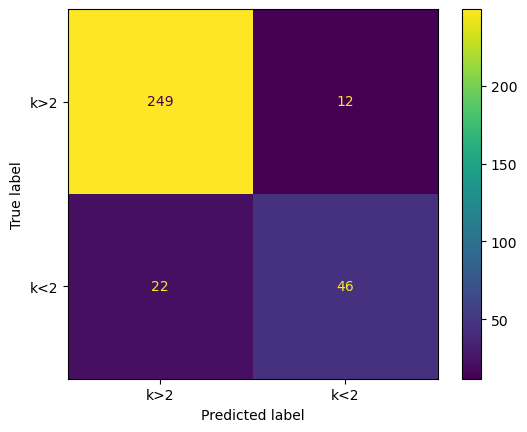

Accuracy:  0.897
Precision:  0.793
Recall:  0.676


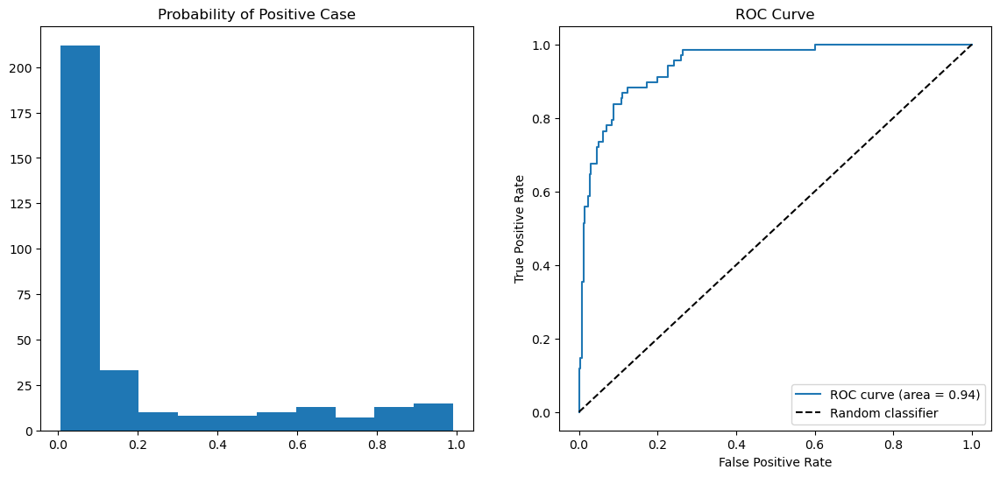

ATMEMCPO


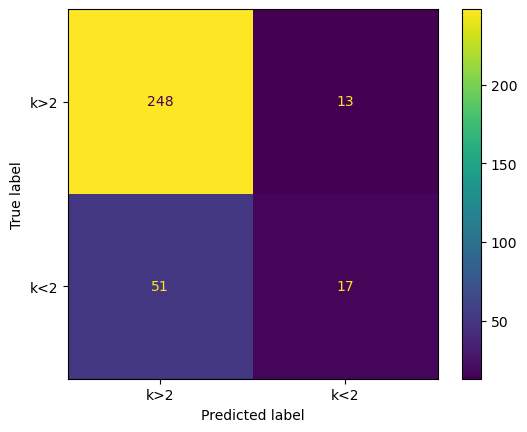

Accuracy:  0.805
Precision:  0.567
Recall:  0.25


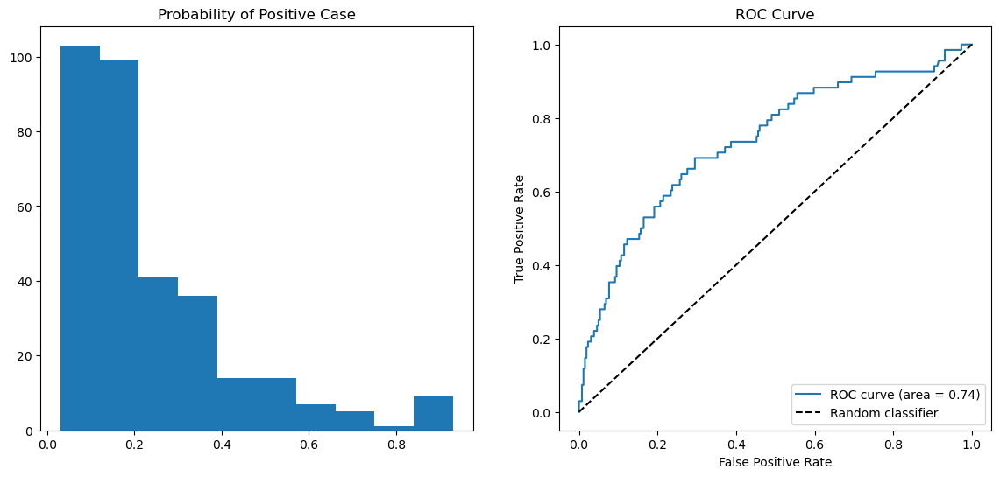

ATMEM2


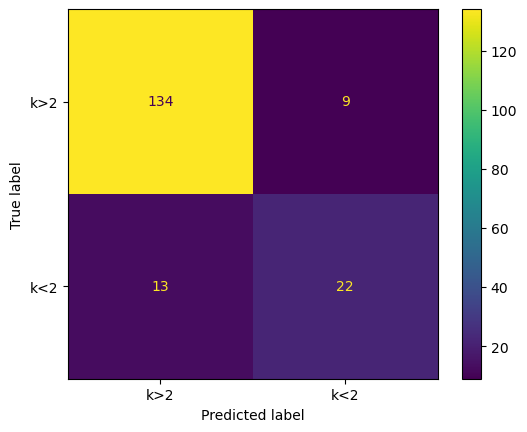

Accuracy:  0.876
Precision:  0.71
Recall:  0.629


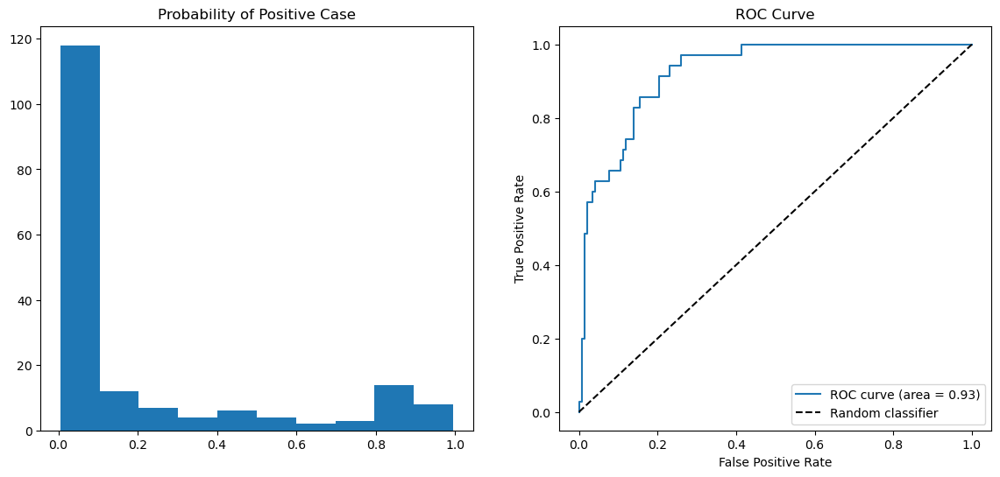

ATMEM2CP


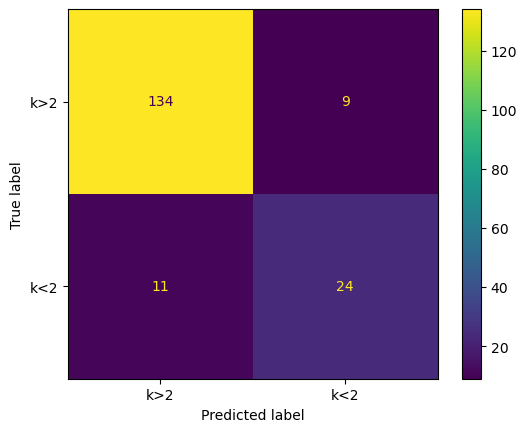

Accuracy:  0.888
Precision:  0.727
Recall:  0.686


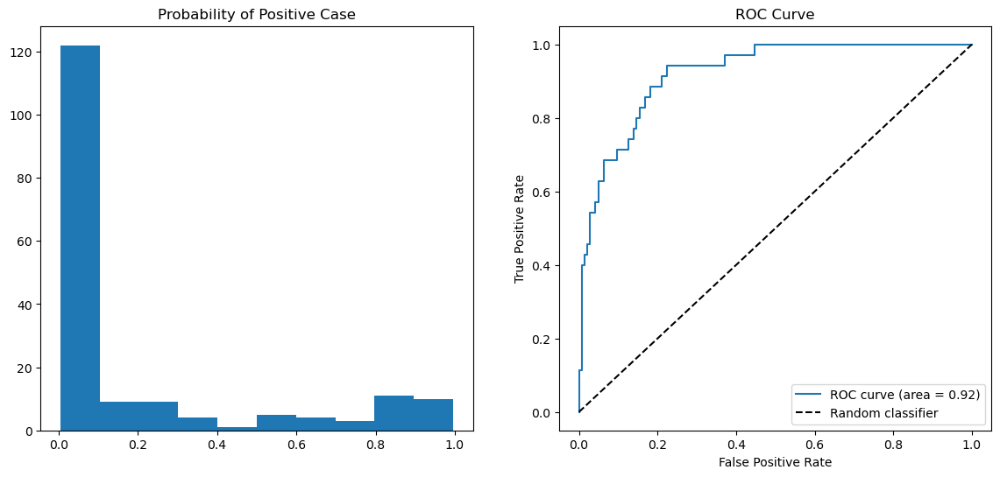

ATMEM2CPO


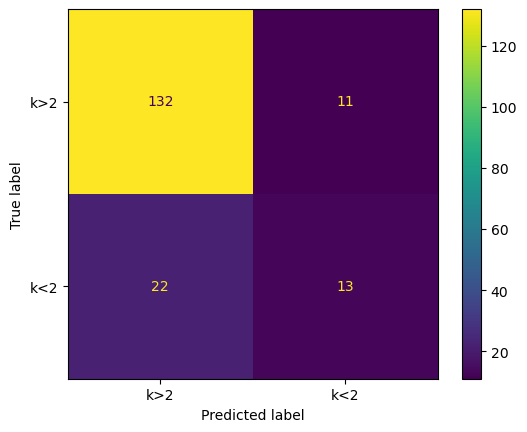

Accuracy:  0.815
Precision:  0.542
Recall:  0.371


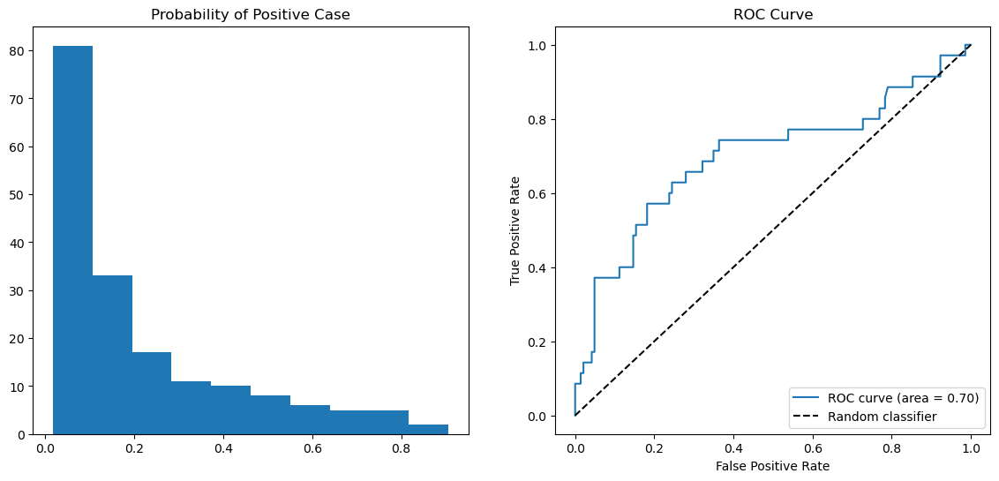

ATMERM


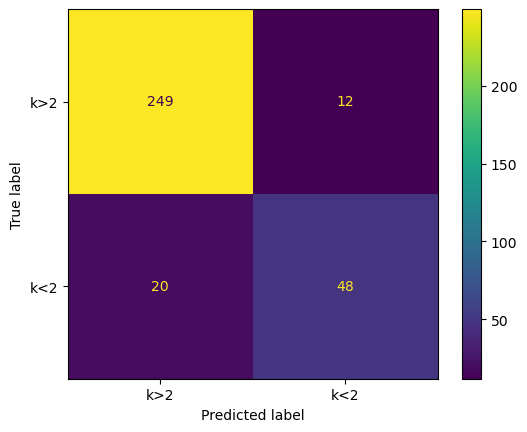

Accuracy:  0.903
Precision:  0.8
Recall:  0.706


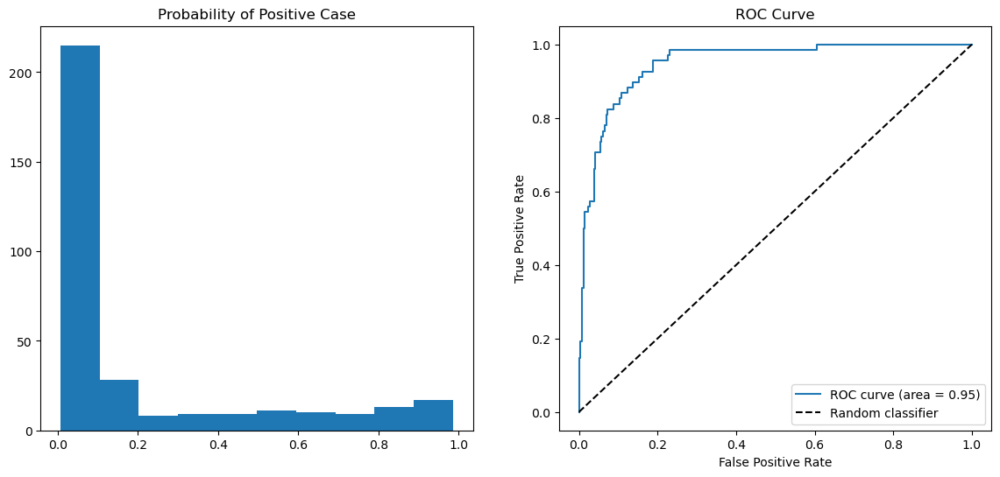

ATMERMCP


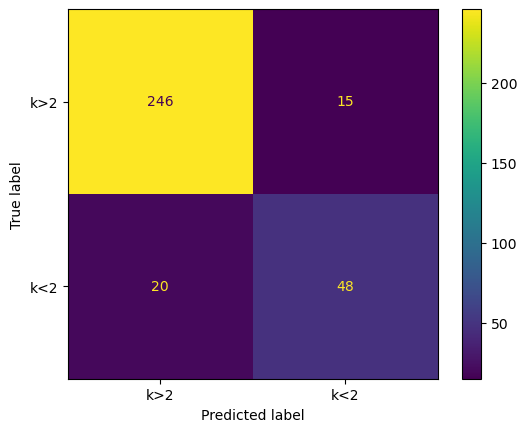

Accuracy:  0.894
Precision:  0.762
Recall:  0.706


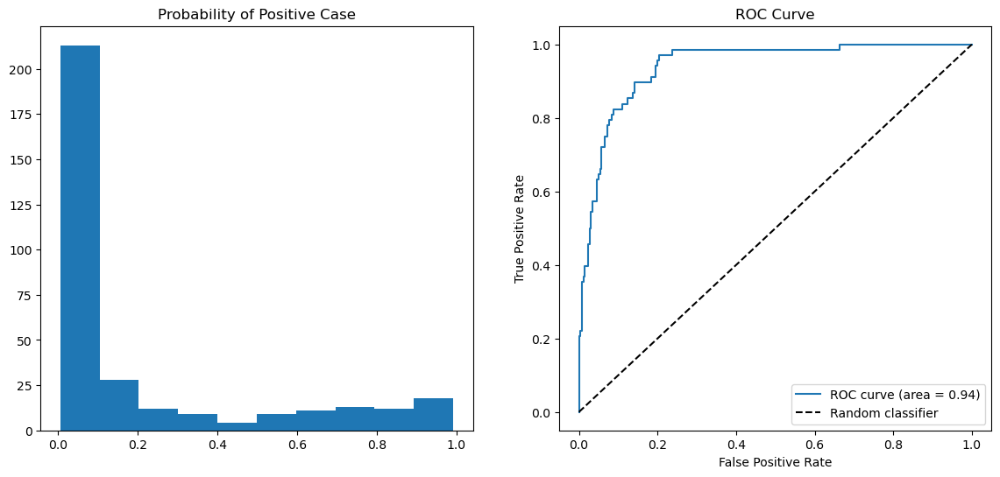

ATMERMCPO


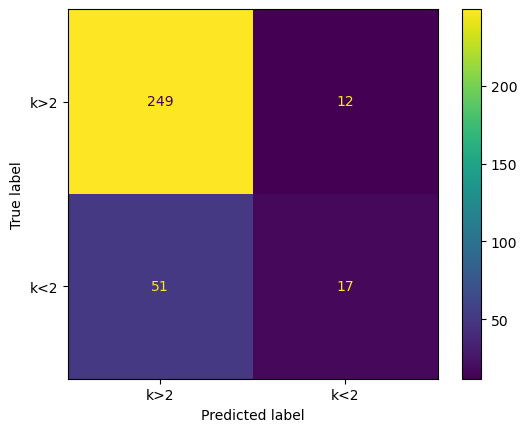

Accuracy:  0.809
Precision:  0.586
Recall:  0.25


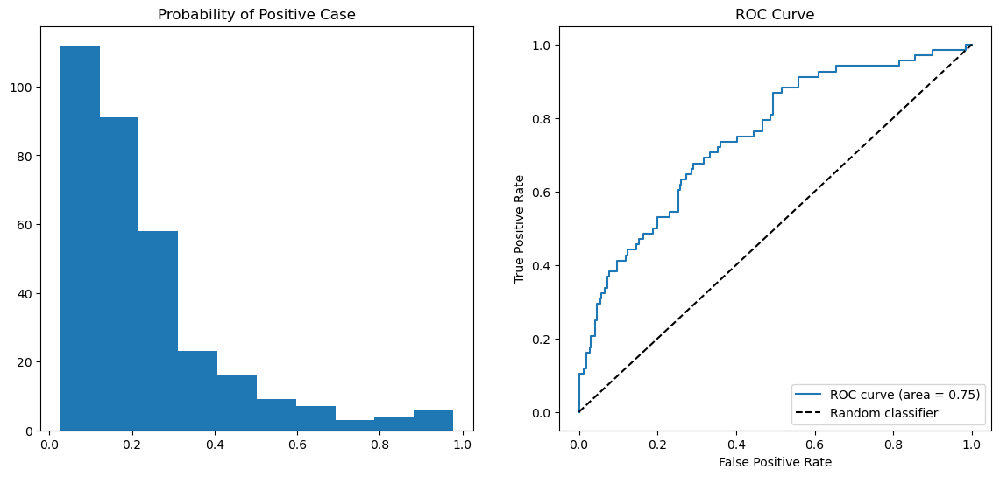

ATMERM2


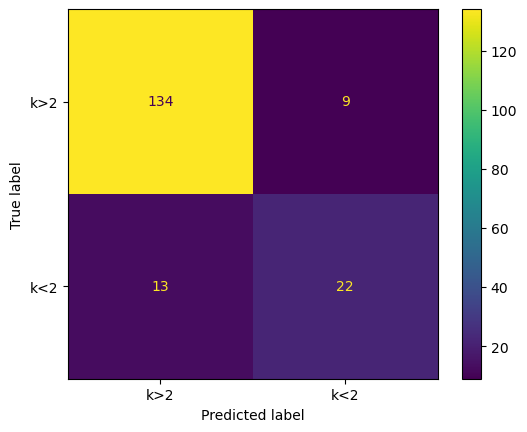

Accuracy:  0.876
Precision:  0.71
Recall:  0.629


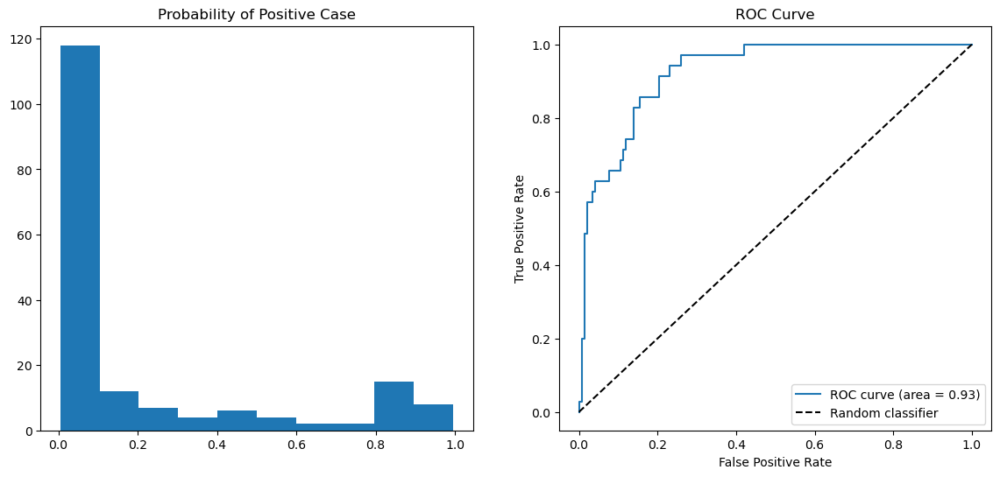

ATMERM2CP


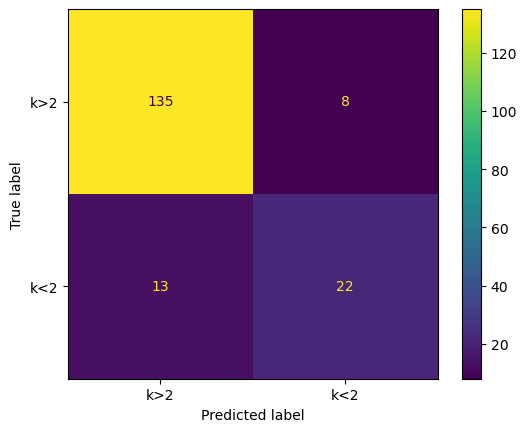

Accuracy:  0.882
Precision:  0.733
Recall:  0.629


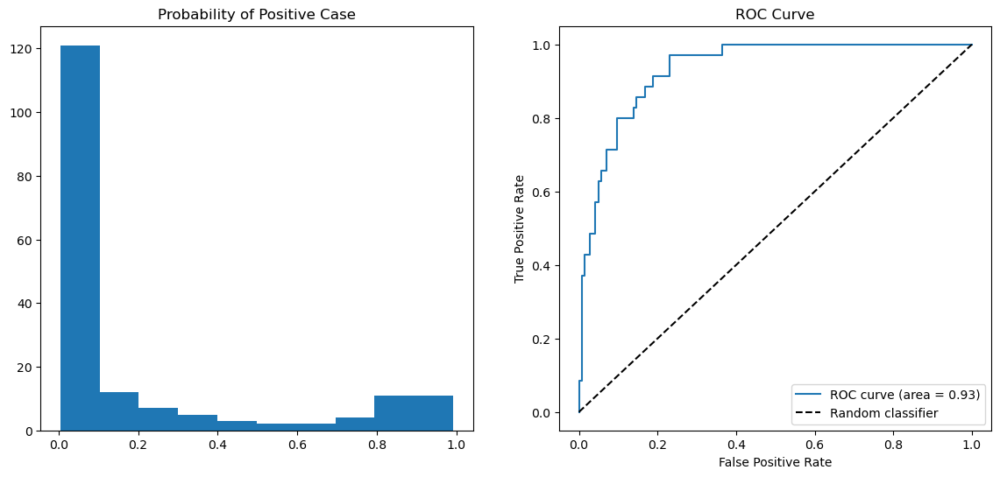

ATMERM2CPO


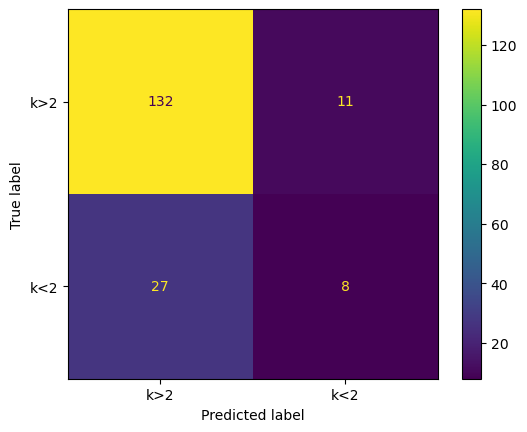

Accuracy:  0.787
Precision:  0.421
Recall:  0.229


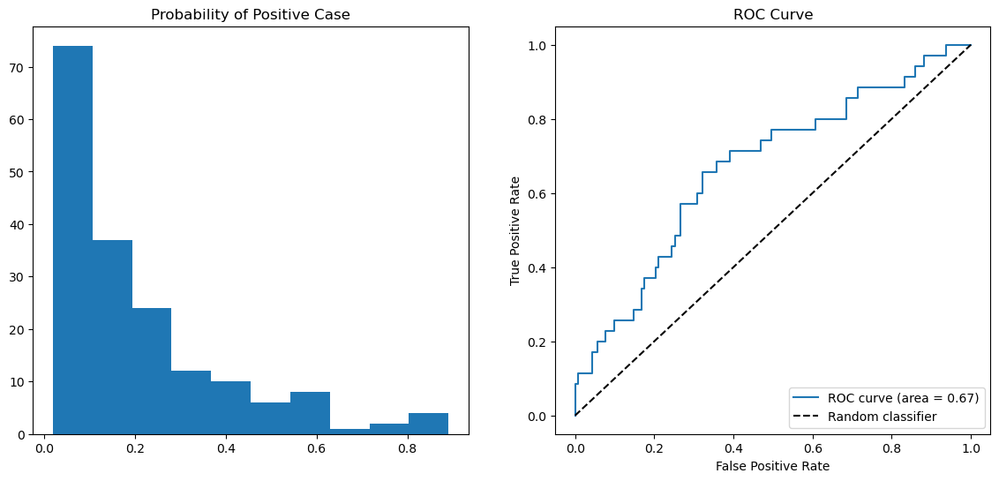

ATMEI


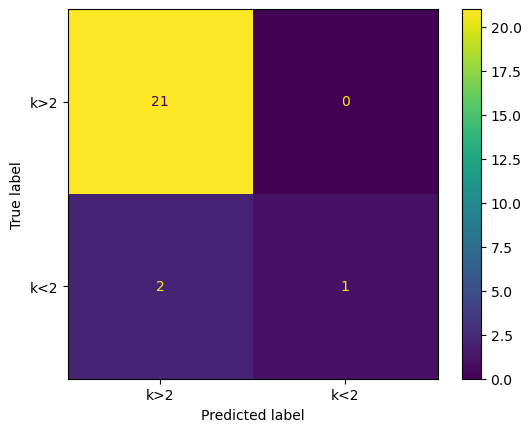

Accuracy:  0.917
Precision:  1.0
Recall:  0.333


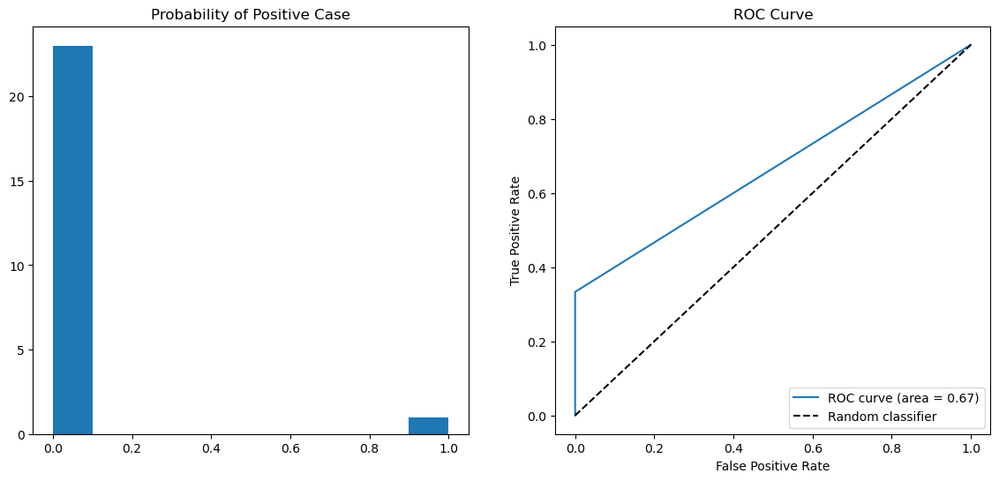

ATMEICP


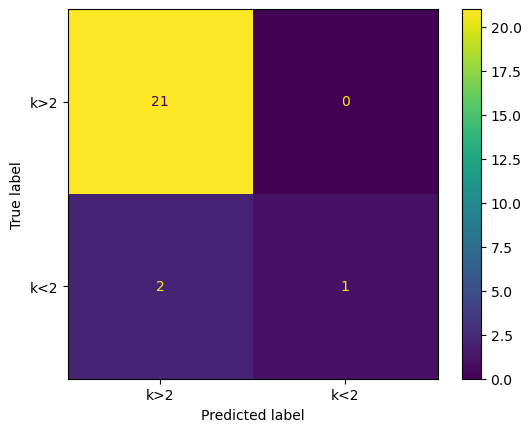

Accuracy:  0.917
Precision:  1.0
Recall:  0.333


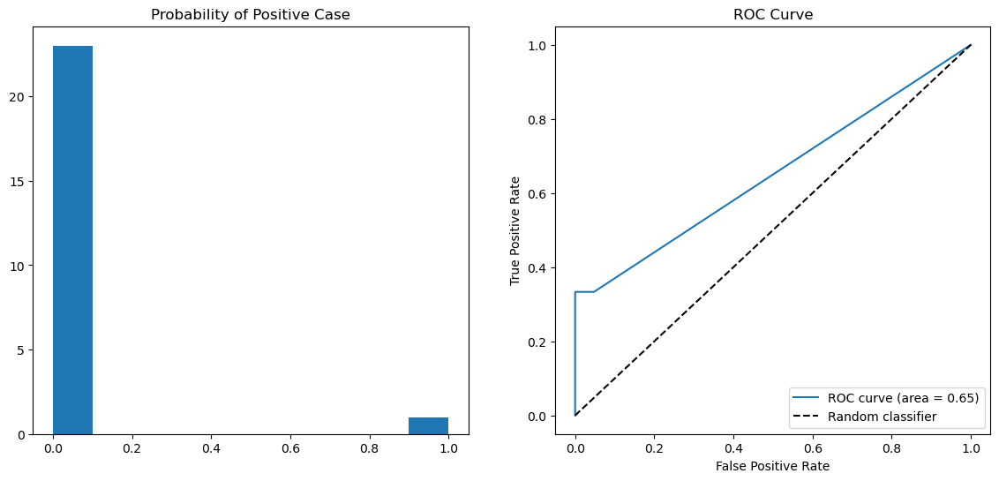

ATMEICPO


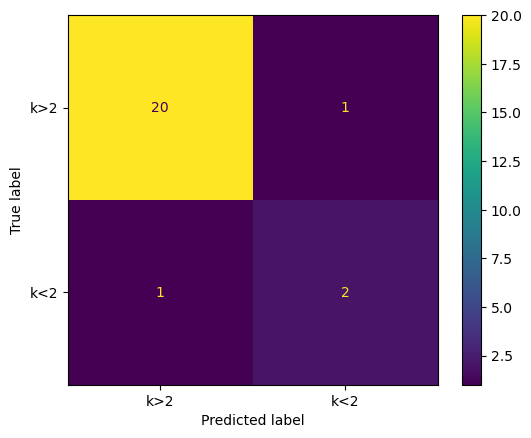

Accuracy:  0.917
Precision:  0.667
Recall:  0.667


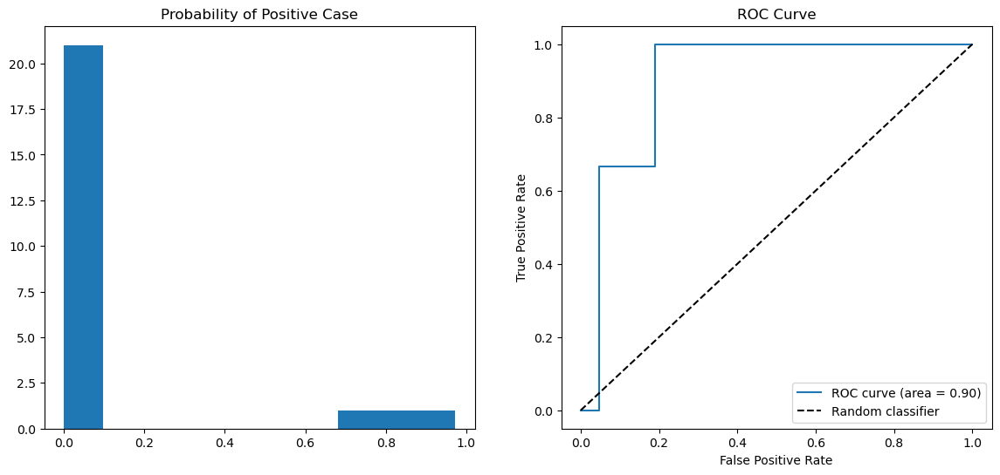

ATMEI2


ValueError: The number of FixedLocator locations (1), usually from a call to set_ticks, does not match the number of labels (2).

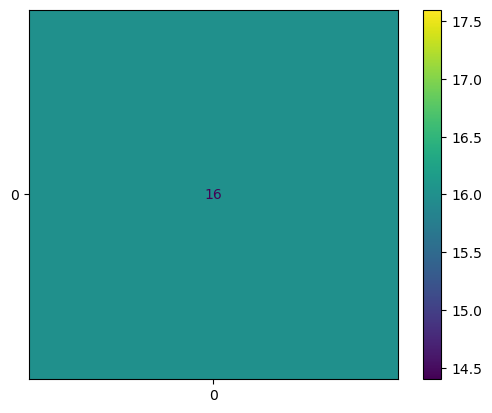

In [326]:
for i in full_list_ML[-12:]:
    for j in ['','CP','CPO']:
        print(i+j)
        # ref.test_rf_modelbinary_boost(kpred['rfcmodel'+i+j],kpred['Xtest'+i+j],kpred['ytest'+i],[f"k>{threshold}", f"k<{threshold}"]])
        # ref.test_rf_modelbinary_boost(kpred['dtcmodel'+i+j],kpred['Xtest'+i+j],kpred['ytest'+i],[f"k>{threshold}", f"k<{threshold}"]])
        # ref.test_rf_modelbinary_boost(kpred['hgbcmodel'+i+j],kpred['Xtest'+i+j],kpred['ytest'+i],[f"k>{threshold}", f"k<{threshold}"]])
        ref.test_rf_modelbinary_boost(kpred['gbcmodel'+i+j],kpred['Xtest'+i+j],kpred['ytest'+i],[f"k>{threshold}", f"k<{threshold}"])
        # ref.roc(kpred['rfcmodel'+i+j],kpred['Xtest'+i+j],kpred['ytest'+i])
        #ref.roc(kpred['dtcmodel'+i+j],kpred['Xtest'+i+j],kpred['ytest'+i])
        # ref.roc(kpred['hgbcmodel'+i+j],kpred['Xtest'+i+j],kpred['ytest'+i])
        ref.roc(kpred['gbcmodel'+i+j],kpred['Xtest'+i+j],kpred['ytest'+i])

In [98]:
# rocvalues={}
# rocvalues['X']={}
# rocvalues['XCP']={}
# rocvalues['XCPO']={}
# for i in ['','CP','CPO']:
#     predprob=kpred['gbcmodel'+'ATM'+i].predict_proba(kpred['Xtest'+'ATM'+i])[:,1]
#     fpr, tpr, thresholds = roc_curve(kpred['ytest'+'ATM'], predprob, pos_label=1)
#     rocvalues['X'+i]['tpr']=fpr
#     rocvalues['X'+i]['fpr']=tpr
#     rocvalues['X'+i]['roc_auc'] = roc_auc_score(kpred['ytest'+'ATM'], predprob)
# fig, (ax1,ax2) = plt.subplots(1,2,figsize=(14,6))
# ax1.hist(predprob)
# ax2.plot(rocvalues['X']['tpr'], rocvalues['X']['tpr'], label='Composition Only (area = %0.2f)' % rocvalues['X']['roc_auc'])
# ax2.plot(rocvalues['XCP']['tpr'], rocvalues['XCP']['tpr'], label='Composition & ML-CP (area = %0.2f)' % rocvalues['XCP']['roc_auc'])
# ax2.plot(rocvalues['XCPO']['tpr'], rocvalues['XCPO']['tpr'], label='ML-CP Only (area = %0.2f)' % rocvalues['XCPO']['roc_auc'])
# ax2.plot([0, 1], [0, 1], 'k--', label='Random classifier') 
# ax2.set_xlabel('False Positive Rate') 
# ax2.set_ylabel('True Positive Rate') 
# ax2.set_title('ROC Curve by Model') 
# ax2.legend(loc="lower right") 
# plt.show()

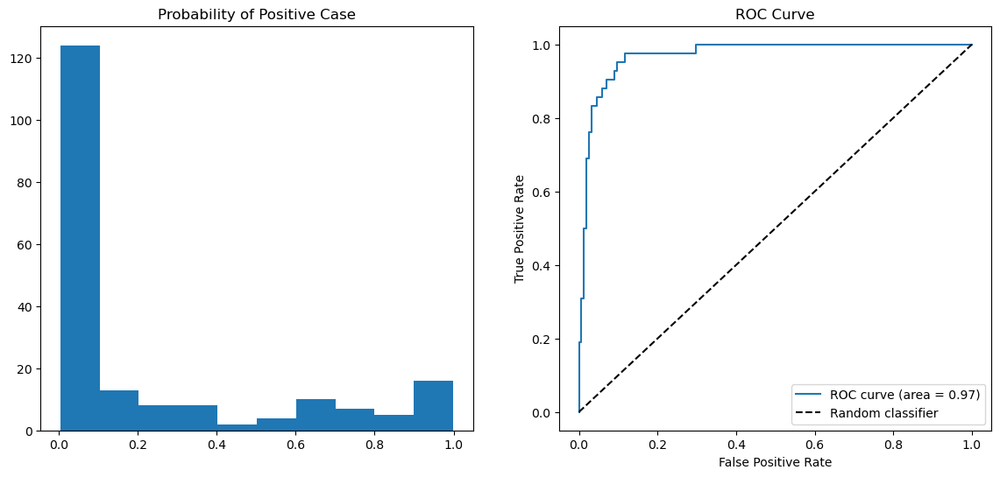

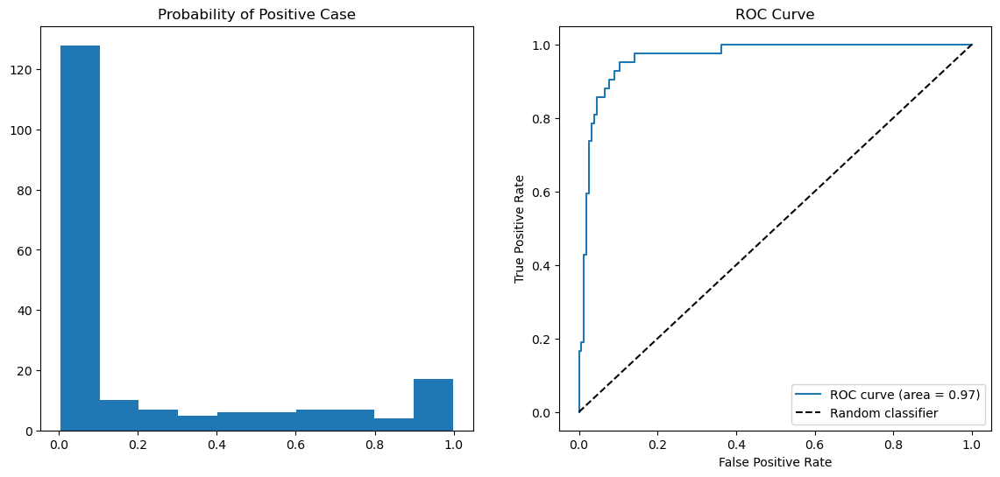

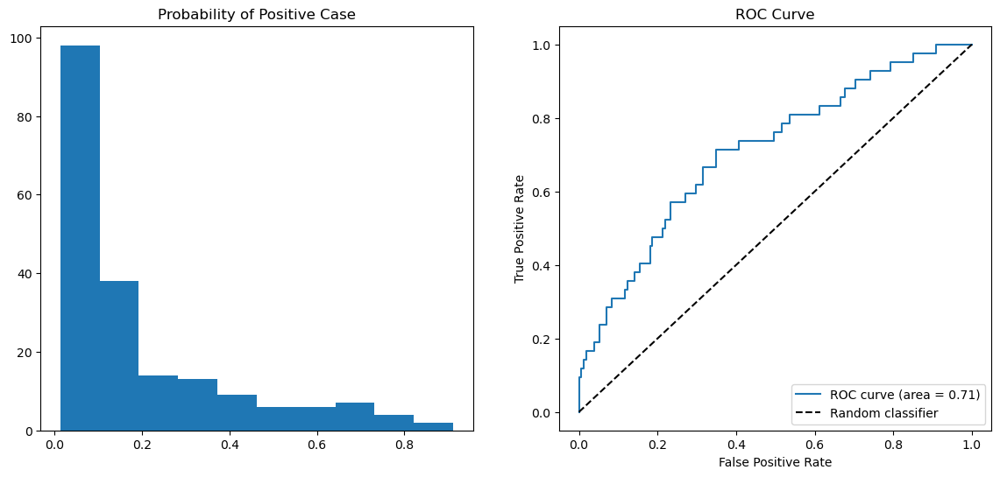

In [107]:
for i in ['ATME2']:
    for j in ['','CP','CPO']:
        kpred[j+'tpr'],kpred[j+'fpr']=ref.rochelp(kpred['gbcmodel'+i+j],kpred['Xtest'+i+j],kpred['ytest'+i])

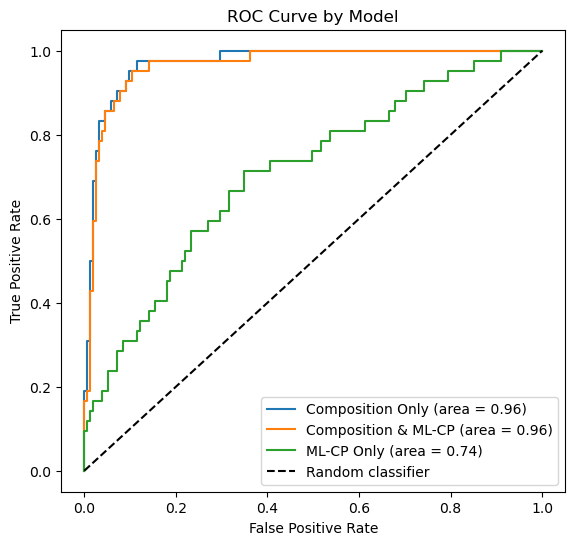

In [108]:
plt.figure(figsize=(6.5, 6))
plt.plot(kpred['tpr'],kpred['fpr'], label='Composition Only (area = 0.96)')
plt.plot(kpred['CPtpr'],kpred['CPfpr'], label='Composition & ML-CP (area = 0.96)')
plt.plot(kpred['CPOtpr'],kpred['CPOfpr'], label='ML-CP Only (area = 0.74)')
plt.plot([0, 1], [0, 1], 'k--', label='Random classifier') 
plt.xlabel('False Positive Rate') 
plt.ylabel('True Positive Rate') 
plt.title('ROC Curve by Model') 
plt.legend(loc="lower right") 

plt.show()

In [106]:
rocvalues['X']['fpr']

array([0.        , 0.00729927, 0.3649635 , 0.3649635 , 0.39416058,
       0.40875912, 0.69343066, 0.69343066, 0.7080292 , 0.7080292 ,
       0.71532847, 0.71532847, 0.72992701, 0.72992701, 0.75912409,
       0.75912409, 0.77372263, 0.77372263, 0.7810219 , 0.7810219 ,
       0.81021898, 0.81021898, 0.83211679, 0.83941606, 0.83941606,
       0.84671533, 0.84671533, 0.86131387, 0.86131387, 0.86861314,
       0.86861314, 0.87591241, 0.87591241, 0.88321168, 0.88321168,
       0.89051095, 0.89051095, 0.89781022, 0.89781022, 0.90510949,
       0.90510949, 0.91240876, 0.91240876, 0.91970803, 0.91970803,
       0.9270073 , 0.9270073 , 0.93430657, 0.93430657, 0.94160584,
       0.94160584, 0.94890511, 0.94890511, 0.95620438, 0.95620438,
       0.96350365, 0.96350365, 0.97080292, 0.97080292, 0.97810219,
       0.97810219, 0.98540146, 0.98540146, 0.99270073, 0.99270073,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.     

In [96]:
rocvalues['X']['tpr']

array([0.        , 0.        , 0.        , 0.00259067, 0.00259067,
       0.00259067, 0.00259067, 0.00777202, 0.00777202, 0.01036269,
       0.01036269, 0.01295337, 0.01295337, 0.01813472, 0.01813472,
       0.02072539, 0.02072539, 0.02331606, 0.02331606, 0.02590674,
       0.02590674, 0.02849741, 0.02849741, 0.03108808, 0.0388601 ,
       0.0388601 , 0.04404145, 0.04404145, 0.04663212, 0.04663212,
       0.0492228 , 0.0492228 , 0.05181347, 0.05181347, 0.07253886,
       0.07253886, 0.09067358, 0.09067358, 0.10880829, 0.10880829,
       0.13471503, 0.13471503, 0.14766839, 0.14766839, 0.15803109,
       0.15803109, 0.19430052, 0.19430052, 0.21502591, 0.21502591,
       0.24093264, 0.24093264, 0.27202073, 0.27202073, 0.31865285,
       0.31865285, 0.34715026, 0.34715026, 0.36010363, 0.36010363,
       0.39637306, 0.39896373, 0.52072539, 0.52072539, 0.64766839,
       0.64766839, 0.73834197, 0.74352332, 0.87305699, 0.87823834,
       0.93523316, 0.94041451, 0.95595855, 0.9611399 , 0.96891

In [ ]:
# #saving data to local file
# aflowthermal={}
# aflowthermal['compound']=compounds #numbers add to comp
# aflowthermal['real_spacegroup']=real_spacegroup
# aflowthermal['compoundtype']=AFLOWtherm['compound']+'_'+AFLOWtherm['real_spacegroup']
# aflowthermal['ICSD']=ICSD
# aflowthermal['kappa']=kappa
# aflowthermal['bulk_modulus']=bulk_modulus
# aflowthermal['debye']=debye
# aflowthermal['gruneisen']=gruneisen
# aflowthermal['enthalpy']=enthalpy_atom
# aflowthermal['energy']=energy
# aflowthermal['speed_sound']=speed_sound
# aflowthermal['positions']=positions #comp
# aflowthermal['prototype']=prototype
# aflowthermal['spacegroup']=spacegroup
# aflowthermal['Pearson']=Pearson
# aflowthermal['geometry']=geometry #6
# aflowthermal['real_geometry']=real_geometry #6
# aflowthermal['species']=species #elem
# aflowthermal['nspecies']=nspecies #elem
# aflowthermal['Wletters']=Wletters #elem
# aflowthermal['real_Wletters']=real_Wletters #elem?
# aflowthermal['Wmultiplicities']=Wmultiplicities #elem
# aflowthermal['real_Wmultiplicities']=real_Wmultiplicities #elem?
# aflowthermal['Wsite_symmetries']=Wsite_symmetries #elem
# aflowthermal['lenpos']=[len(a) for a in positions] 
# aflowthermal['summult']= summult
# aflowthermal['real_summult']= real_summult
# aflowthermal['real_multiplier']= AFLOWtherm['real_summult']/AFLOWtherm['lenpos']
# aflowthermal['multiplier']= AFLOWtherm['summult']/AFLOWtherm['lenpos']
# aflowthermal['temperature']=temperature
# aflowthermal['auid']=auids
# aflowthermal['aurl']=aurls
# aflowthermal['sites']= sites
# aflowthermal['real_sites']= real_sites

# np.save('aflowdata5578.npy', aflowthermal)

In [155]:
AFLOWthermmlcp.to_pickle('AFLOWthermmlcp.pkl')
AFLOWtherm.to_pickle('AFLOWtherm.pkl')
AFLOWthermmlcprelax.to_pickle('AFLOWthermmlcprelax.pkl')
allatoms.to_pickle('allatoms.pkl')
allatomsrelax.to_pickle('allatomsrelax.pkl')

In [4]:
AFLOWthermmlcp = pd.read_pickle('AFLOWthermmlcp.pkl')
AFLOWtherm = pd.read_pickle('AFLOWtherm.pkl')
AFLOWthermmlcprelax = pd.read_pickle('AFLOWthermmlcprelax.pkl')
allatoms = pd.read_pickle('allatoms.pkl')
allatomsrelax = pd.read_pickle('allatomsrelax.pkl')

In [ ]:
#5653: https://aflowlib.duke.edu/search/API/?agl_thermal_conductivity_300K,paging(-227,25),format(json)